In [1]:
import pennylane as qml
from pennylane import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, mean_squared_error, precision_score, recall_score, f1_score
import torch
import torch.nn as nn
from tqdm import tqdm
import pandas as pd
import time
torch.manual_seed(42)
np.random.seed(42)

In [2]:

# Configuration
n_qubits = 2
input_dim = 2
res = 30  # resolution of x1, x2 grid
X_vals = np.linspace(0, 2 * np.pi, res)
X1, X2 = np.meshgrid(X_vals, X_vals)
inputs = np.stack([X1.ravel(), X2.ravel()], axis=1)


In [3]:

# Encoding
def encoding_layer(x):
    qml.RX(x[0], wires=0)
    qml.RX(x[1], wires=1)
    qml.RY(x[0]*x[1], wires=0)
    qml.RY(x[1]*x[0], wires=1)
    
# Variational block
def variational_block(weights):
    for i in range(n_qubits):
        qml.RZ(weights[i, 0], wires=i)
        qml.RY(weights[i, 1], wires=i)
        qml.RZ(weights[i, 2], wires=i)
    qml.CNOT(wires=[0, 1])
    qml.CNOT(wires=[1, 0])

# Create circuit
def create_qnode(depth, weights, dev):
    @qml.qnode(dev)
    def circuit(x):
        encoding_layer(x)
        for d in range(depth):
            variational_block(weights[d])
        return qml.expval(qml.PauliZ(0))
    return circuit


In [4]:

# Label from circuit
def generate_labels(circuit, X):
    return np.array([1 if circuit(x) > 0 else 0 for x in X])


In [5]:

# Quantum classifier as TorchLayer
def get_torch_model(depth, dev):
    weight_shapes = {"weights": (depth, n_qubits, 3)}

    @qml.qnode(dev, interface="torch")
    def circuit(inputs, weights):
        encoding_layer(inputs)
        for d in range(depth):
            for i in range(n_qubits):
                qml.RZ(weights[d, i, 0], wires=i)
                qml.RY(weights[d, i, 1], wires=i)
                qml.RZ(weights[d, i, 2], wires=i)
            qml.CNOT(wires=[0, 1])
            qml.CNOT(wires=[1, 0])
        return qml.expval(qml.PauliZ(0))

    return qml.qnn.TorchLayer(circuit, weight_shapes)


In [6]:

# Training loop
def train_model(model, X_train, y_train, epochs=100, lr=0.1):
    opt = torch.optim.Adam(model.parameters(), lr=lr)
    loss_fn = nn.BCEWithLogitsLoss()
    for _ in range(epochs):
        opt.zero_grad()
        outputs = torch.stack([model(x) for x in X_train])
        loss = loss_fn(outputs, y_train.squeeze())
        loss.backward()
        opt.step()
    return model


In [7]:
def plot_generator_A(generator_labels, title, X=None, train_idx=None):
    plt.figure(figsize=(6, 5))
    Z = generator_labels.reshape(res, res)
    plt.contourf(X1, X2, Z, levels=2, cmap='RdBu', alpha=0.4)
    plt.contour(X1, X2, Z, levels=2, colors='black', linewidths=0.5)

    # Optional: overlay generated class markers on the full grid
    X_flat = X1.ravel(), X2.ravel()
    labels_flat = generator_labels.ravel()
    for cls, marker in zip([0, 1], ['o', 's']):
        idx = labels_flat == cls
        plt.scatter(X_flat[0][idx], X_flat[1][idx], marker=marker, color='black', s=5, alpha=0.3, label=f'Class {cls}')

    # Optional: training points overlay
    if X is not None and train_idx is not None:
        X_train = X[train_idx]
        y_train = generator_labels[train_idx]
        for i, pt in enumerate(X_train):
            marker = 'o' if y_train[i] == 0 else 's'
            plt.scatter(pt[0], pt[1], marker=marker, color='yellow', edgecolor='black', s=40, label="Train point" if i == 0 else None)

    plt.title(title)
    plt.xlabel(r'$x_1$')
    plt.ylabel(r'$x_2$')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [8]:

# Plot contours
def plot_results(generator_labels, predicted_labels, title, X, train_idx=None):
    plt.figure(figsize=(6, 5))
    Z = predicted_labels.reshape(res, res)
    plt.contourf(X1, X2, Z, levels=2, alpha=0.3, cmap='RdBu')
    plt.contour(X1, X2, generator_labels.reshape(res, res), levels=2, colors='black', linewidths=0.5)

    # Plot training points
    if train_idx is not None:
        X_train_pts = X[train_idx]
        y_true = generator_labels[train_idx]
        y_pred = predicted_labels[train_idx]

        for i, pt in enumerate(X_train_pts):
            marker = 'o' if y_true[i] == 0 else 's'
            color = 'green' if y_pred[i] == y_true[i] else 'red'
            label = None

            # Add legend once
            if i == 0 and y_true[i] == 0:
                label = 'Class 0 (circle)'
            elif i == 0 and y_true[i] == 1:
                label = 'Class 1 (square)'

            plt.scatter(pt[0], pt[1], color=color, marker=marker, s=40, edgecolor='black', label=label)

        # Ensure both classes appear in legend even if only one example is shown
        from matplotlib.lines import Line2D
        legend_elements = [
            Line2D([0], [0], marker='o', color='w', label='Class 0 (circle)', markerfacecolor='gray', markeredgecolor='black', markersize=8),
            Line2D([0], [0], marker='s', color='w', label='Class 1 (square)', markerfacecolor='gray', markeredgecolor='black', markersize=8),
            Line2D([0], [0], marker='o', color='w', label='Correct (green)', markerfacecolor='green', markersize=8),
            Line2D([0], [0], marker='o', color='w', label='Wrong (red)', markerfacecolor='red', markersize=8)
        ]
        plt.legend(handles=legend_elements)

    plt.title(title)
    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.tight_layout()
    plt.show()



# 100 Epochs

In [9]:

# Main experiment
depths = [1, 2, 3, 4] # depths of reupload
train_idx = np.random.choice(len(inputs), size=300, replace=False)
X_train = torch.tensor(inputs[train_idx], dtype=torch.float32)
test_idx = np.setdiff1d(np.arange(len(inputs)), train_idx)
X_test = torch.tensor(inputs[test_idx], dtype=torch.float32)

results = []


  0%|          | 0/4 [00:00<?, ?it/s]

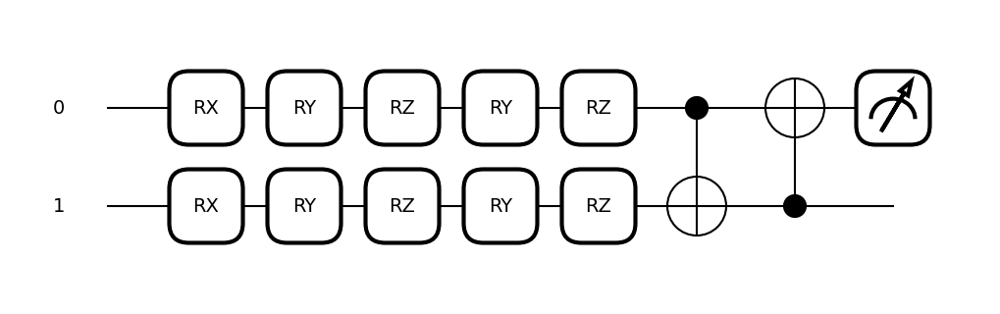

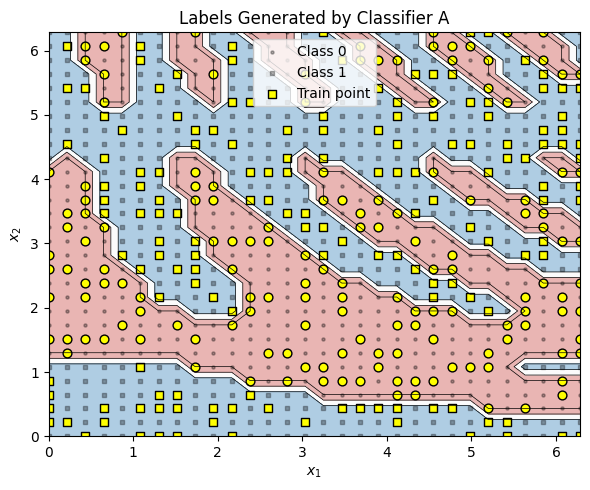

Training B(depth=1) on data from A(depth=1)
Total Accuracy: 0.92
Train Accuracy: 0.9233333333333333
Test Accuracy: 0.9183333333333333
Test Precision: 0.9272727272727272
Test Recall: 0.9244712990936556
Test F1: 0.9258698940998487
Time taken: 145.92386627197266


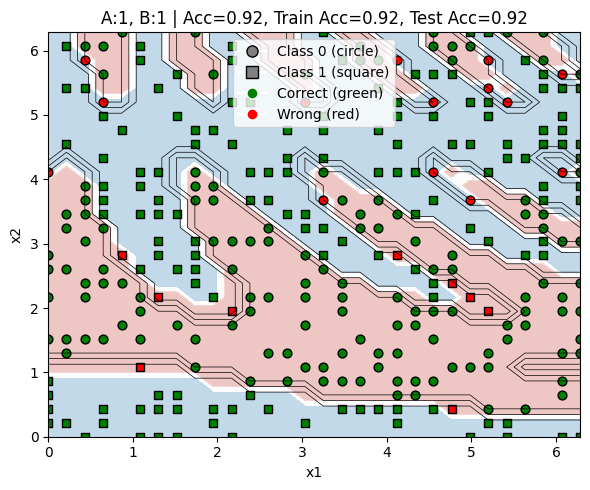

Training B(depth=2) on data from A(depth=1)
Total Accuracy: 0.5511111111111111
Train Accuracy: 0.5766666666666667
Test Accuracy: 0.5383333333333333
Test Precision: 0.5918367346938775
Test Recall: 0.525679758308157
Test F1: 0.5568000000000001
Time taken: 286.7666096687317


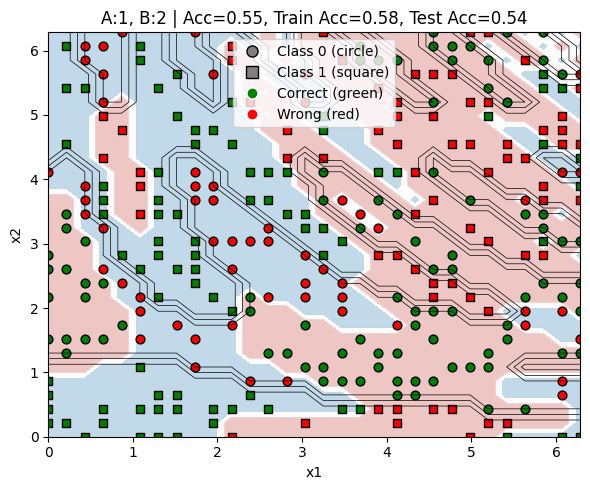

Training B(depth=3) on data from A(depth=1)
Total Accuracy: 0.9155555555555556
Train Accuracy: 0.91
Test Accuracy: 0.9183333333333333
Test Precision: 0.9246987951807228
Test Recall: 0.9274924471299094
Test F1: 0.9260935143288084
Time taken: 421.6552014350891


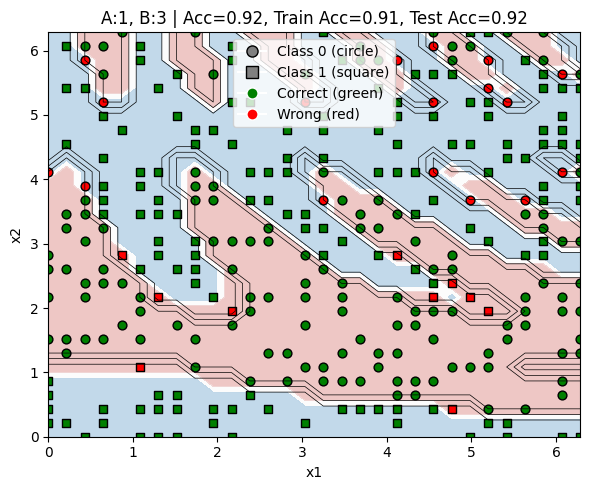

Training B(depth=4) on data from A(depth=1)
Total Accuracy: 0.9155555555555556
Train Accuracy: 0.91
Test Accuracy: 0.9183333333333333
Test Precision: 0.9246987951807228
Test Recall: 0.9274924471299094
Test F1: 0.9260935143288084
Time taken: 330.74798226356506


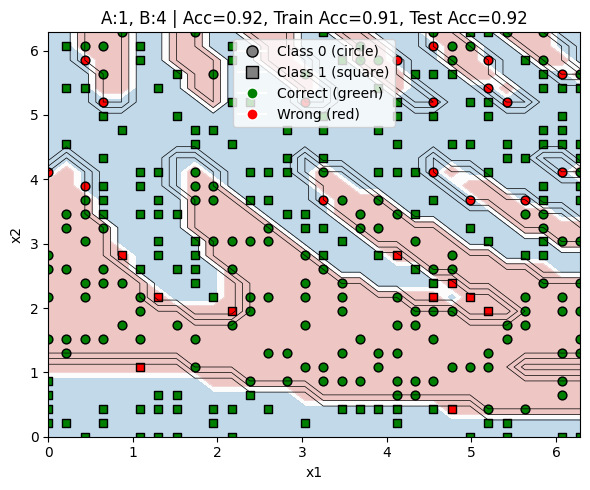

 25%|██▌       | 1/4 [19:52<59:38, 1192.69s/it]

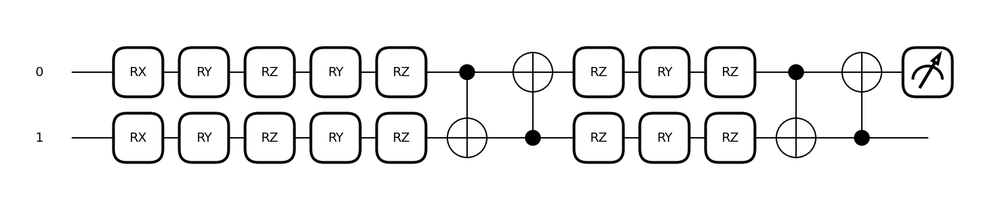

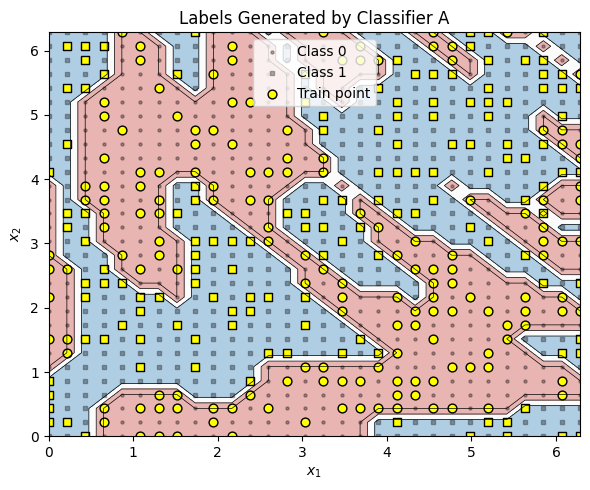

Training B(depth=1) on data from A(depth=2)
Total Accuracy: 0.5222222222222223
Train Accuracy: 0.5566666666666666
Test Accuracy: 0.505
Test Precision: 0.5170278637770898
Test Recall: 0.5422077922077922
Test F1: 0.5293185419968304
Time taken: 78.83744931221008


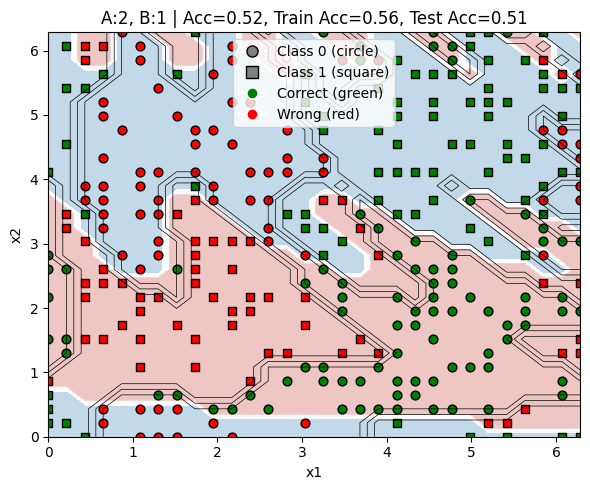

Training B(depth=2) on data from A(depth=2)
Total Accuracy: 0.91
Train Accuracy: 0.9033333333333333
Test Accuracy: 0.9133333333333333
Test Precision: 0.9129032258064517
Test Recall: 0.9188311688311688
Test F1: 0.9158576051779936
Time taken: 127.68430805206299


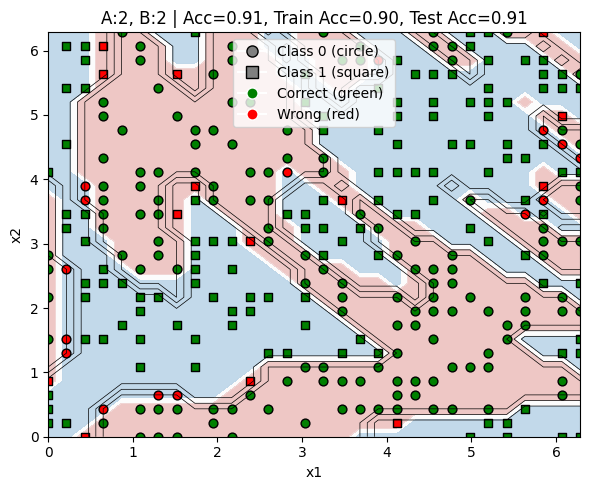

Training B(depth=3) on data from A(depth=2)
Total Accuracy: 0.9088888888888889
Train Accuracy: 0.8966666666666666
Test Accuracy: 0.915
Test Precision: 0.9079365079365079
Test Recall: 0.9285714285714286
Test F1: 0.9181380417335473
Time taken: 177.1338074207306


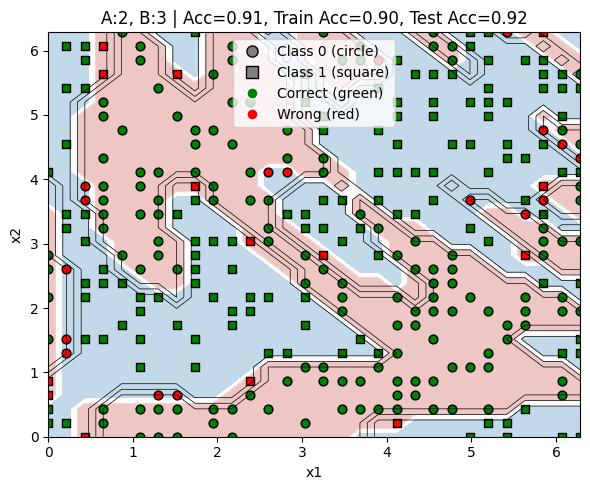

Training B(depth=4) on data from A(depth=2)
Total Accuracy: 0.91
Train Accuracy: 0.8966666666666666
Test Accuracy: 0.9166666666666666
Test Precision: 0.910828025477707
Test Recall: 0.9285714285714286
Test F1: 0.9196141479099679
Time taken: 315.3269853591919


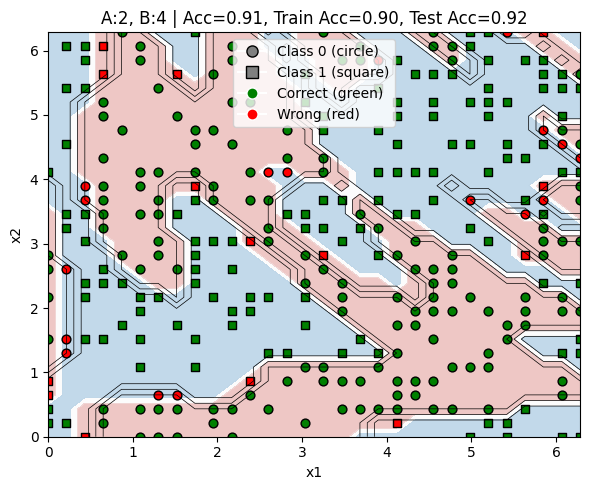

 50%|█████     | 2/4 [31:38<30:12, 906.24s/it] 

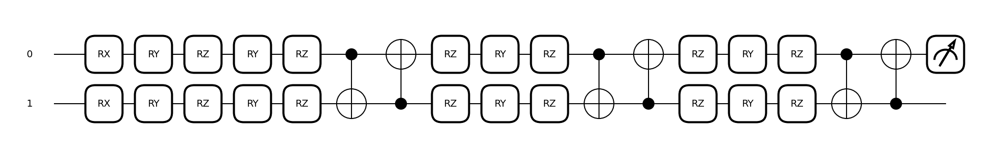

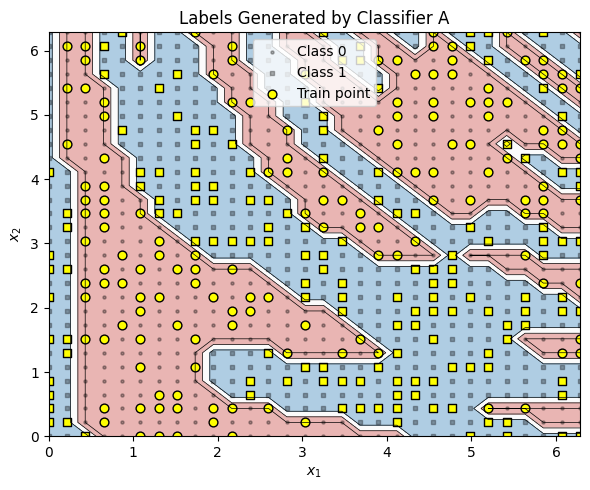

Training B(depth=1) on data from A(depth=3)
Total Accuracy: 0.5722222222222222
Train Accuracy: 0.5933333333333334
Test Accuracy: 0.5616666666666666
Test Precision: 0.5789473684210527
Test Recall: 0.5049180327868853
Test F1: 0.5394045534150614
Time taken: 185.09397530555725


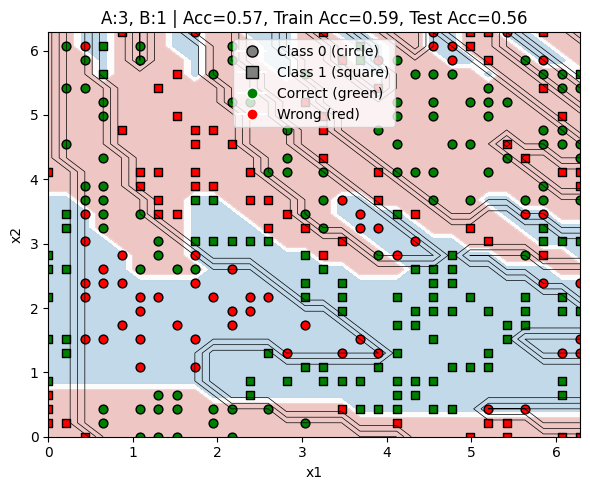

Training B(depth=2) on data from A(depth=3)
Total Accuracy: 0.9266666666666666
Train Accuracy: 0.9366666666666666
Test Accuracy: 0.9216666666666666
Test Precision: 0.9243421052631579
Test Recall: 0.921311475409836
Test F1: 0.9228243021346468
Time taken: 279.0245177745819


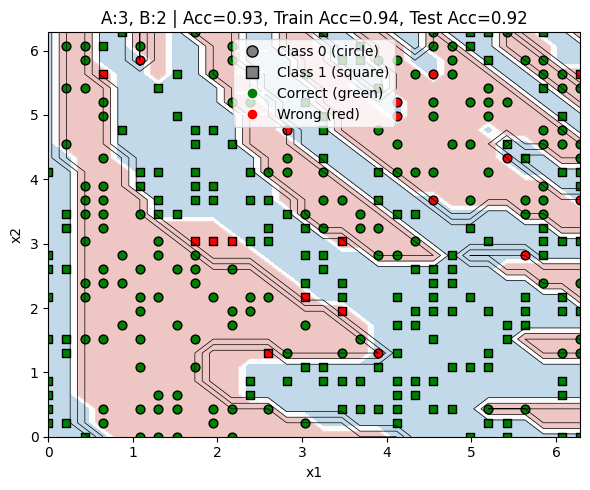

Training B(depth=3) on data from A(depth=3)
Total Accuracy: 0.9477777777777778
Train Accuracy: 0.9533333333333334
Test Accuracy: 0.945
Test Precision: 0.9473684210526315
Test Recall: 0.9442622950819672
Test F1: 0.9458128078817734
Time taken: 176.674400806427


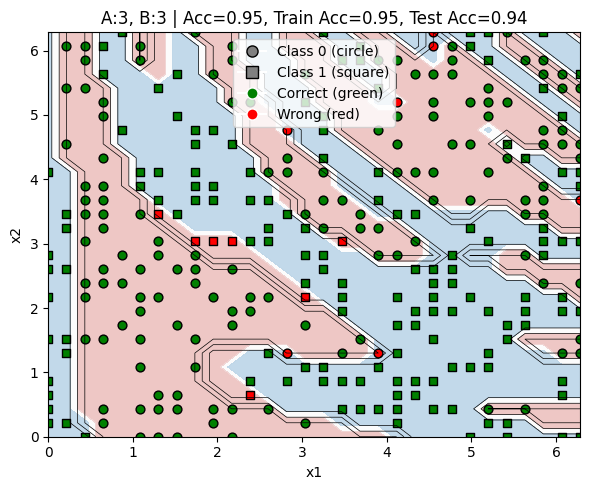

Training B(depth=4) on data from A(depth=3)
Total Accuracy: 0.9477777777777778
Train Accuracy: 0.9533333333333334
Test Accuracy: 0.945
Test Precision: 0.9473684210526315
Test Recall: 0.9442622950819672
Test F1: 0.9458128078817734
Time taken: 222.73069167137146


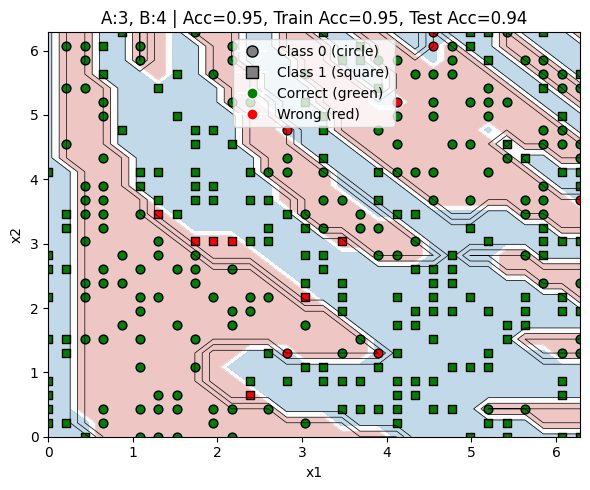

 75%|███████▌  | 3/4 [46:14<14:52, 892.25s/it]

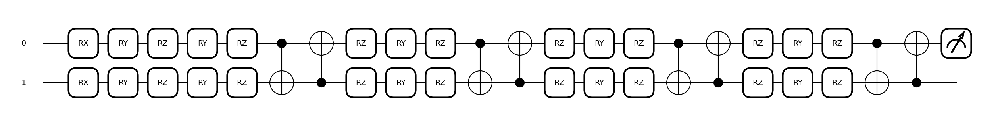

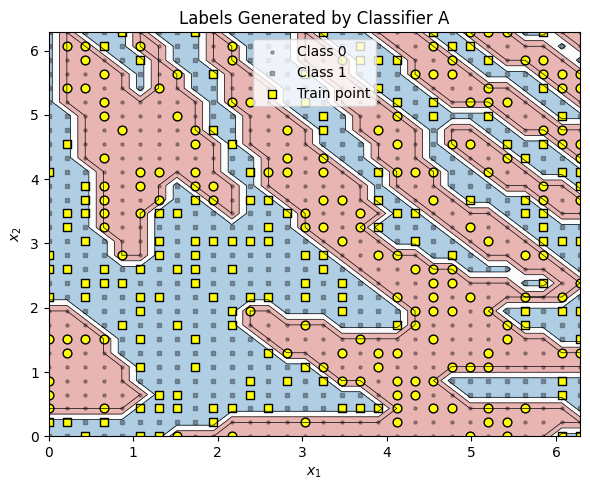

Training B(depth=1) on data from A(depth=4)
Total Accuracy: 0.6033333333333334
Train Accuracy: 0.5766666666666667
Test Accuracy: 0.6166666666666667
Test Precision: 0.6106870229007634
Test Recall: 0.5555555555555556
Test F1: 0.5818181818181819
Time taken: 81.71681690216064


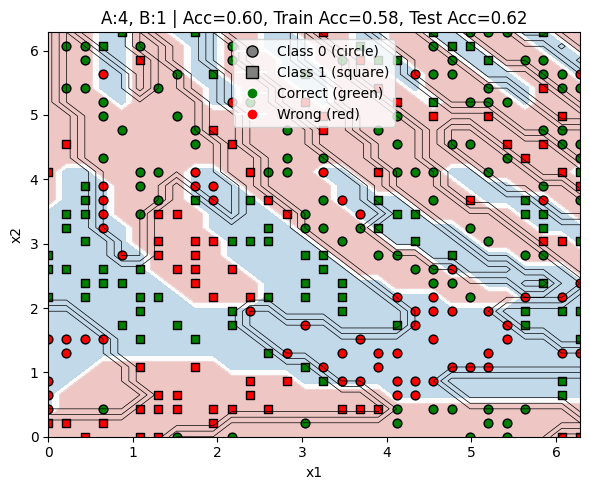

Training B(depth=2) on data from A(depth=4)
Total Accuracy: 0.7644444444444445
Train Accuracy: 0.8033333333333333
Test Accuracy: 0.745
Test Precision: 0.7076923076923077
Test Recall: 0.7986111111111112
Test F1: 0.7504078303425775
Time taken: 125.40136194229126


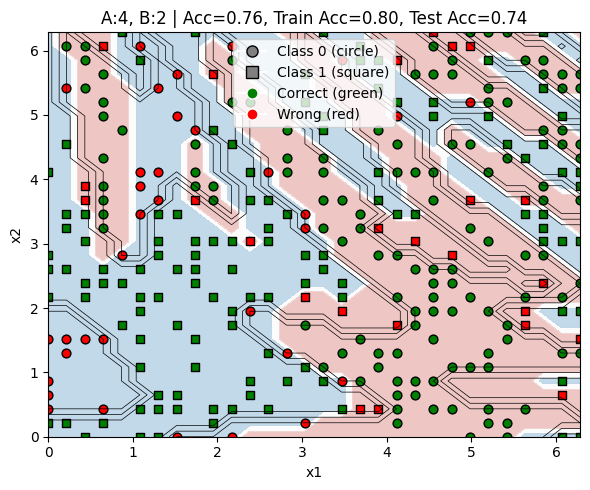

Training B(depth=3) on data from A(depth=4)
Total Accuracy: 0.8377777777777777
Train Accuracy: 0.88
Test Accuracy: 0.8166666666666667
Test Precision: 0.7763975155279503
Test Recall: 0.8680555555555556
Test F1: 0.819672131147541
Time taken: 173.5335693359375


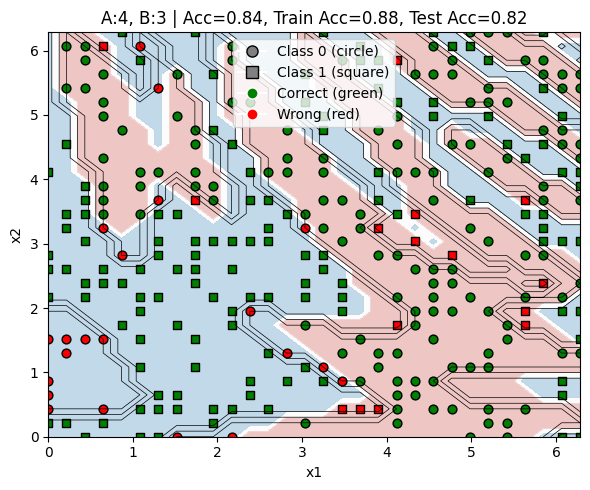

Training B(depth=4) on data from A(depth=4)
Total Accuracy: 0.8388888888888889
Train Accuracy: 0.8833333333333333
Test Accuracy: 0.8166666666666667
Test Precision: 0.7763975155279503
Test Recall: 0.8680555555555556
Test F1: 0.819672131147541
Time taken: 216.7292308807373


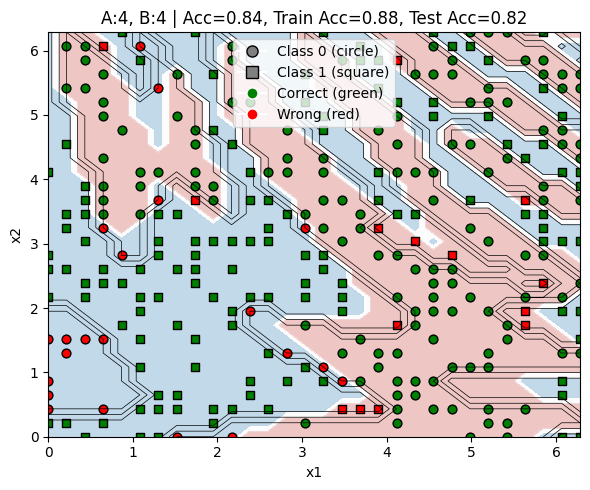

100%|██████████| 4/4 [56:19<00:00, 844.76s/it]


In [10]:

for depth_A in tqdm(depths):
    # Generate labels using fixed A
    devA = qml.device("default.qubit", wires=n_qubits)
    weights_A = np.random.uniform(0, 2*np.pi, size=(depth_A, n_qubits, 3))
    circuit_A = create_qnode(depth_A, weights_A, devA)
    labels_A = generate_labels(circuit_A, inputs)
    y_train = torch.tensor(labels_A[train_idx], dtype=torch.float32).unsqueeze(1)
    y_test = torch.tensor(labels_A[test_idx], dtype=torch.float32).unsqueeze(1)
    qml.drawer.draw_mpl(circuit_A)([0, 1]);
    plot_generator_A(labels_A, "Labels Generated by Classifier A", X=inputs, train_idx=train_idx)
    
    for depth_B in tqdm(depths):
        print(f"Training B(depth={depth_B}) on data from A(depth={depth_A})")
        devB = qml.device("default.qubit", wires=n_qubits)
        model_B = get_torch_model(depth_B, devB)
        start_time = time.time()
        trained_model = train_model(model_B, X_train, y_train,epochs = 100)

        # Evaluate model
        with torch.no_grad():
            preds = torch.stack([trained_model(x) for x in torch.tensor(inputs, dtype=torch.float32)]).numpy().flatten()
            pred_labels = (preds > 0).astype(int)
            
        train_preds = pred_labels[train_idx]
        test_preds = pred_labels[test_idx]
        
        acc = accuracy_score(labels_A, pred_labels)
        train_acc = accuracy_score(labels_A[train_idx], train_preds)
        test_acc = accuracy_score(labels_A[test_idx], test_preds)
        precision = precision_score(labels_A[test_idx], test_preds)
        recall = recall_score(labels_A[test_idx], test_preds)
        f1 = f1_score(labels_A[test_idx], test_preds)
        # Plot
        title = f"A:{depth_A}, B:{depth_B} | Acc={acc:.2f}, Train Acc={train_acc:.2f}, Test Acc={test_acc:.2f}"
        print("Total Accuracy:", acc)
        print("Train Accuracy:", train_acc)
        print("Test Accuracy:", test_acc)
        print("Test Precision:", precision)
        print("Test Recall:", recall)
        print("Test F1:", f1)
        print("Time taken:", time.time() - start_time)
        results.append((depth_A, depth_B, acc, train_acc, test_acc))
        plot_results(labels_A, pred_labels, title, inputs, train_idx)
        




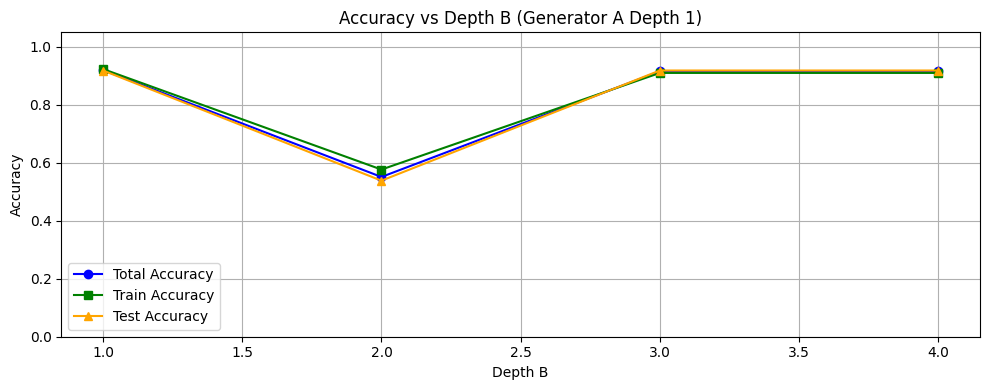

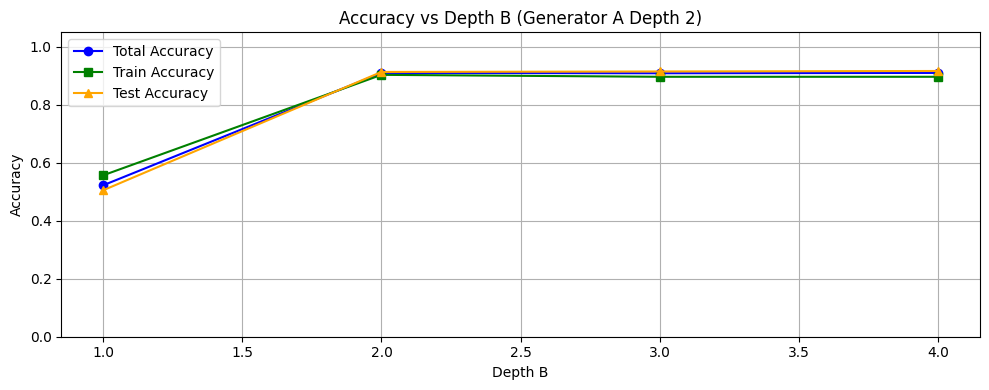

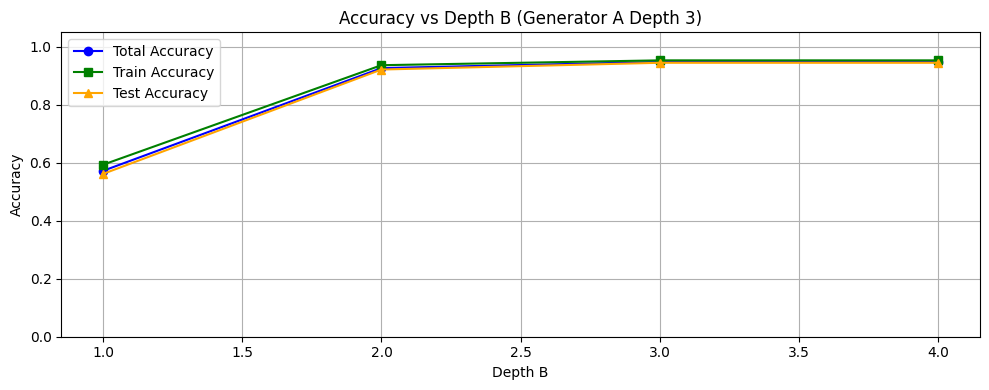

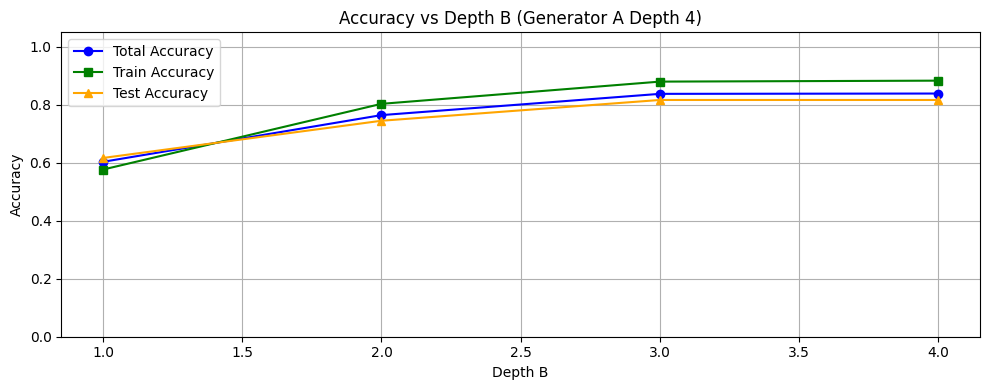

In [11]:

# Convert results to a DataFrame for easier filtering
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


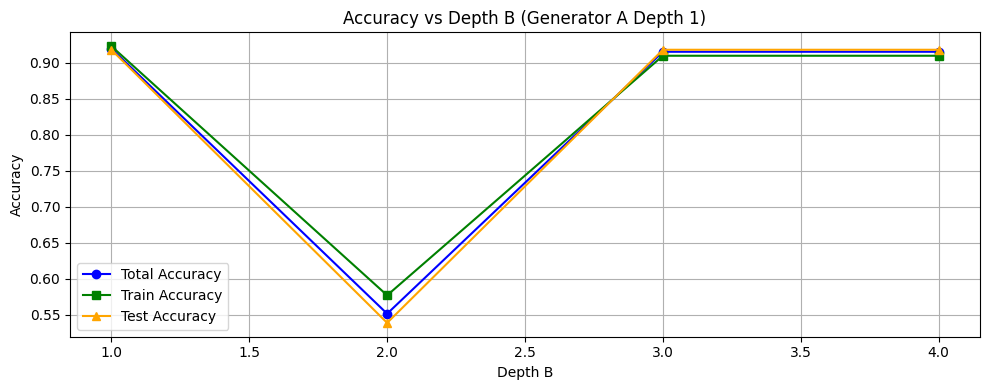

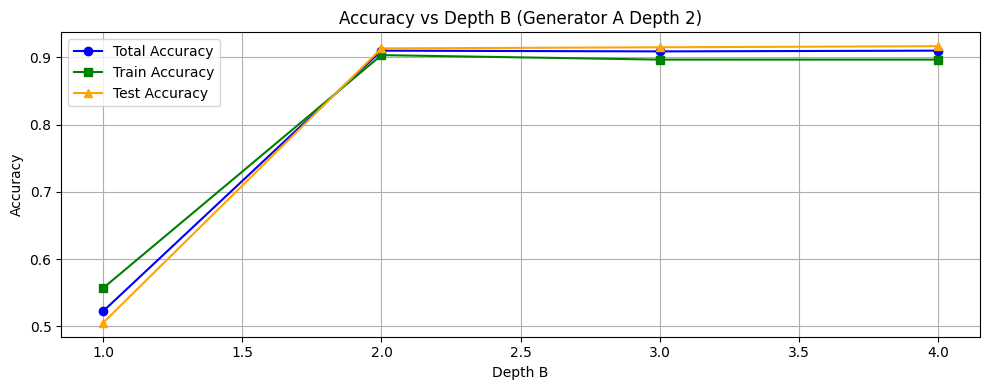

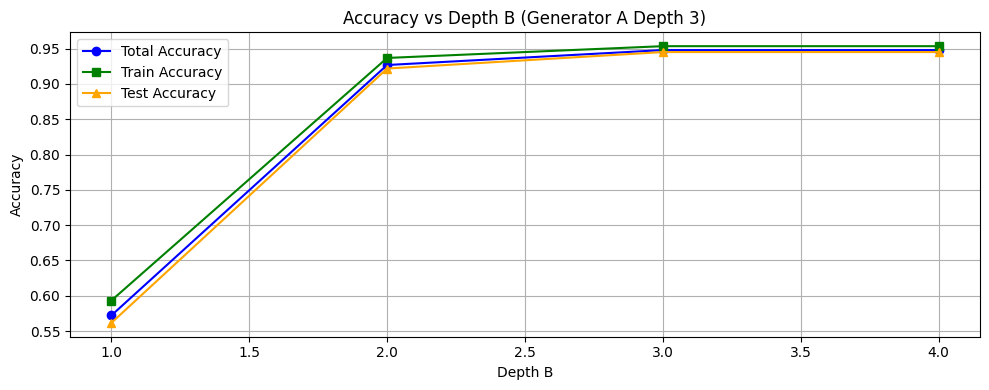

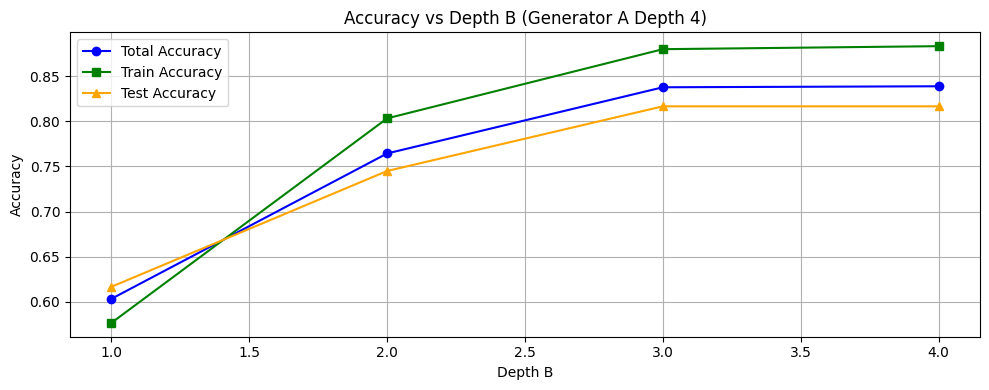

In [12]:
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    # plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

# 50 Epochs

In [13]:
torch.manual_seed(42)
np.random.seed(42)
# Main experiment
depths = [1, 2, 3, 4]
train_idx = np.random.choice(len(inputs), size=300, replace=False)
X_train = torch.tensor(inputs[train_idx], dtype=torch.float32)

results = []


  0%|          | 0/4 [00:00<?, ?it/s]

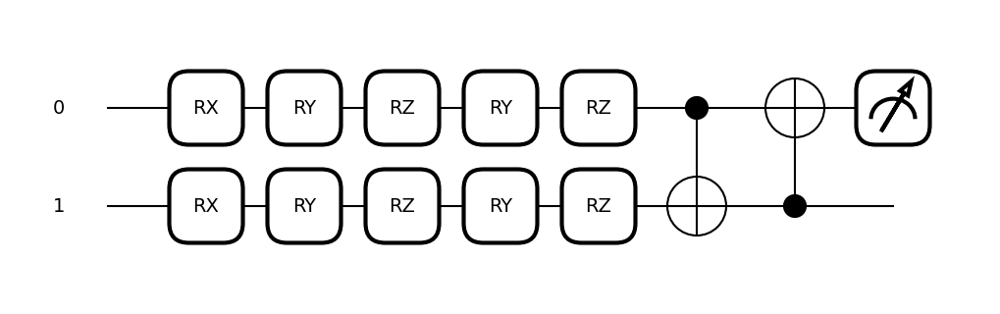

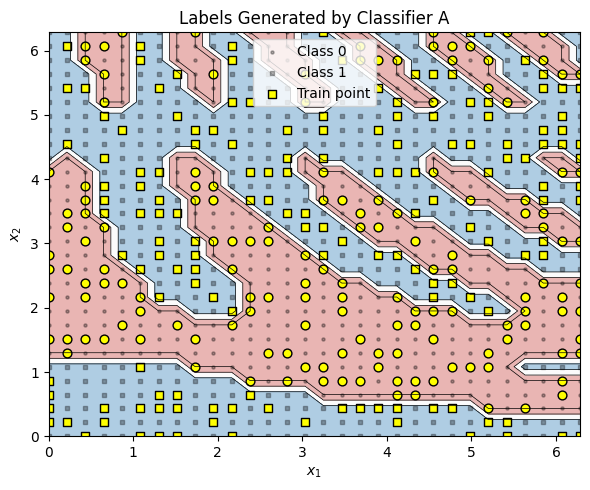

Training B(depth=1) on data from A(depth=1)
Total Accuracy: 0.8722222222222222
Train Accuracy: 0.8733333333333333
Test Accuracy: 0.8716666666666667
Test Precision: 0.8779761904761905
Test Recall: 0.8912386706948641
Test F1: 0.8845577211394303
Time taken: 40.12648296356201


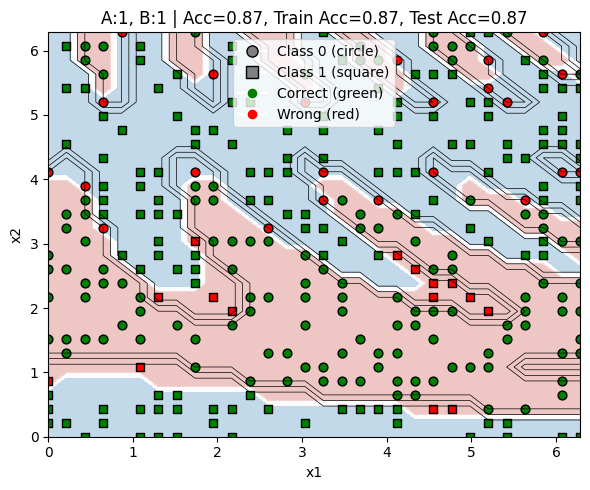

Training B(depth=2) on data from A(depth=1)
Total Accuracy: 0.5544444444444444
Train Accuracy: 0.5933333333333334
Test Accuracy: 0.535
Test Precision: 0.5884353741496599
Test Recall: 0.5226586102719033
Test F1: 0.5535999999999999
Time taken: 63.26151704788208


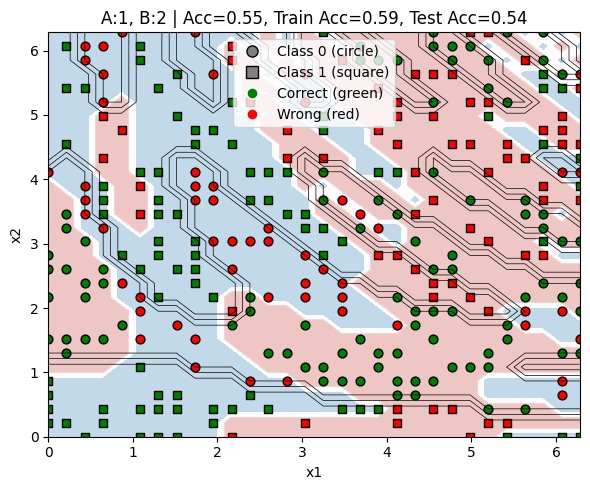

Training B(depth=3) on data from A(depth=1)
Total Accuracy: 0.9155555555555556
Train Accuracy: 0.91
Test Accuracy: 0.9183333333333333
Test Precision: 0.9246987951807228
Test Recall: 0.9274924471299094
Test F1: 0.9260935143288084
Time taken: 86.3712329864502


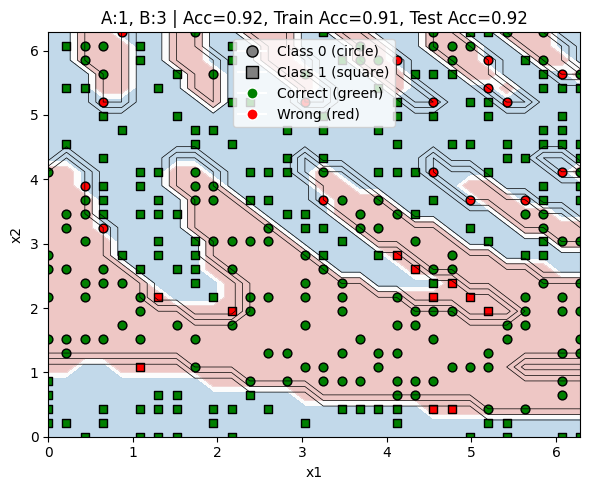

Training B(depth=4) on data from A(depth=1)
Total Accuracy: 0.9233333333333333
Train Accuracy: 0.9266666666666666
Test Accuracy: 0.9216666666666666
Test Precision: 0.9251497005988024
Test Recall: 0.9335347432024169
Test F1: 0.9293233082706768
Time taken: 111.28632116317749


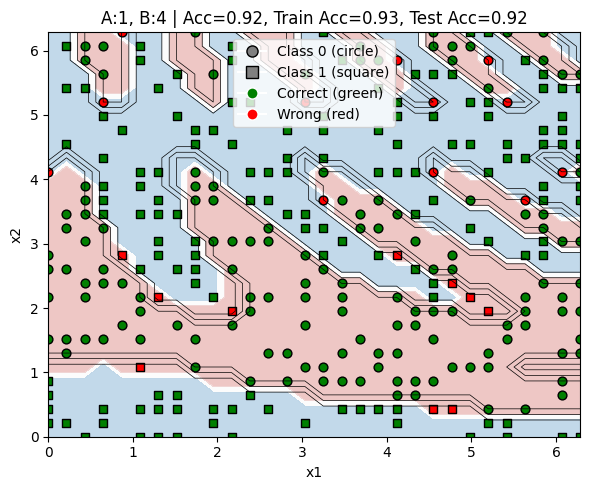

 25%|██▌       | 1/4 [05:06<15:18, 306.10s/it]

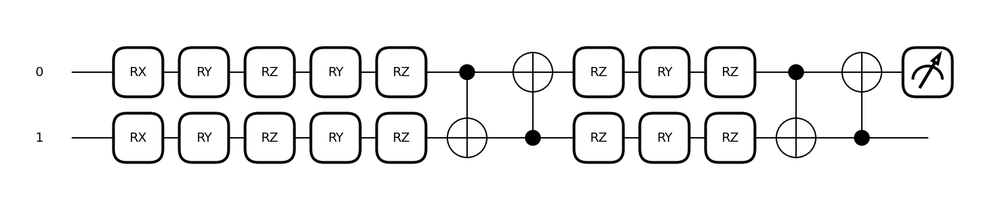

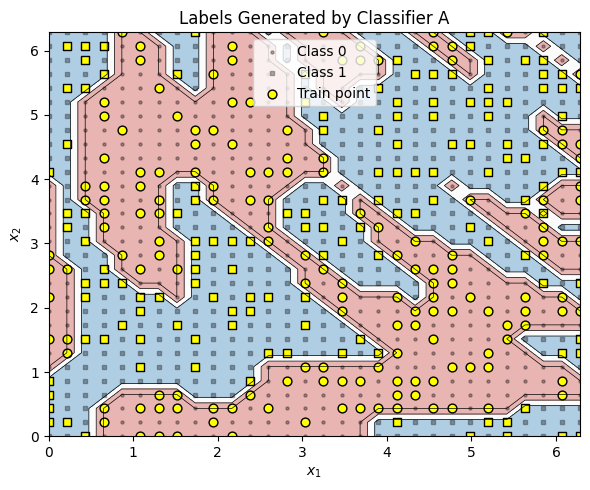

Training B(depth=1) on data from A(depth=2)
Total Accuracy: 0.5155555555555555
Train Accuracy: 0.5466666666666666
Test Accuracy: 0.5
Test Precision: 0.5122699386503068
Test Recall: 0.5422077922077922
Test F1: 0.526813880126183
Time taken: 40.00128507614136


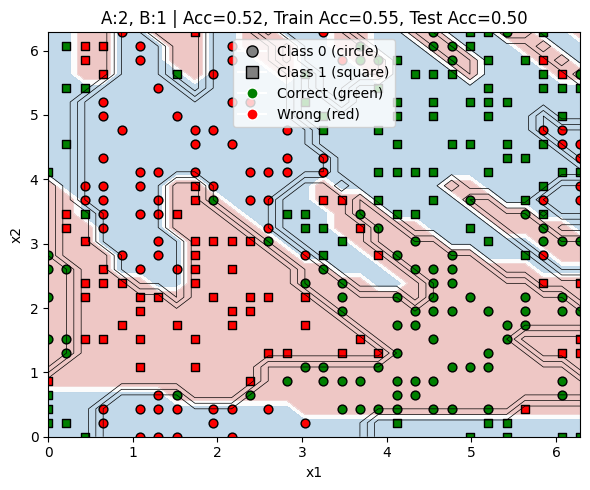

Training B(depth=2) on data from A(depth=2)
Total Accuracy: 0.8966666666666666
Train Accuracy: 0.8866666666666667
Test Accuracy: 0.9016666666666666
Test Precision: 0.9003215434083601
Test Recall: 0.9090909090909091
Test F1: 0.9046849757673666
Time taken: 63.27137351036072


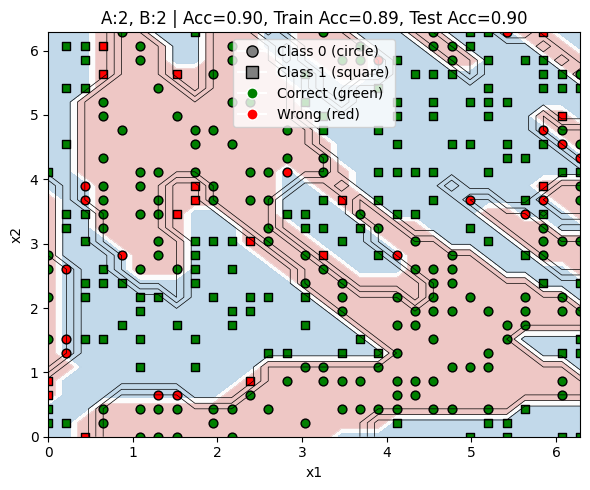

Training B(depth=3) on data from A(depth=2)
Total Accuracy: 0.8988888888888888
Train Accuracy: 0.9
Test Accuracy: 0.8983333333333333
Test Precision: 0.8920634920634921
Test Recall: 0.9123376623376623
Test F1: 0.9020866773675763
Time taken: 88.02519631385803


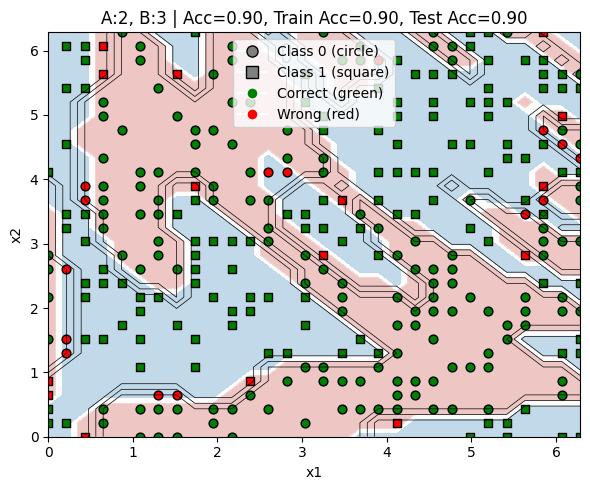

Training B(depth=4) on data from A(depth=2)
Total Accuracy: 0.9077777777777778
Train Accuracy: 0.89
Test Accuracy: 0.9166666666666666
Test Precision: 0.9056603773584906
Test Recall: 0.935064935064935
Test F1: 0.9201277955271565
Time taken: 110.42083382606506


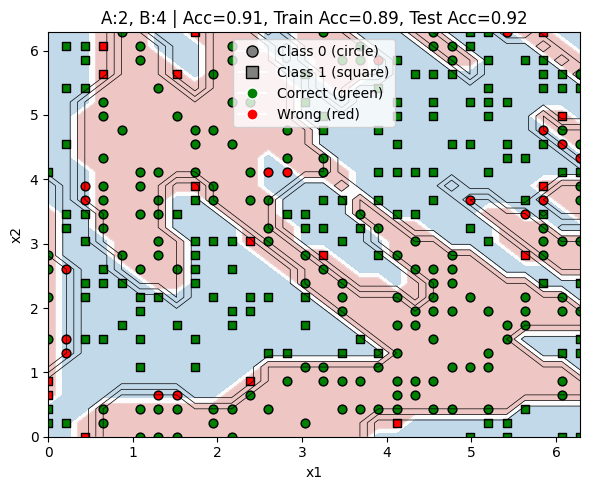

 50%|█████     | 2/4 [10:13<10:13, 307.00s/it]

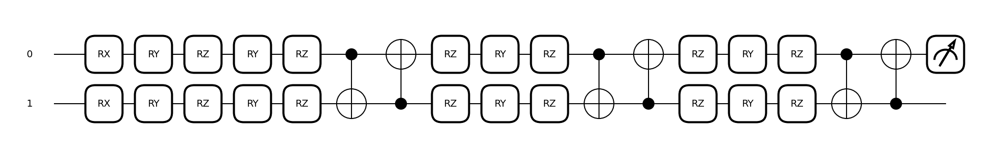

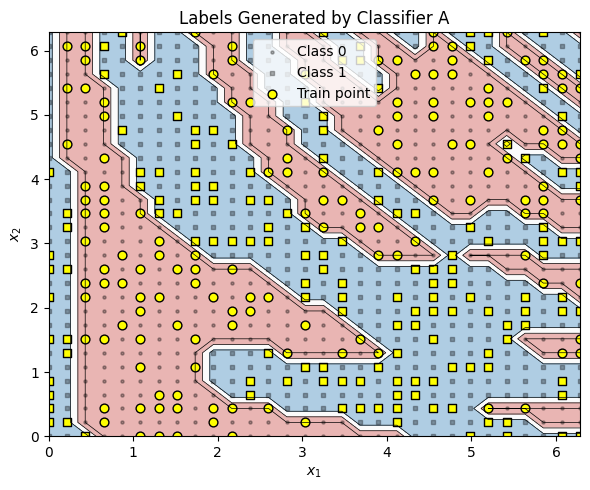

Training B(depth=1) on data from A(depth=3)
Total Accuracy: 0.5733333333333334
Train Accuracy: 0.5766666666666667
Test Accuracy: 0.5716666666666667
Test Precision: 0.5888888888888889
Test Recall: 0.521311475409836
Test F1: 0.5530434782608695
Time taken: 40.07108449935913


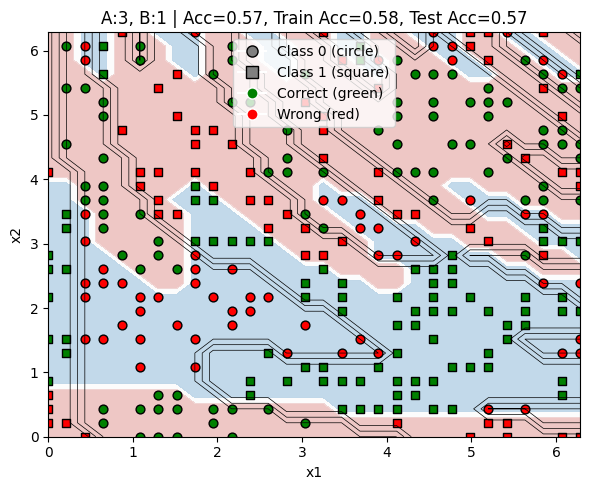

Training B(depth=2) on data from A(depth=3)
Total Accuracy: 0.9
Train Accuracy: 0.9033333333333333
Test Accuracy: 0.8983333333333333
Test Precision: 0.9039735099337748
Test Recall: 0.8950819672131147
Test F1: 0.8995057660626029
Time taken: 63.7855269908905


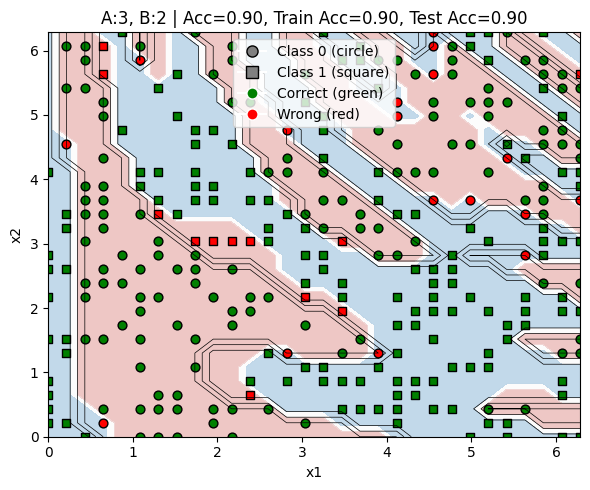

Training B(depth=3) on data from A(depth=3)
Total Accuracy: 0.94
Train Accuracy: 0.94
Test Accuracy: 0.94
Test Precision: 0.940983606557377
Test Recall: 0.940983606557377
Test F1: 0.940983606557377
Time taken: 88.01687622070312


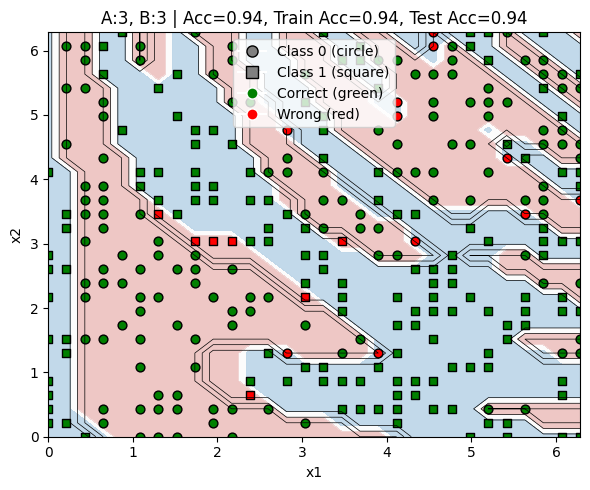

Training B(depth=4) on data from A(depth=3)
Total Accuracy: 0.9477777777777778
Train Accuracy: 0.9533333333333334
Test Accuracy: 0.945
Test Precision: 0.9473684210526315
Test Recall: 0.9442622950819672
Test F1: 0.9458128078817734
Time taken: 110.98738622665405


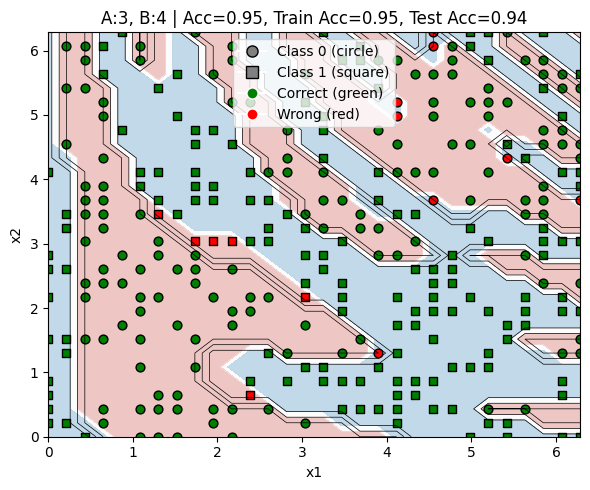

 75%|███████▌  | 3/4 [15:23<05:08, 308.12s/it]

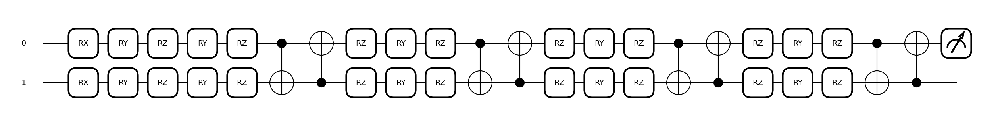

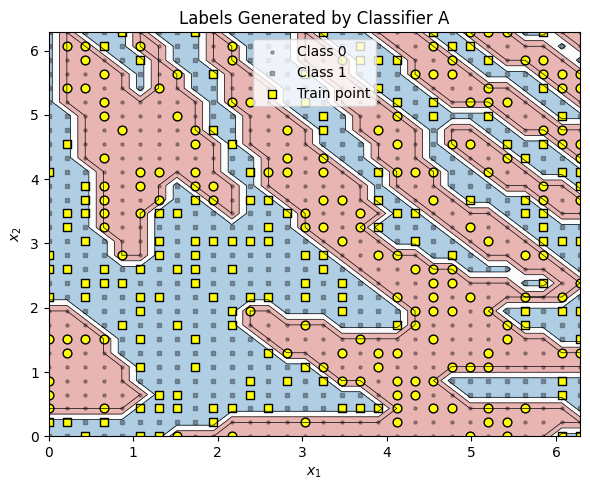

Training B(depth=1) on data from A(depth=4)
Total Accuracy: 0.6033333333333334
Train Accuracy: 0.5733333333333334
Test Accuracy: 0.6183333333333333
Test Precision: 0.6121673003802282
Test Recall: 0.5590277777777778
Test F1: 0.5843920145190563
Time taken: 40.18222451210022


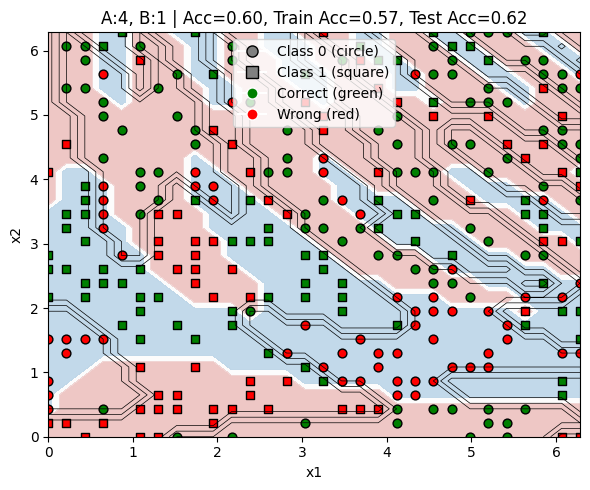

Training B(depth=2) on data from A(depth=4)
Total Accuracy: 0.6733333333333333
Train Accuracy: 0.7133333333333334
Test Accuracy: 0.6533333333333333
Test Precision: 0.6265822784810127
Test Recall: 0.6875
Test F1: 0.6556291390728477
Time taken: 62.69169282913208


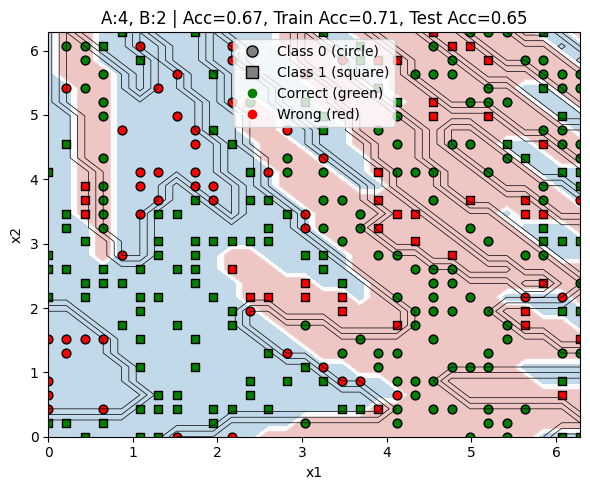

Training B(depth=3) on data from A(depth=4)
Total Accuracy: 0.8311111111111111
Train Accuracy: 0.8766666666666667
Test Accuracy: 0.8083333333333333
Test Precision: 0.7746031746031746
Test Recall: 0.8472222222222222
Test F1: 0.8092868988391376
Time taken: 86.04599690437317


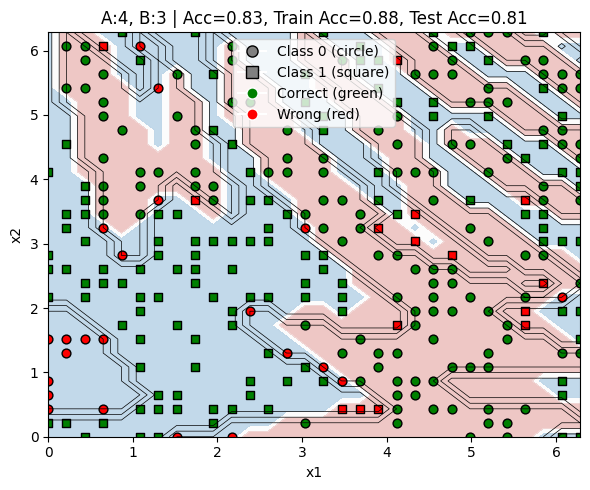

Training B(depth=4) on data from A(depth=4)
Total Accuracy: 0.8144444444444444
Train Accuracy: 0.86
Test Accuracy: 0.7916666666666666
Test Precision: 0.7587301587301587
Test Recall: 0.8298611111111112
Test F1: 0.7927031509121062
Time taken: 110.0420196056366


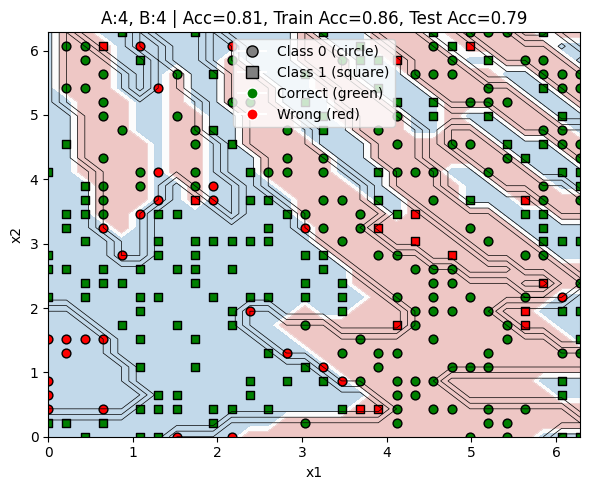

100%|██████████| 4/4 [20:29<00:00, 307.33s/it]


In [14]:

for depth_A in tqdm(depths):
    # Generate labels using fixed A
    devA = qml.device("default.qubit", wires=n_qubits)
    weights_A = np.random.uniform(0, 2*np.pi, size=(depth_A, n_qubits, 3))
    circuit_A = create_qnode(depth_A, weights_A, devA)
    labels_A = generate_labels(circuit_A, inputs)
    y_train = torch.tensor(labels_A[train_idx], dtype=torch.float32).unsqueeze(1)
    y_test = torch.tensor(labels_A[test_idx], dtype=torch.float32).unsqueeze(1)
    qml.drawer.draw_mpl(circuit_A)([0, 1]);
    plot_generator_A(labels_A, "Labels Generated by Classifier A", X=inputs, train_idx=train_idx)
    
    for depth_B in tqdm(depths):
        print(f"Training B(depth={depth_B}) on data from A(depth={depth_A})")
        devB = qml.device("default.qubit", wires=n_qubits)
        model_B = get_torch_model(depth_B, devB)
        start_time = time.time()
        trained_model = train_model(model_B, X_train, y_train,epochs = 50)

        # Evaluate model
        with torch.no_grad():
            preds = torch.stack([trained_model(x) for x in torch.tensor(inputs, dtype=torch.float32)]).numpy().flatten()
            pred_labels = (preds > 0).astype(int)
            
        train_preds = pred_labels[train_idx]
        test_preds = pred_labels[test_idx]
        
        acc = accuracy_score(labels_A, pred_labels)
        train_acc = accuracy_score(labels_A[train_idx], train_preds)
        test_acc = accuracy_score(labels_A[test_idx], test_preds)
        precision = precision_score(labels_A[test_idx], test_preds)
        recall = recall_score(labels_A[test_idx], test_preds)
        f1 = f1_score(labels_A[test_idx], test_preds)
        # Plot
        title = f"A:{depth_A}, B:{depth_B} | Acc={acc:.2f}, Train Acc={train_acc:.2f}, Test Acc={test_acc:.2f}"
        print("Total Accuracy:", acc)
        print("Train Accuracy:", train_acc)
        print("Test Accuracy:", test_acc)
        print("Test Precision:", precision)
        print("Test Recall:", recall)
        print("Test F1:", f1)
        print("Time taken:", time.time() - start_time)
        results.append((depth_A, depth_B, acc, train_acc, test_acc))
        plot_results(labels_A, pred_labels, title, inputs, train_idx)
        




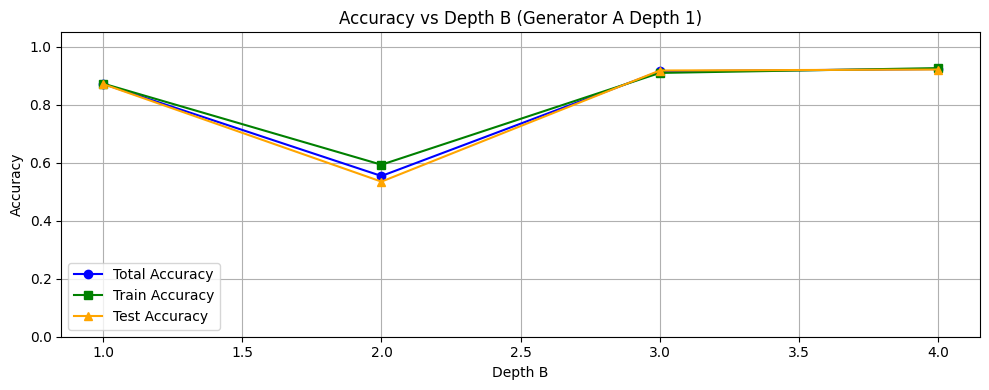

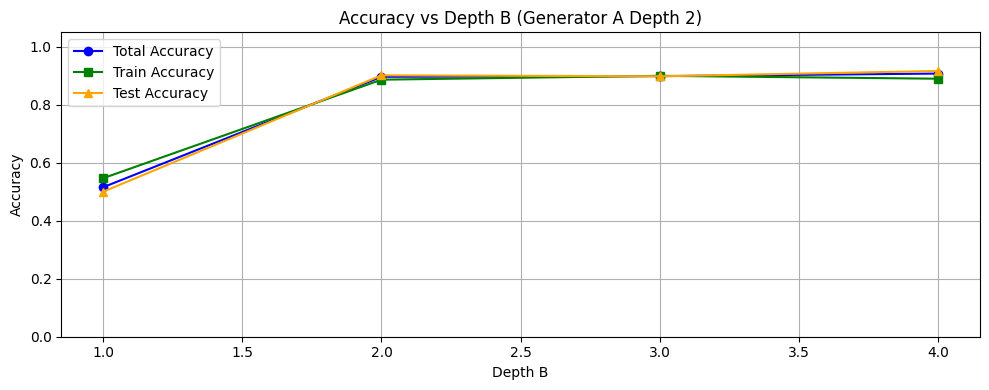

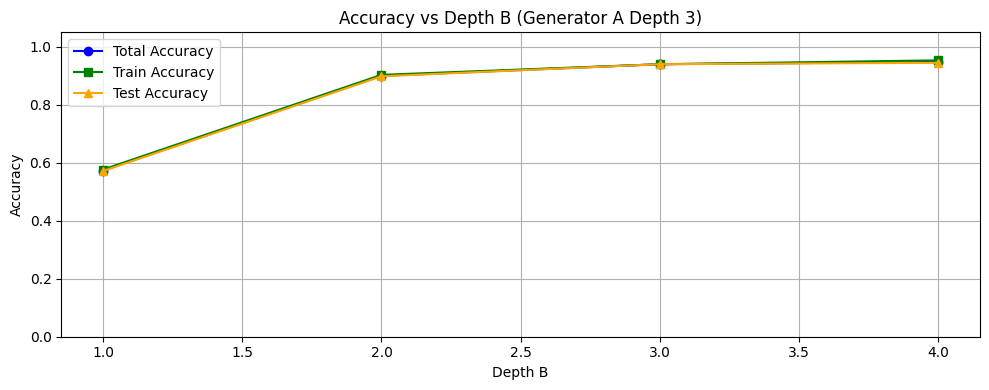

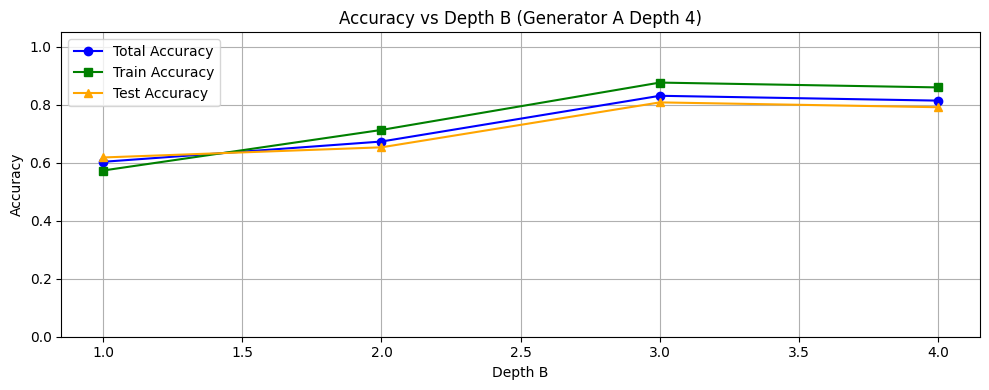

In [15]:

# Convert results to a DataFrame for easier filtering
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


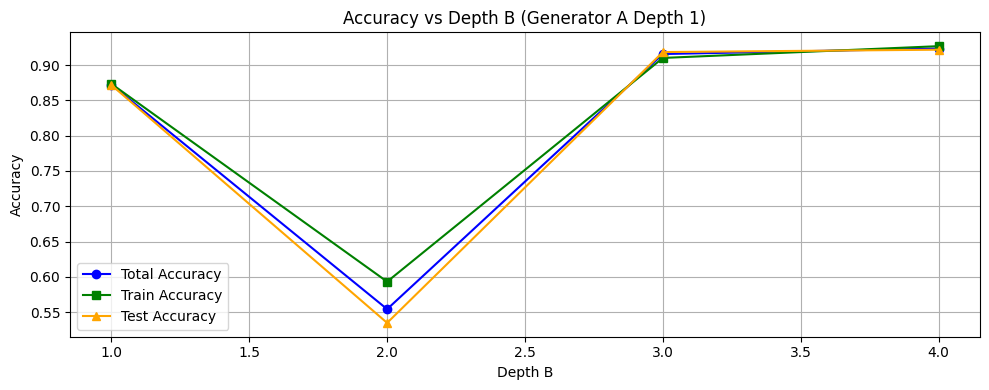

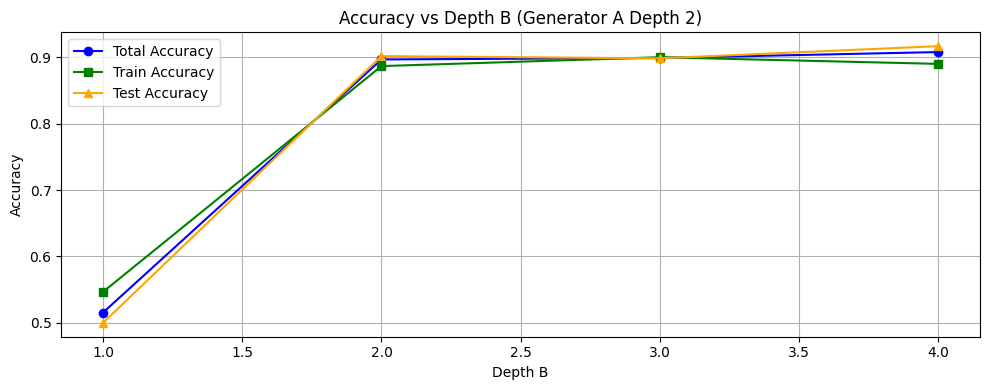

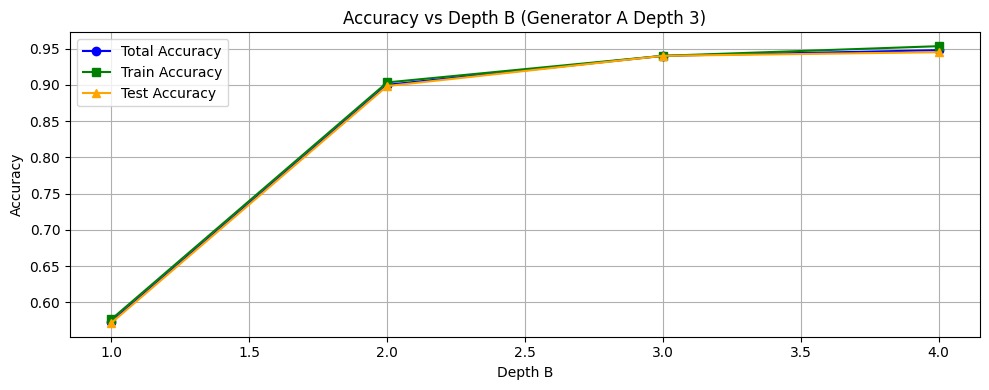

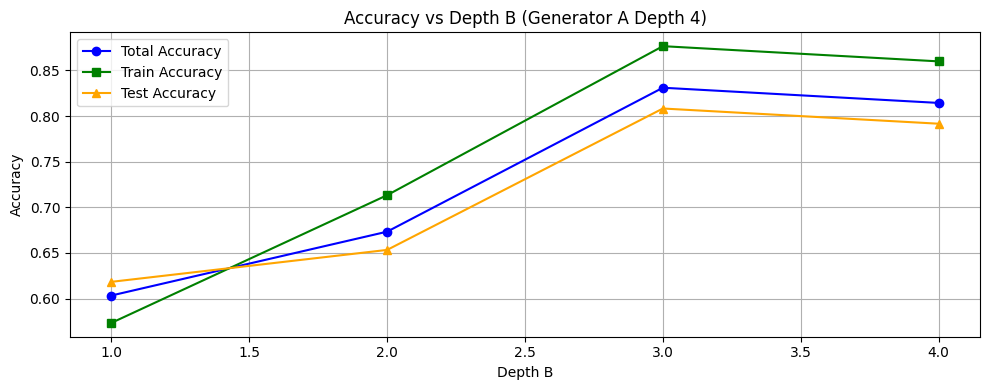

In [16]:
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    # plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

# 200 Epochs

In [17]:
torch.manual_seed(42)
np.random.seed(42)
# Main experiment
depths = [1, 2, 3, 4]
train_idx = np.random.choice(len(inputs), size=300, replace=False)
X_train = torch.tensor(inputs[train_idx], dtype=torch.float32)

results = []


  0%|          | 0/4 [00:00<?, ?it/s]

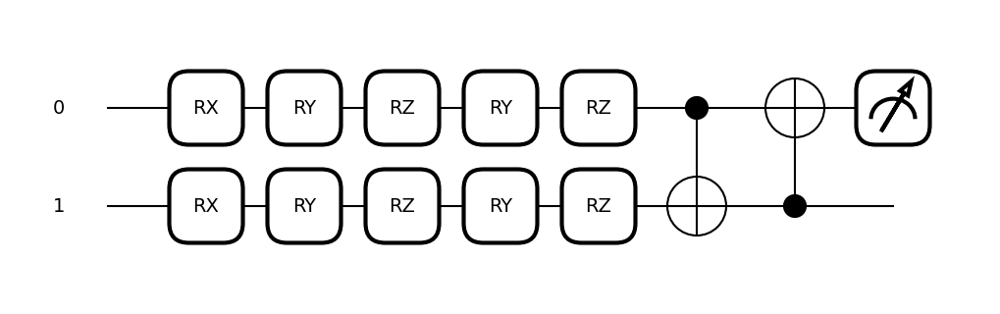

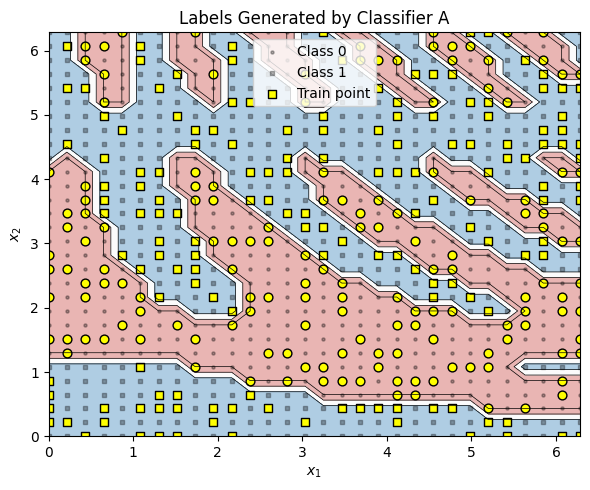

Training B(depth=1) on data from A(depth=1)
Total Accuracy: 0.9177777777777778
Train Accuracy: 0.9233333333333333
Test Accuracy: 0.915
Test Precision: 0.9216867469879518
Test Recall: 0.9244712990936556
Test F1: 0.9230769230769231
Time taken: 155.41946721076965


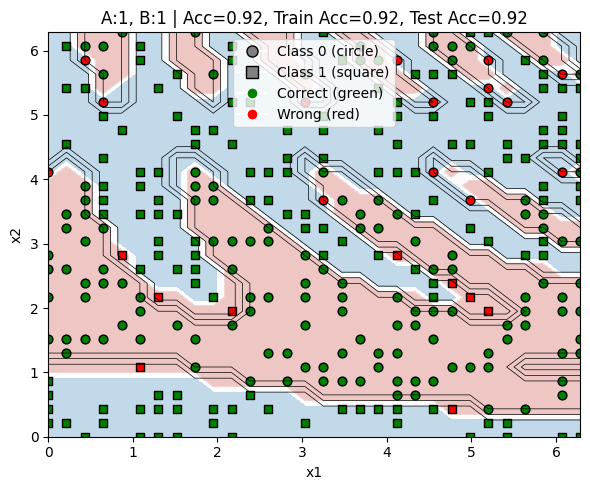

Training B(depth=2) on data from A(depth=1)
Total Accuracy: 0.5533333333333333
Train Accuracy: 0.5833333333333334
Test Accuracy: 0.5383333333333333
Test Precision: 0.5918367346938775
Test Recall: 0.525679758308157
Test F1: 0.5568000000000001
Time taken: 246.85859298706055


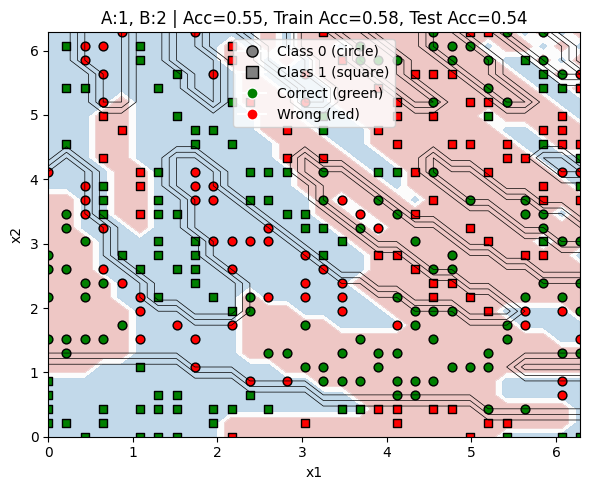

Training B(depth=3) on data from A(depth=1)
Total Accuracy: 0.9155555555555556
Train Accuracy: 0.91
Test Accuracy: 0.9183333333333333
Test Precision: 0.9246987951807228
Test Recall: 0.9274924471299094
Test F1: 0.9260935143288084
Time taken: 339.6009433269501


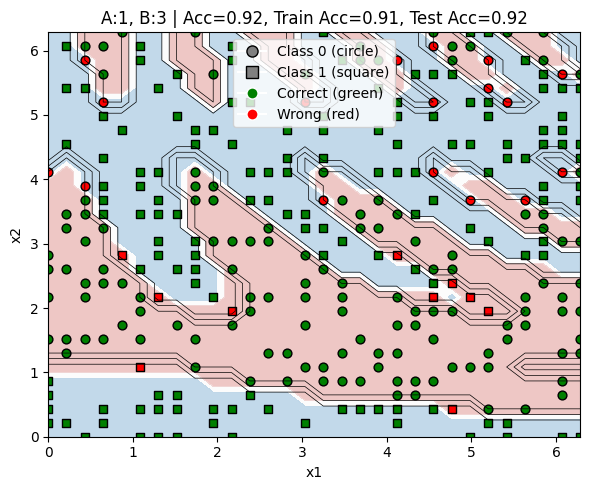

Training B(depth=4) on data from A(depth=1)
Total Accuracy: 0.9155555555555556
Train Accuracy: 0.91
Test Accuracy: 0.9183333333333333
Test Precision: 0.9246987951807228
Test Recall: 0.9274924471299094
Test F1: 0.9260935143288084
Time taken: 432.45675444602966


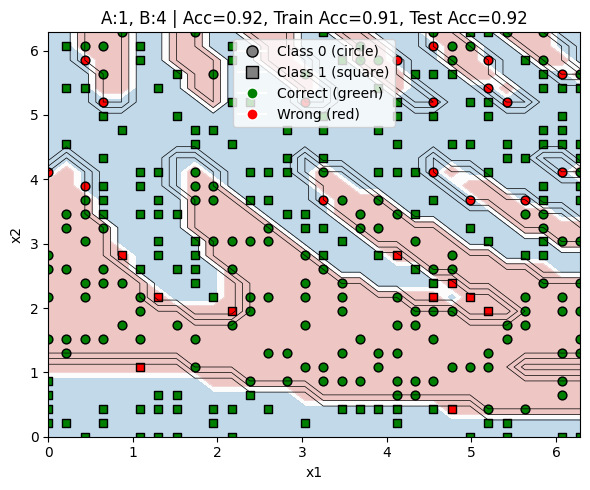

 25%|██▌       | 1/4 [19:39<58:58, 1179.43s/it]

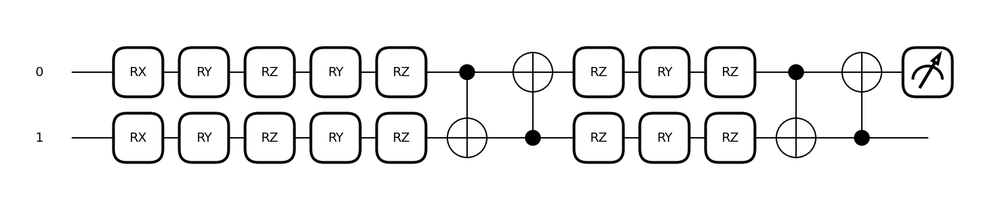

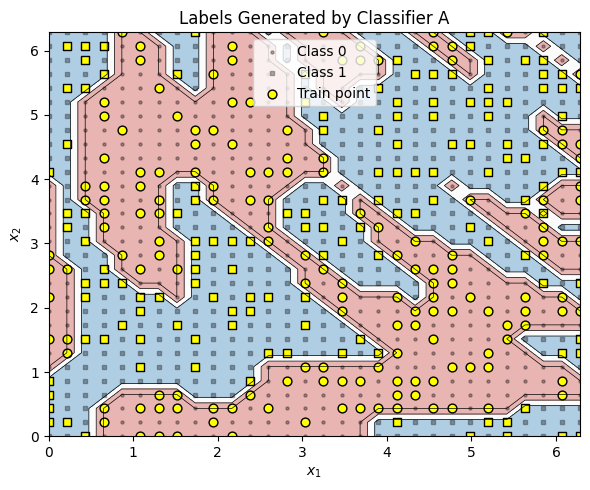

Training B(depth=1) on data from A(depth=2)
Total Accuracy: 0.5233333333333333
Train Accuracy: 0.5633333333333334
Test Accuracy: 0.5033333333333333
Test Precision: 0.515527950310559
Test Recall: 0.538961038961039
Test F1: 0.5269841269841269
Time taken: 155.498370885849


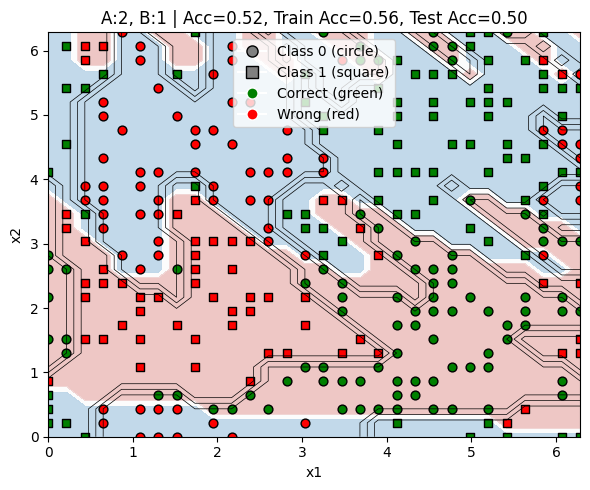

Training B(depth=2) on data from A(depth=2)
Total Accuracy: 0.91
Train Accuracy: 0.9033333333333333
Test Accuracy: 0.9133333333333333
Test Precision: 0.9129032258064517
Test Recall: 0.9188311688311688
Test F1: 0.9158576051779936
Time taken: 247.96556544303894


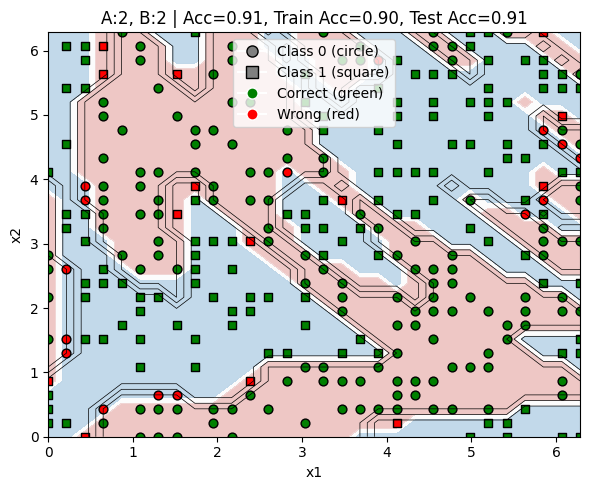

Training B(depth=3) on data from A(depth=2)
Total Accuracy: 0.91
Train Accuracy: 0.8966666666666666
Test Accuracy: 0.9166666666666666
Test Precision: 0.910828025477707
Test Recall: 0.9285714285714286
Test F1: 0.9196141479099679
Time taken: 341.3878171443939


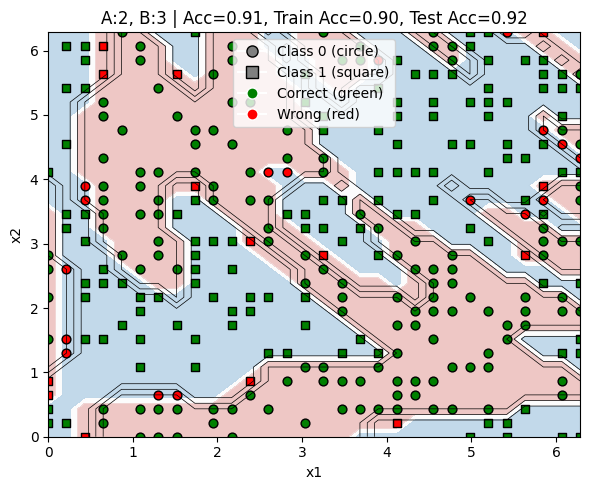

Training B(depth=4) on data from A(depth=2)
Total Accuracy: 0.91
Train Accuracy: 0.8966666666666666
Test Accuracy: 0.9166666666666666
Test Precision: 0.910828025477707
Test Recall: 0.9285714285714286
Test F1: 0.9196141479099679
Time taken: 432.58342361450195


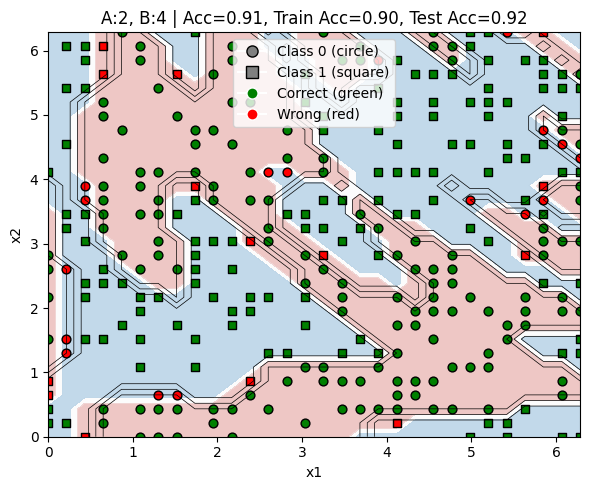

 50%|█████     | 2/4 [39:22<39:23, 1181.60s/it]

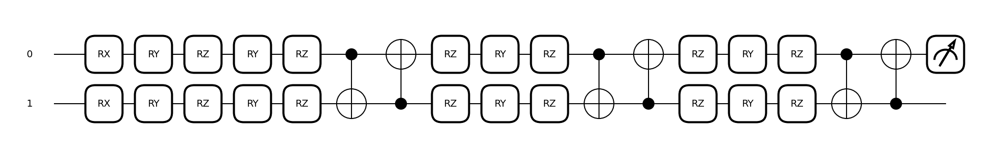

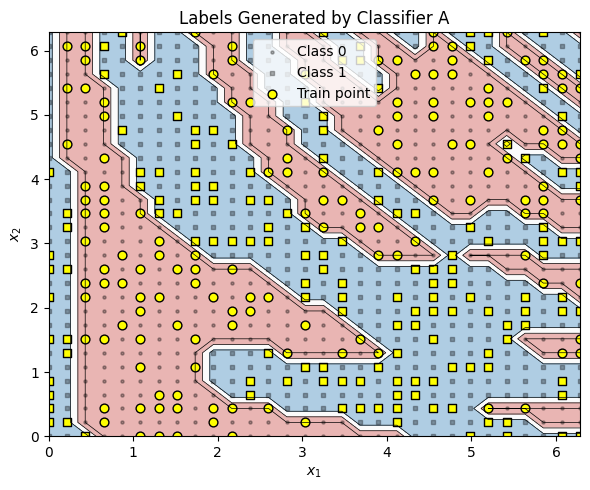

Training B(depth=1) on data from A(depth=3)
Total Accuracy: 0.5722222222222222
Train Accuracy: 0.5966666666666667
Test Accuracy: 0.56
Test Precision: 0.5767790262172284
Test Recall: 0.5049180327868853
Test F1: 0.5384615384615384
Time taken: 153.95025610923767


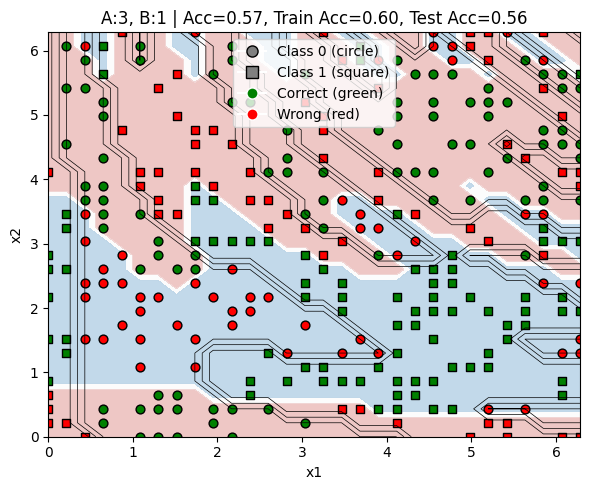

Training B(depth=2) on data from A(depth=3)
Total Accuracy: 0.9266666666666666
Train Accuracy: 0.9366666666666666
Test Accuracy: 0.9216666666666666
Test Precision: 0.9243421052631579
Test Recall: 0.921311475409836
Test F1: 0.9228243021346468
Time taken: 247.17594075202942


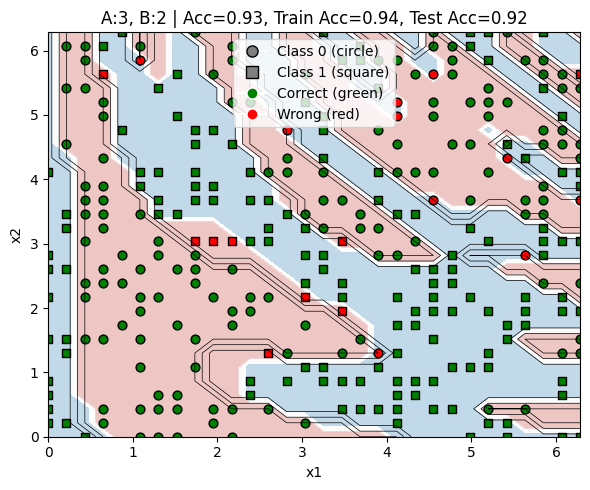

Training B(depth=3) on data from A(depth=3)
Total Accuracy: 0.9477777777777778
Train Accuracy: 0.9533333333333334
Test Accuracy: 0.945
Test Precision: 0.9473684210526315
Test Recall: 0.9442622950819672
Test F1: 0.9458128078817734
Time taken: 340.98824548721313


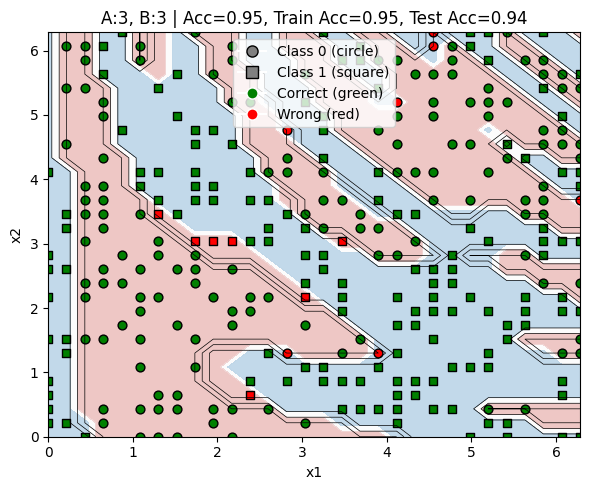

Training B(depth=4) on data from A(depth=3)
Total Accuracy: 0.9477777777777778
Train Accuracy: 0.9533333333333334
Test Accuracy: 0.945
Test Precision: 0.9473684210526315
Test Recall: 0.9442622950819672
Test F1: 0.9458128078817734
Time taken: 430.60083842277527


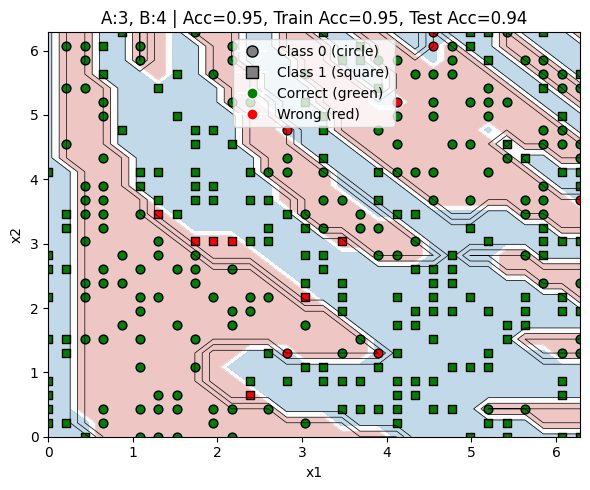

 75%|███████▌  | 3/4 [59:01<19:40, 1180.47s/it]

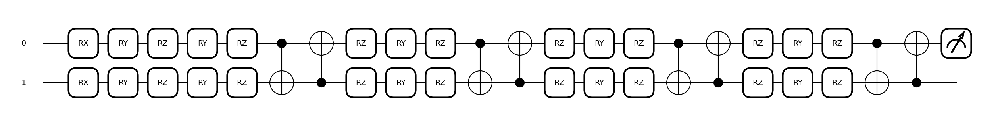

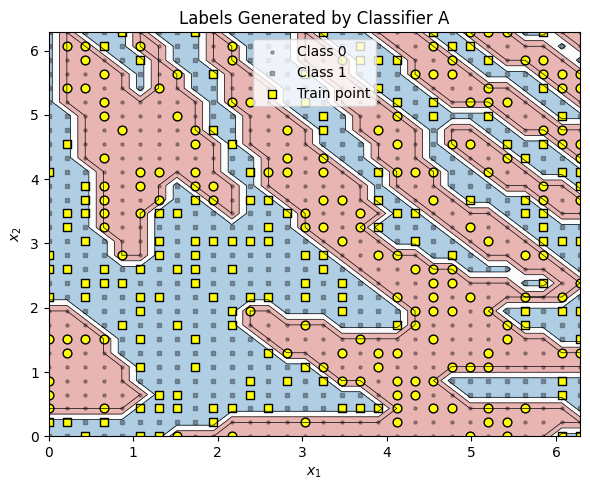

Training B(depth=1) on data from A(depth=4)
Total Accuracy: 0.6033333333333334
Train Accuracy: 0.5766666666666667
Test Accuracy: 0.6166666666666667
Test Precision: 0.6106870229007634
Test Recall: 0.5555555555555556
Test F1: 0.5818181818181819
Time taken: 153.0632016658783


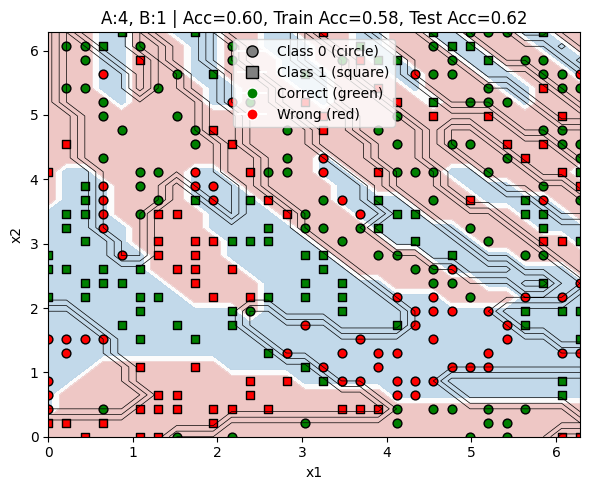

Training B(depth=2) on data from A(depth=4)
Total Accuracy: 0.7666666666666667
Train Accuracy: 0.8033333333333333
Test Accuracy: 0.7483333333333333
Test Precision: 0.7120743034055728
Test Recall: 0.7986111111111112
Test F1: 0.7528641571194763
Time taken: 246.91999530792236


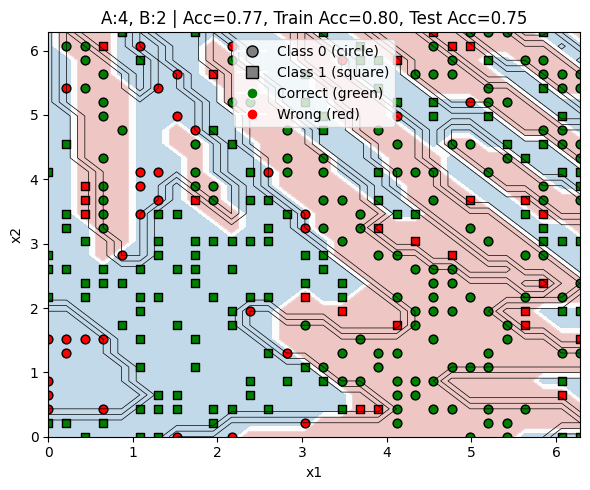

Training B(depth=3) on data from A(depth=4)
Total Accuracy: 0.8366666666666667
Train Accuracy: 0.8766666666666667
Test Accuracy: 0.8166666666666667
Test Precision: 0.7763975155279503
Test Recall: 0.8680555555555556
Test F1: 0.819672131147541
Time taken: 342.08815240859985


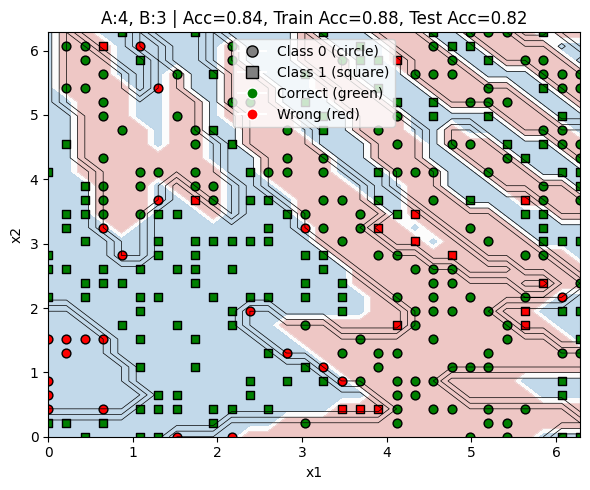

Training B(depth=4) on data from A(depth=4)
Total Accuracy: 0.8366666666666667
Train Accuracy: 0.8766666666666667
Test Accuracy: 0.8166666666666667
Test Precision: 0.7763975155279503
Test Recall: 0.8680555555555556
Test F1: 0.819672131147541
Time taken: 432.1542055606842


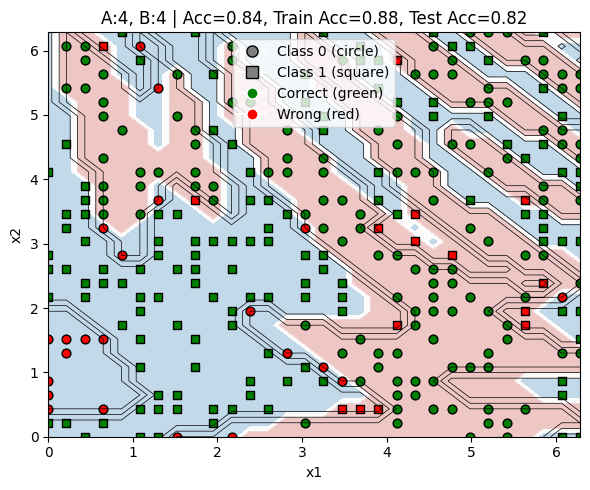

100%|██████████| 4/4 [1:18:43<00:00, 1180.87s/it]


In [18]:

for depth_A in tqdm(depths):
    # Generate labels using fixed A
    devA = qml.device("default.qubit", wires=n_qubits)
    weights_A = np.random.uniform(0, 2*np.pi, size=(depth_A, n_qubits, 3))
    circuit_A = create_qnode(depth_A, weights_A, devA)
    labels_A = generate_labels(circuit_A, inputs)
    y_train = torch.tensor(labels_A[train_idx], dtype=torch.float32).unsqueeze(1)
    y_test = torch.tensor(labels_A[test_idx], dtype=torch.float32).unsqueeze(1)
    qml.drawer.draw_mpl(circuit_A)([0, 1]);
    plot_generator_A(labels_A, "Labels Generated by Classifier A", X=inputs, train_idx=train_idx)
    
    for depth_B in tqdm(depths):
        print(f"Training B(depth={depth_B}) on data from A(depth={depth_A})")
        devB = qml.device("default.qubit", wires=n_qubits)
        model_B = get_torch_model(depth_B, devB)
        start_time = time.time()
        trained_model = train_model(model_B, X_train, y_train,epochs = 200)

        # Evaluate model
        with torch.no_grad():
            preds = torch.stack([trained_model(x) for x in torch.tensor(inputs, dtype=torch.float32)]).numpy().flatten()
            pred_labels = (preds > 0).astype(int)
            
        train_preds = pred_labels[train_idx]
        test_preds = pred_labels[test_idx]
        
        acc = accuracy_score(labels_A, pred_labels)
        train_acc = accuracy_score(labels_A[train_idx], train_preds)
        test_acc = accuracy_score(labels_A[test_idx], test_preds)
        precision = precision_score(labels_A[test_idx], test_preds)
        recall = recall_score(labels_A[test_idx], test_preds)
        f1 = f1_score(labels_A[test_idx], test_preds)
        # Plot
        title = f"A:{depth_A}, B:{depth_B} | Acc={acc:.2f}, Train Acc={train_acc:.2f}, Test Acc={test_acc:.2f}"
        print("Total Accuracy:", acc)
        print("Train Accuracy:", train_acc)
        print("Test Accuracy:", test_acc)
        print("Test Precision:", precision)
        print("Test Recall:", recall)
        print("Test F1:", f1)
        print("Time taken:", time.time() - start_time)
        results.append((depth_A, depth_B, acc, train_acc, test_acc))
        plot_results(labels_A, pred_labels, title, inputs, train_idx)
        




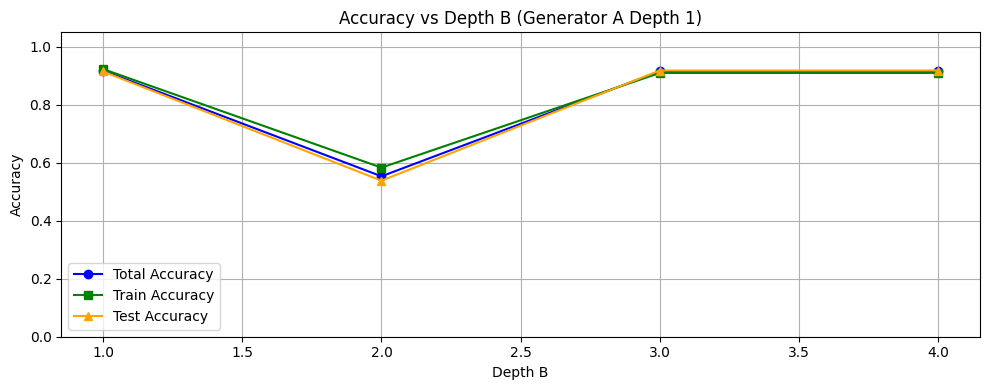

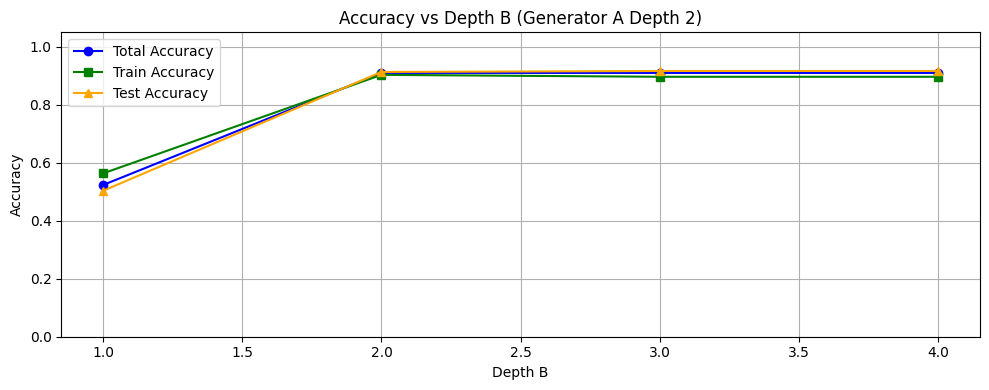

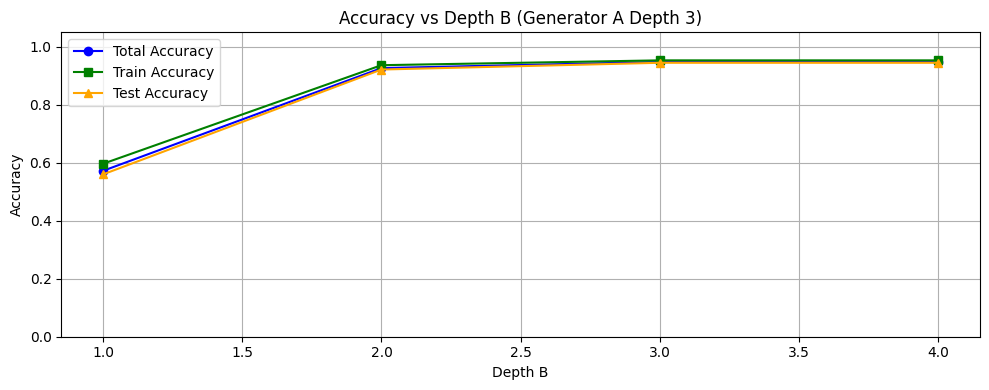

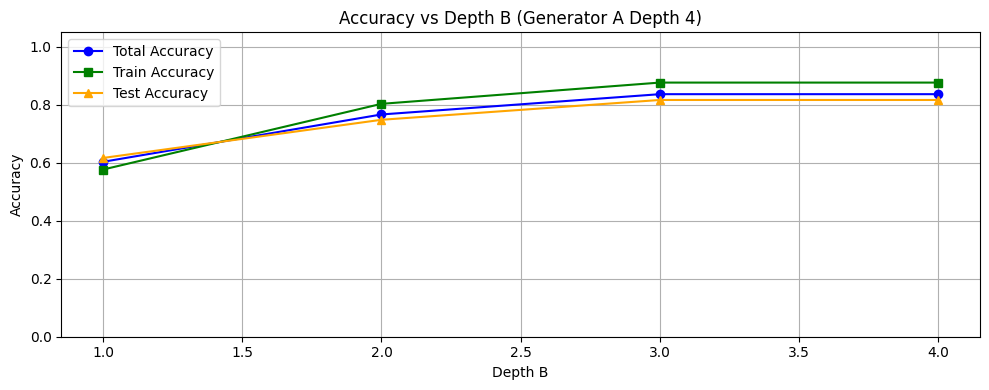

In [19]:

# Convert results to a DataFrame for easier filtering
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


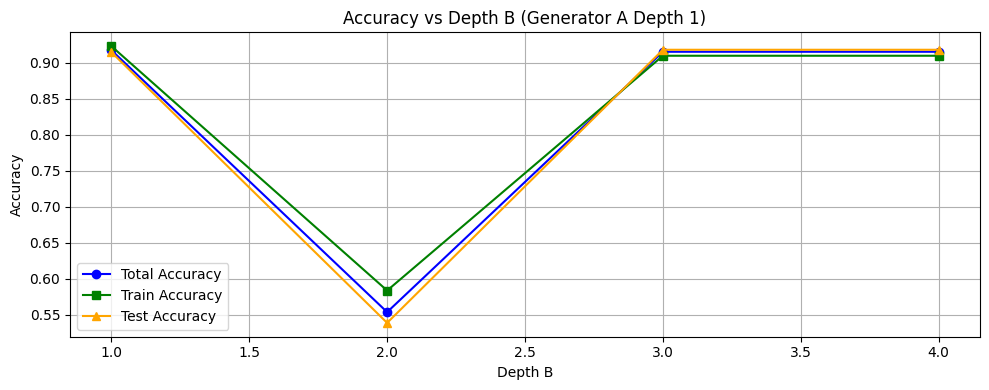

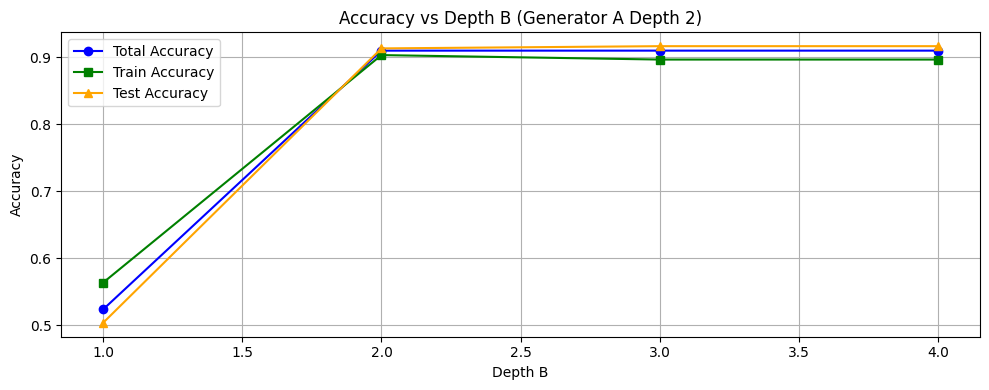

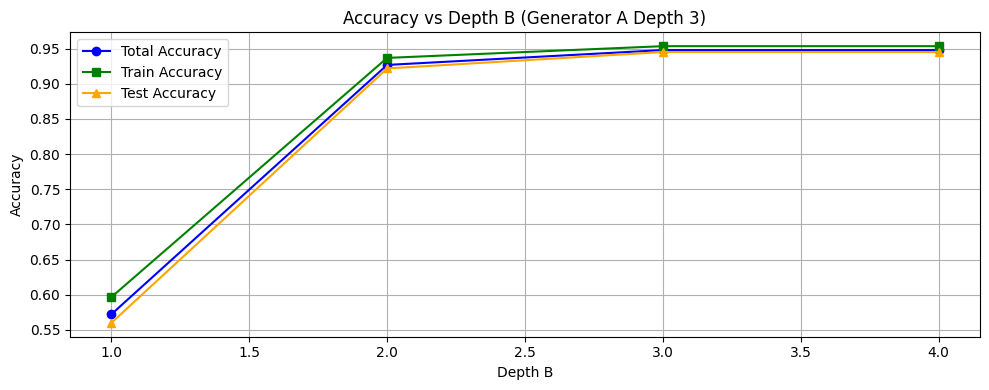

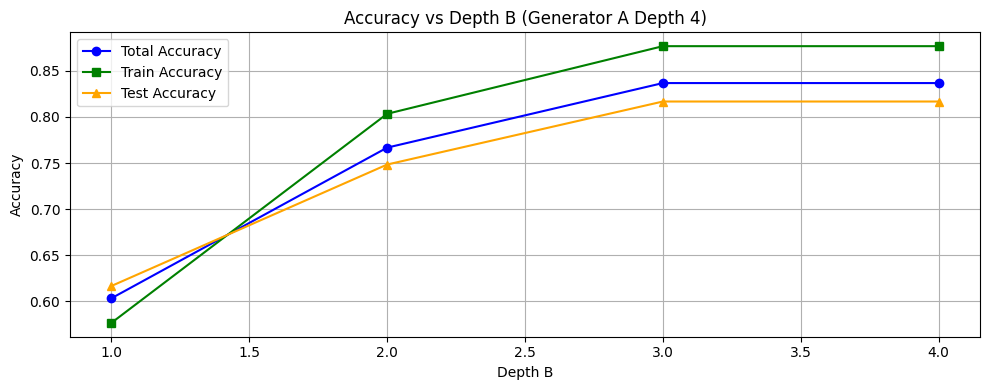

In [20]:
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    # plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

# 100 Epochs LR = 0.001

In [21]:
torch.manual_seed(42)
np.random.seed(42)
# Main experiment
depths = [1, 2, 3, 4]
train_idx = np.random.choice(len(inputs), size=300, replace=False)
X_train = torch.tensor(inputs[train_idx], dtype=torch.float32)

results = []


  0%|          | 0/4 [00:00<?, ?it/s]

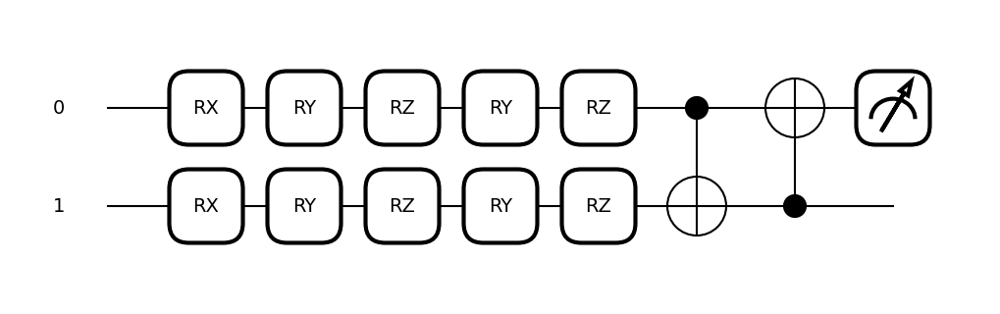

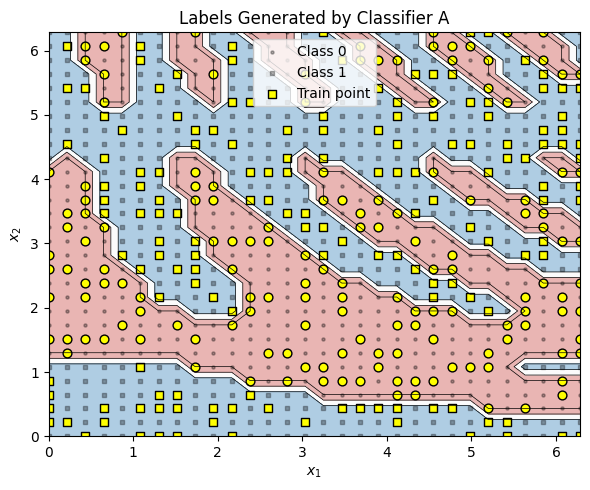

Training B(depth=1) on data from A(depth=1)
Total Accuracy: 0.11
Train Accuracy: 0.12333333333333334
Test Accuracy: 0.10333333333333333
Test Precision: 0.10943396226415095
Test Recall: 0.08761329305135952
Test F1: 0.09731543624161075
Time taken: 78.77969026565552


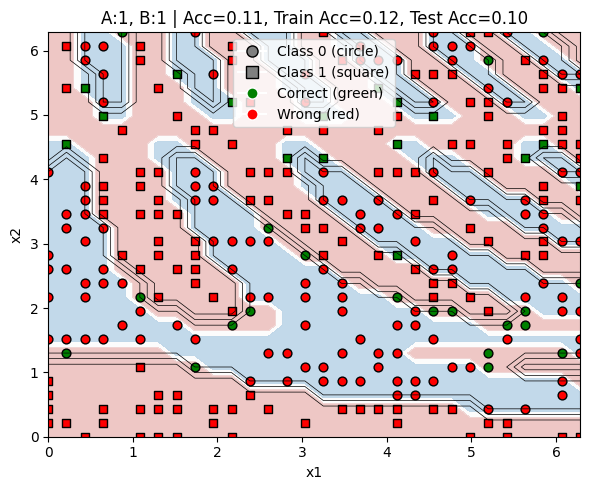

Training B(depth=2) on data from A(depth=1)
Total Accuracy: 0.5088888888888888
Train Accuracy: 0.51
Test Accuracy: 0.5083333333333333
Test Precision: 0.5545454545454546
Test Recall: 0.552870090634441
Test F1: 0.5537065052950075
Time taken: 124.22942876815796


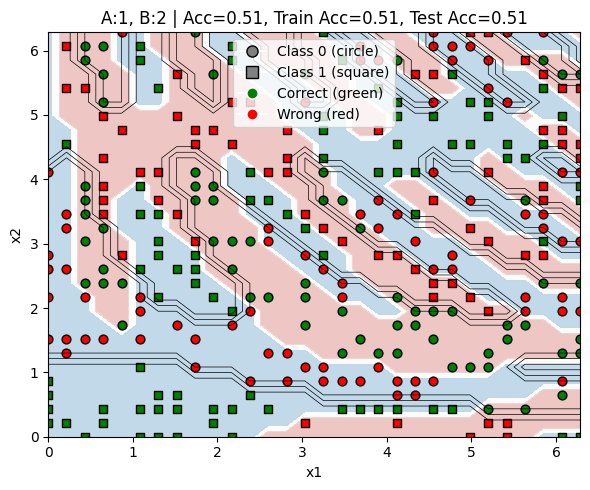

Training B(depth=3) on data from A(depth=1)
Total Accuracy: 0.43777777777777777
Train Accuracy: 0.4533333333333333
Test Accuracy: 0.43
Test Precision: 0.4827586206896552
Test Recall: 0.4652567975830816
Test F1: 0.47384615384615386
Time taken: 170.8508002758026


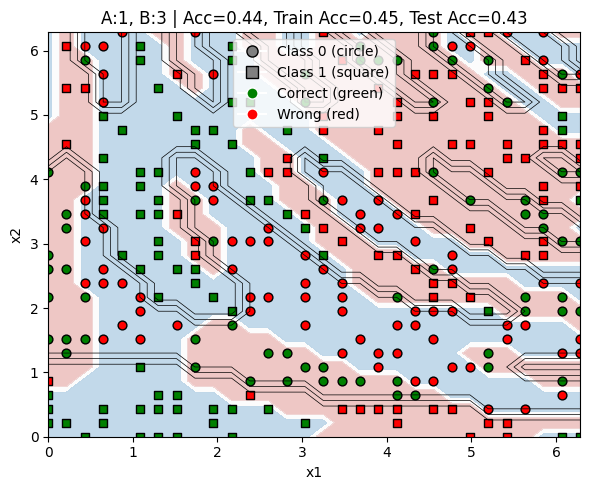

Training B(depth=4) on data from A(depth=1)
Total Accuracy: 0.4711111111111111
Train Accuracy: 0.47
Test Accuracy: 0.4716666666666667
Test Precision: 0.5216049382716049
Test Recall: 0.5105740181268882
Test F1: 0.5160305343511451
Time taken: 217.7195107936859


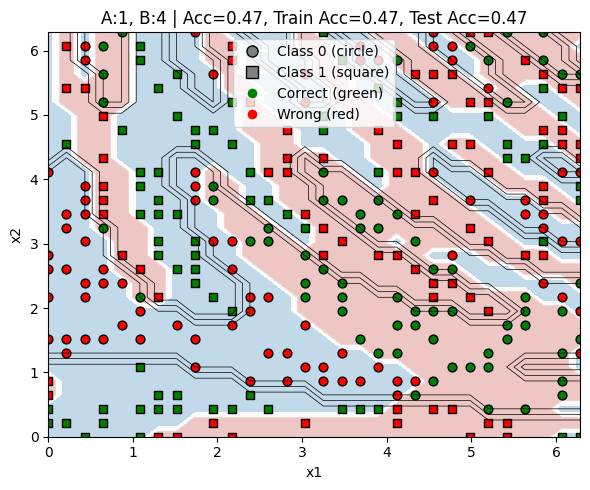

 25%|██▌       | 1/4 [09:56<29:50, 596.73s/it]

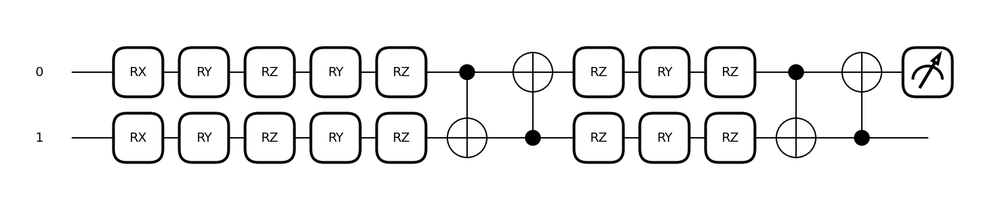

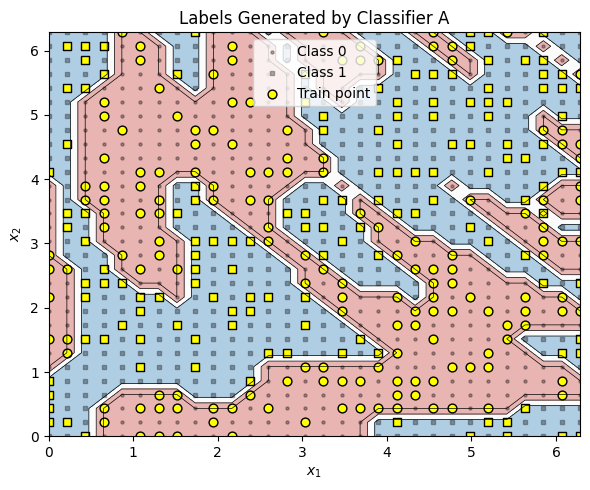

Training B(depth=1) on data from A(depth=2)
Total Accuracy: 0.48777777777777775
Train Accuracy: 0.46
Test Accuracy: 0.5016666666666667
Test Precision: 0.5168539325842697
Test Recall: 0.44805194805194803
Test F1: 0.48
Time taken: 78.1365852355957


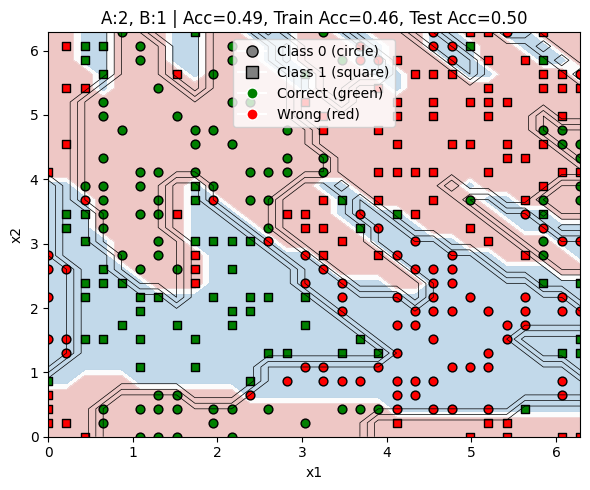

Training B(depth=2) on data from A(depth=2)
Total Accuracy: 0.54
Train Accuracy: 0.5233333333333333
Test Accuracy: 0.5483333333333333
Test Precision: 0.5658362989323843
Test Recall: 0.5162337662337663
Test F1: 0.5398981324278438
Time taken: 123.6063003540039


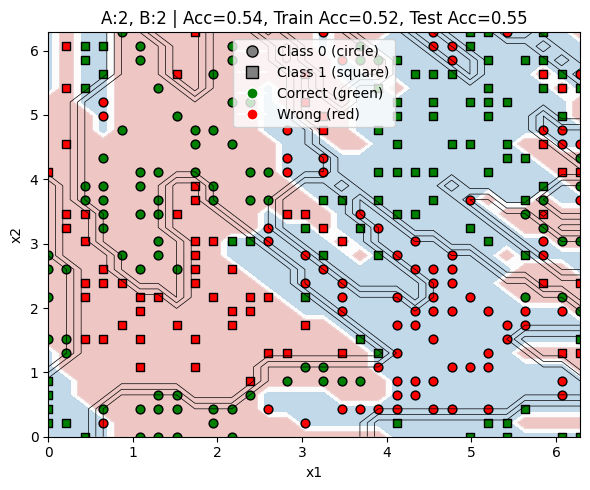

Training B(depth=3) on data from A(depth=2)
Total Accuracy: 0.5477777777777778
Train Accuracy: 0.54
Test Accuracy: 0.5516666666666666
Test Precision: 0.568904593639576
Test Recall: 0.5227272727272727
Test F1: 0.544839255499154
Time taken: 172.05938625335693


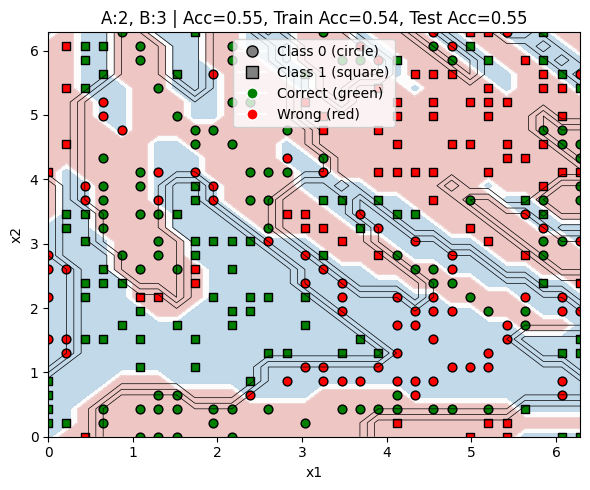

Training B(depth=4) on data from A(depth=2)
Total Accuracy: 0.5866666666666667
Train Accuracy: 0.61
Test Accuracy: 0.575
Test Precision: 0.5985130111524164
Test Recall: 0.5227272727272727
Test F1: 0.5580589254766031
Time taken: 218.91715121269226


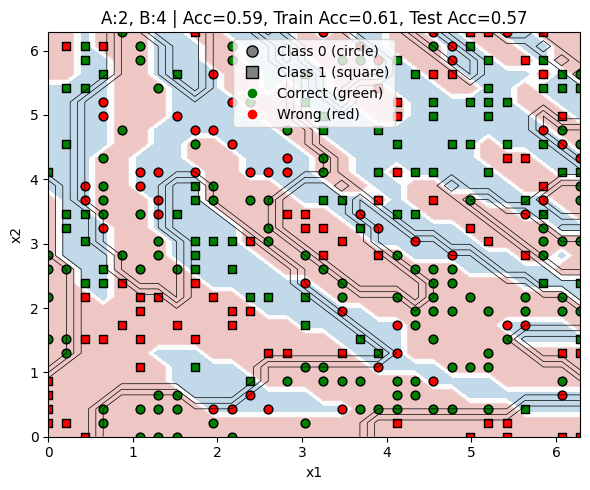

 50%|█████     | 2/4 [19:55<19:55, 597.74s/it]

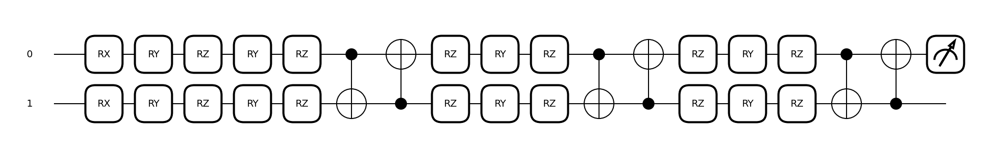

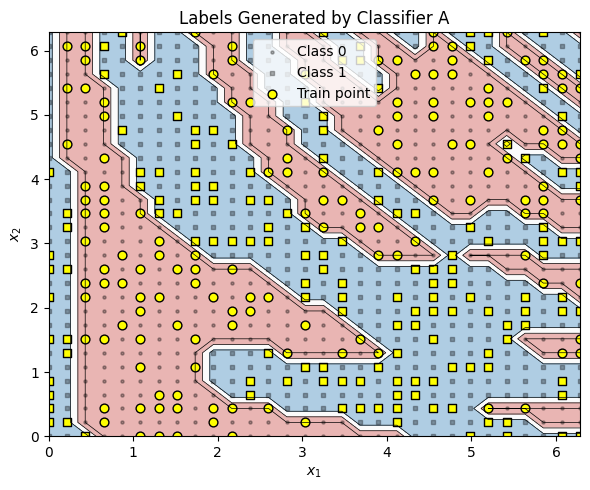

Training B(depth=1) on data from A(depth=3)
Total Accuracy: 0.42444444444444446
Train Accuracy: 0.4266666666666667
Test Accuracy: 0.42333333333333334
Test Precision: 0.43492063492063493
Test Recall: 0.4491803278688525
Test F1: 0.4419354838709678
Time taken: 77.97055578231812


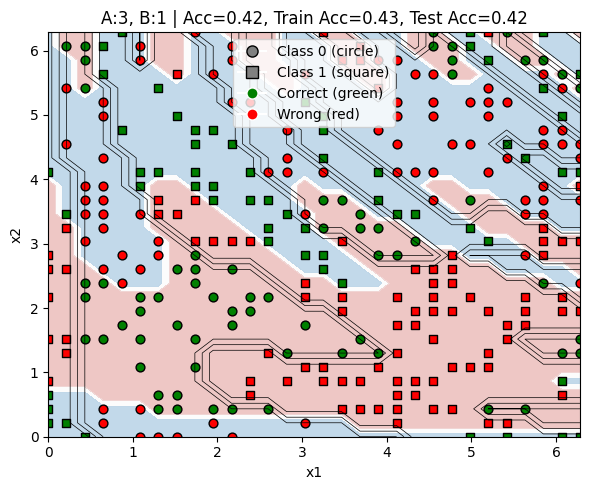

Training B(depth=2) on data from A(depth=3)
Total Accuracy: 0.6055555555555555
Train Accuracy: 0.5733333333333334
Test Accuracy: 0.6216666666666667
Test Precision: 0.625
Test Recall: 0.639344262295082
Test F1: 0.6320907617504052
Time taken: 124.08730936050415


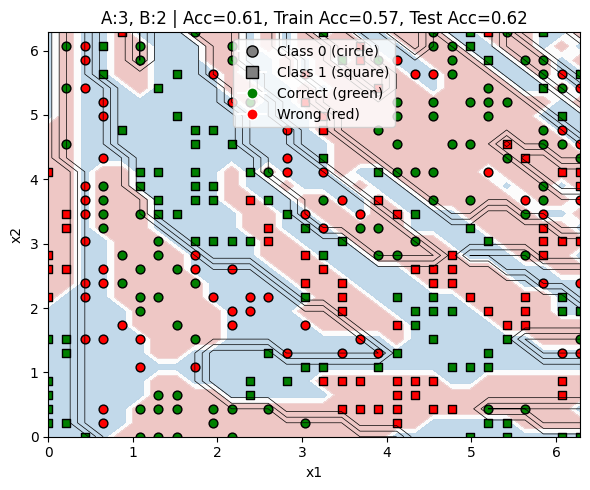

Training B(depth=3) on data from A(depth=3)
Total Accuracy: 0.73
Train Accuracy: 0.7466666666666667
Test Accuracy: 0.7216666666666667
Test Precision: 0.724025974025974
Test Recall: 0.7311475409836066
Test F1: 0.7275693311582382
Time taken: 169.9377510547638


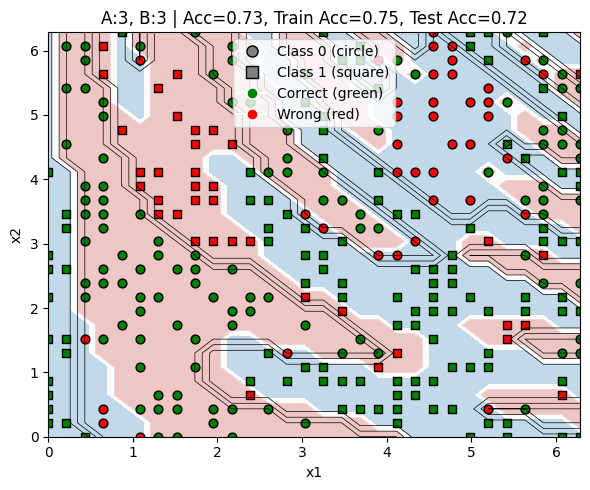

Training B(depth=4) on data from A(depth=3)
Total Accuracy: 0.5355555555555556
Train Accuracy: 0.5466666666666666
Test Accuracy: 0.53
Test Precision: 0.5387205387205387
Test Recall: 0.5245901639344263
Test F1: 0.5315614617940201
Time taken: 218.77718949317932


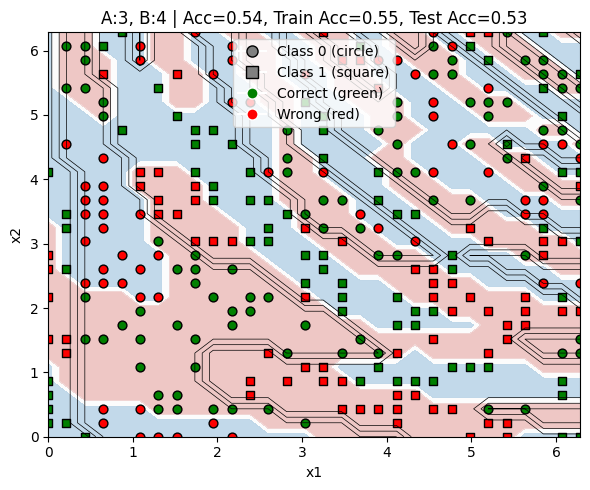

 75%|███████▌  | 3/4 [29:52<09:57, 597.52s/it]

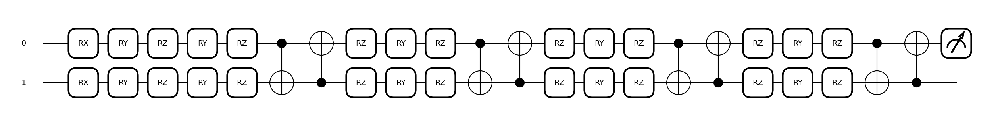

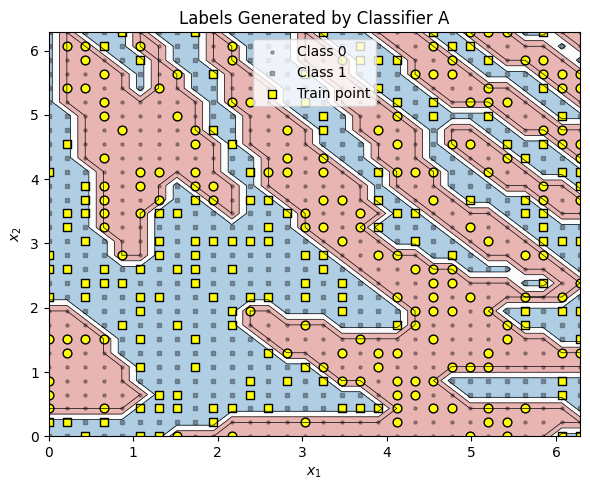

Training B(depth=1) on data from A(depth=4)
Total Accuracy: 0.6077777777777778
Train Accuracy: 0.6166666666666667
Test Accuracy: 0.6033333333333334
Test Precision: 0.5905797101449275
Test Recall: 0.5659722222222222
Test F1: 0.5780141843971631
Time taken: 78.14000797271729


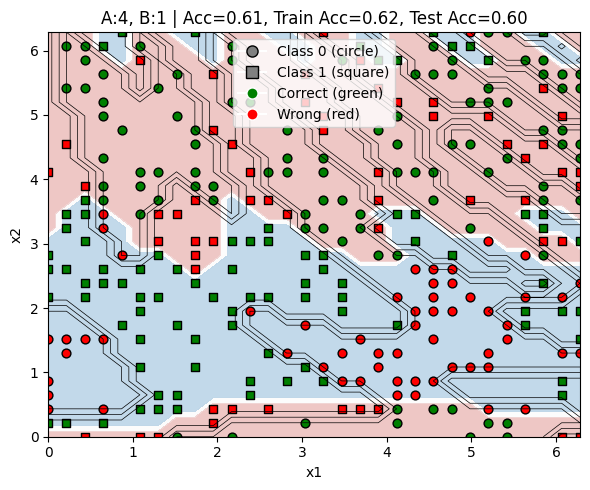

Training B(depth=2) on data from A(depth=4)
Total Accuracy: 0.5455555555555556
Train Accuracy: 0.5966666666666667
Test Accuracy: 0.52
Test Precision: 0.5
Test Recall: 0.5208333333333334
Test F1: 0.5102040816326531
Time taken: 124.49060392379761


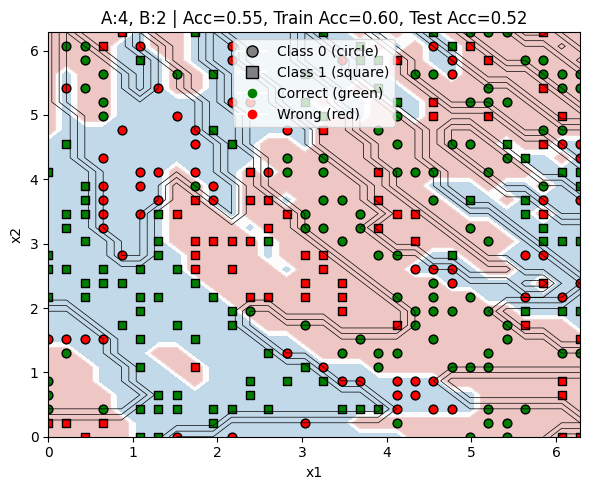

Training B(depth=3) on data from A(depth=4)
Total Accuracy: 0.5666666666666667
Train Accuracy: 0.5466666666666666
Test Accuracy: 0.5766666666666667
Test Precision: 0.5551948051948052
Test Recall: 0.59375
Test F1: 0.5738255033557047
Time taken: 171.17972540855408


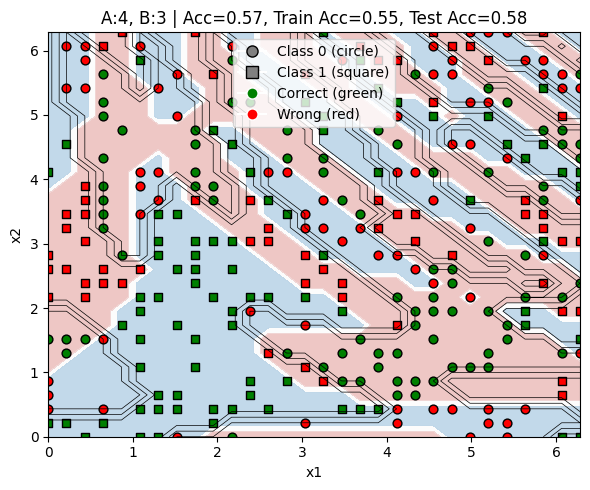

Training B(depth=4) on data from A(depth=4)
Total Accuracy: 0.5944444444444444
Train Accuracy: 0.5766666666666667
Test Accuracy: 0.6033333333333334
Test Precision: 0.5838926174496645
Test Recall: 0.6041666666666666
Test F1: 0.5938566552901023
Time taken: 219.06135320663452


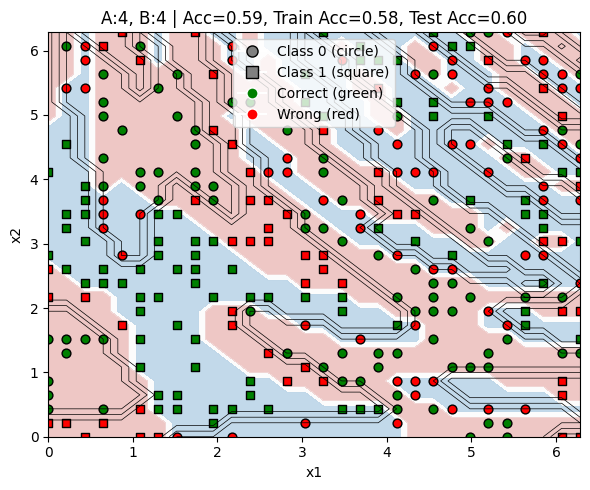

100%|██████████| 4/4 [39:52<00:00, 598.18s/it]


In [22]:

for depth_A in tqdm(depths):
    # Generate labels using fixed A
    devA = qml.device("default.qubit", wires=n_qubits)
    weights_A = np.random.uniform(0, 2*np.pi, size=(depth_A, n_qubits, 3))
    circuit_A = create_qnode(depth_A, weights_A, devA)
    labels_A = generate_labels(circuit_A, inputs)
    y_train = torch.tensor(labels_A[train_idx], dtype=torch.float32).unsqueeze(1)
    y_test = torch.tensor(labels_A[test_idx], dtype=torch.float32).unsqueeze(1)
    qml.drawer.draw_mpl(circuit_A)([0, 1]);
    plot_generator_A(labels_A, "Labels Generated by Classifier A", X=inputs, train_idx=train_idx)
    
    for depth_B in tqdm(depths):
        print(f"Training B(depth={depth_B}) on data from A(depth={depth_A})")
        devB = qml.device("default.qubit", wires=n_qubits)
        model_B = get_torch_model(depth_B, devB)
        start_time = time.time()
        trained_model = train_model(model_B, X_train, y_train,epochs = 100, lr = 0.001)

        # Evaluate model
        with torch.no_grad():
            preds = torch.stack([trained_model(x) for x in torch.tensor(inputs, dtype=torch.float32)]).numpy().flatten()
            pred_labels = (preds > 0).astype(int)
            
        train_preds = pred_labels[train_idx]
        test_preds = pred_labels[test_idx]
        
        acc = accuracy_score(labels_A, pred_labels)
        train_acc = accuracy_score(labels_A[train_idx], train_preds)
        test_acc = accuracy_score(labels_A[test_idx], test_preds)
        precision = precision_score(labels_A[test_idx], test_preds)
        recall = recall_score(labels_A[test_idx], test_preds)
        f1 = f1_score(labels_A[test_idx], test_preds)
        # Plot
        title = f"A:{depth_A}, B:{depth_B} | Acc={acc:.2f}, Train Acc={train_acc:.2f}, Test Acc={test_acc:.2f}"
        print("Total Accuracy:", acc)
        print("Train Accuracy:", train_acc)
        print("Test Accuracy:", test_acc)
        print("Test Precision:", precision)
        print("Test Recall:", recall)
        print("Test F1:", f1)
        print("Time taken:", time.time() - start_time)
        results.append((depth_A, depth_B, acc, train_acc, test_acc))
        plot_results(labels_A, pred_labels, title, inputs, train_idx)
        




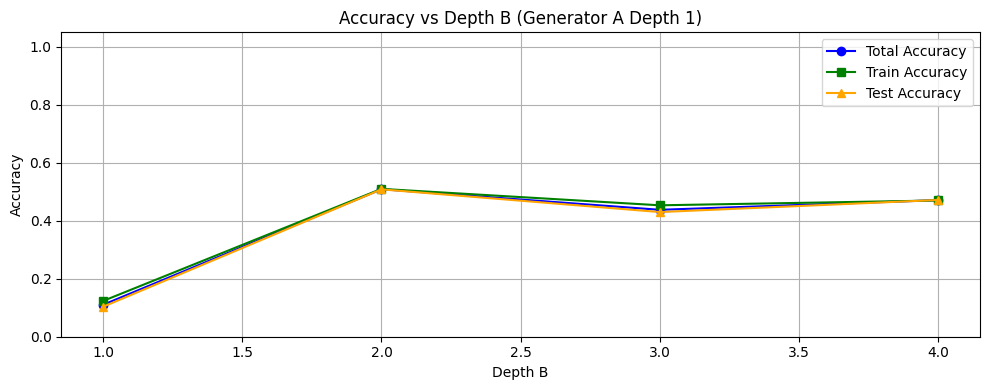

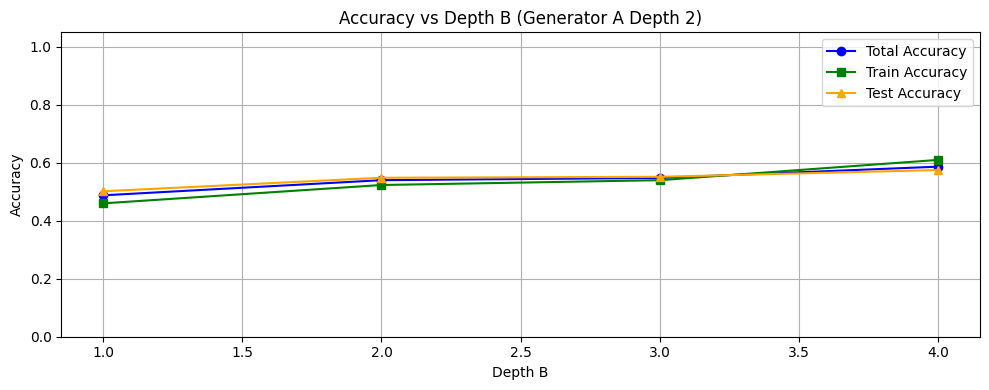

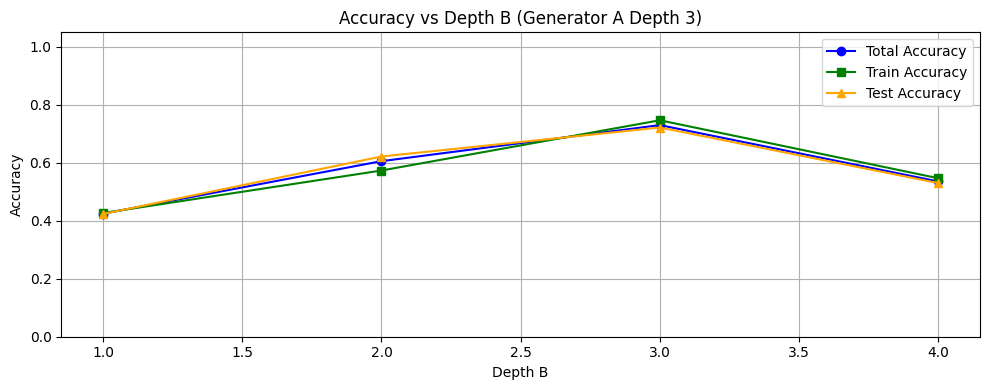

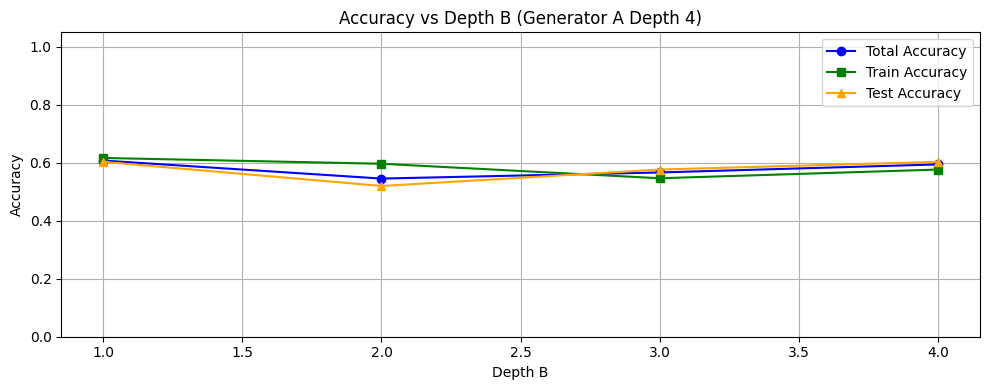

In [23]:

# Convert results to a DataFrame for easier filtering
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


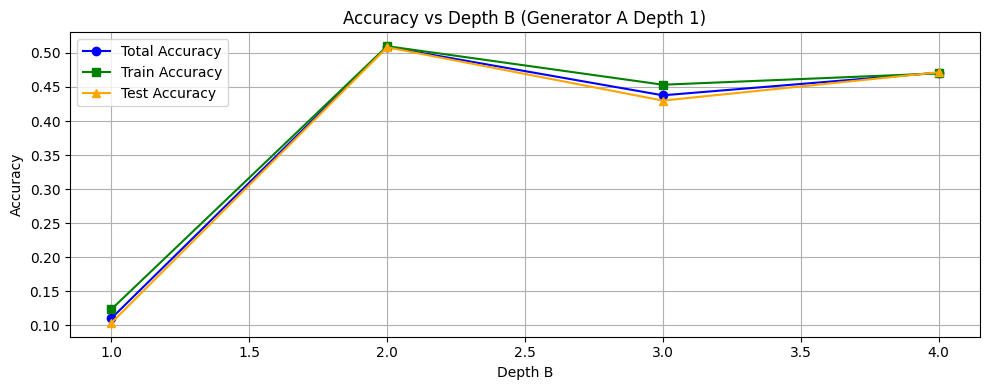

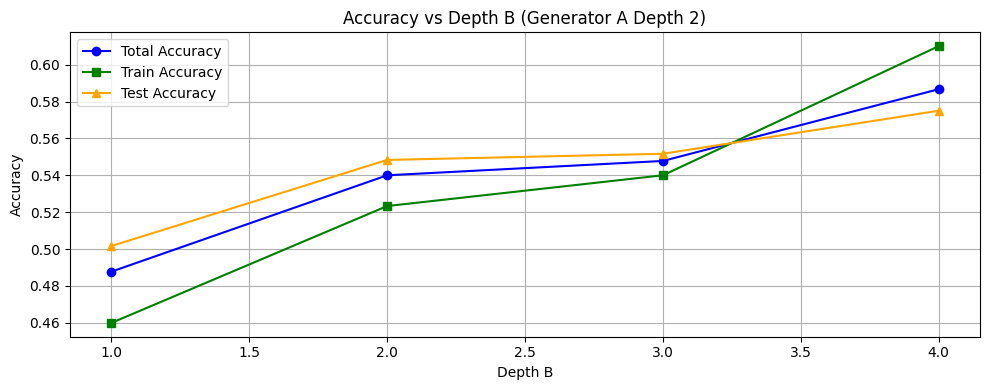

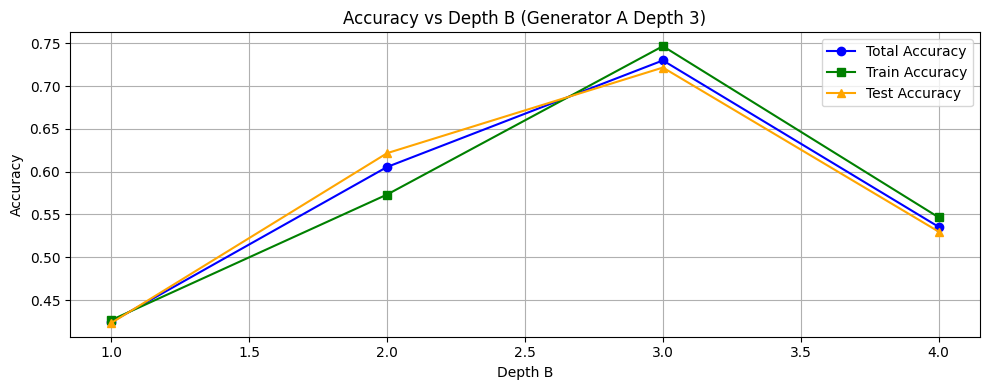

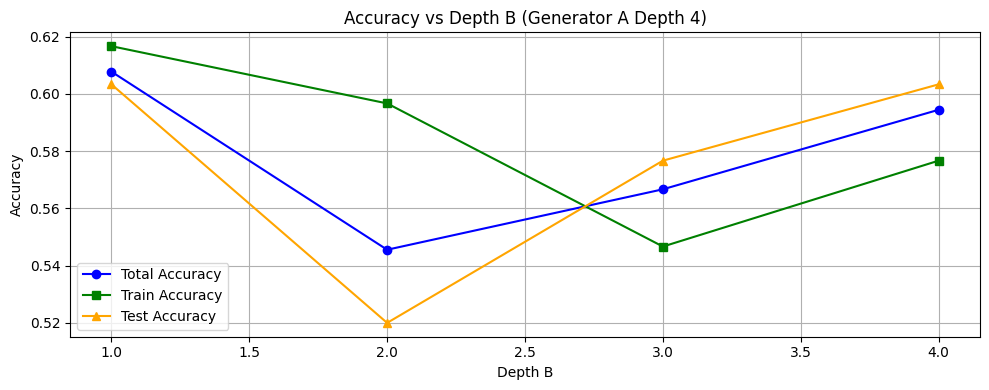

In [24]:
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    # plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

# 50 Epochs LR = 0.001

In [25]:
torch.manual_seed(42)
np.random.seed(42)
# Main experiment
depths = [1, 2, 3, 4]
train_idx = np.random.choice(len(inputs), size=300, replace=False)
X_train = torch.tensor(inputs[train_idx], dtype=torch.float32)

results = []


  0%|          | 0/4 [00:00<?, ?it/s]

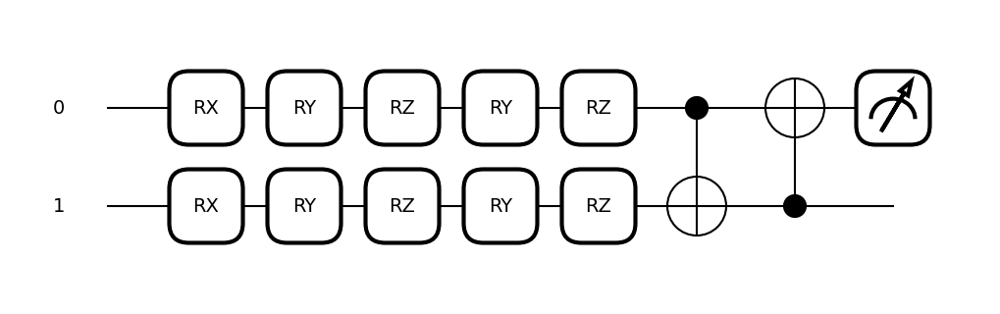

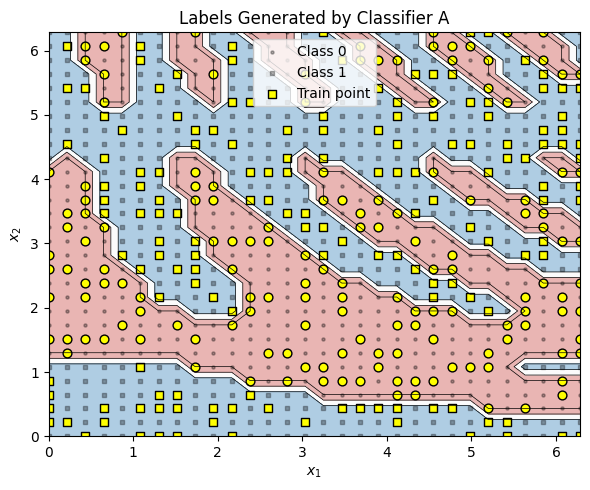

Training B(depth=1) on data from A(depth=1)
Total Accuracy: 0.08777777777777777
Train Accuracy: 0.1
Test Accuracy: 0.08166666666666667
Test Precision: 0.08955223880597014
Test Recall: 0.07250755287009064
Test F1: 0.08013355592654425
Time taken: 40.10826563835144


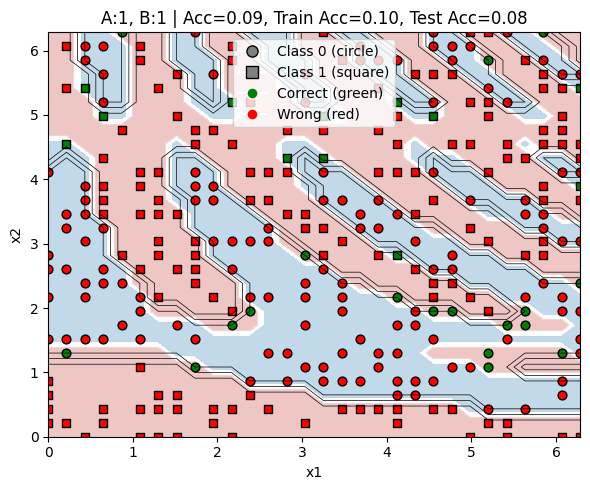

Training B(depth=2) on data from A(depth=1)
Total Accuracy: 0.5111111111111111
Train Accuracy: 0.51
Test Accuracy: 0.5116666666666667
Test Precision: 0.5565476190476191
Test Recall: 0.5649546827794562
Test F1: 0.5607196401799099
Time taken: 63.363067626953125


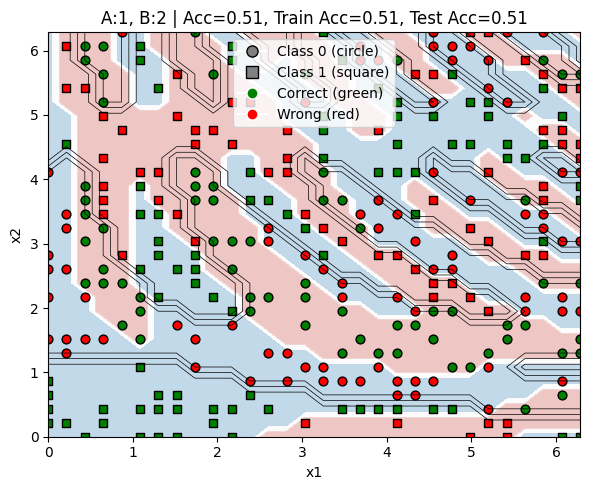

Training B(depth=3) on data from A(depth=1)
Total Accuracy: 0.4066666666666667
Train Accuracy: 0.41
Test Accuracy: 0.405
Test Precision: 0.4588607594936709
Test Recall: 0.4380664652567976
Test F1: 0.4482225656877898
Time taken: 87.02224779129028


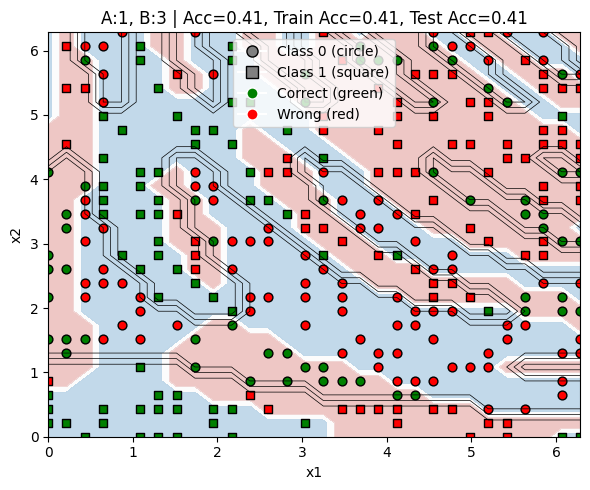

Training B(depth=4) on data from A(depth=1)
Total Accuracy: 0.44222222222222224
Train Accuracy: 0.43
Test Accuracy: 0.4483333333333333
Test Precision: 0.5
Test Recall: 0.48942598187311176
Test F1: 0.49465648854961836
Time taken: 110.4125440120697


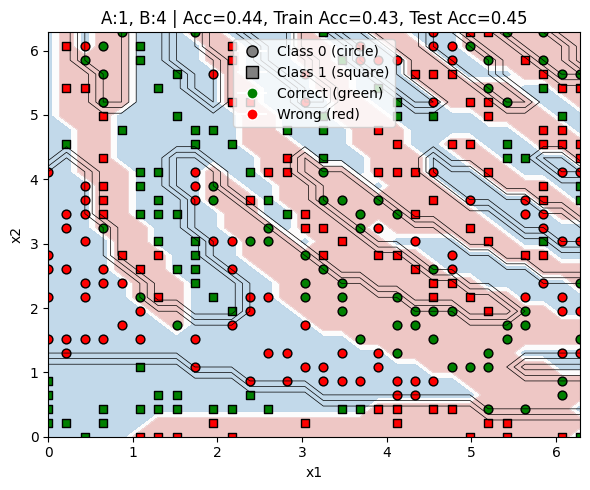

 25%|██▌       | 1/4 [05:06<15:18, 306.15s/it]

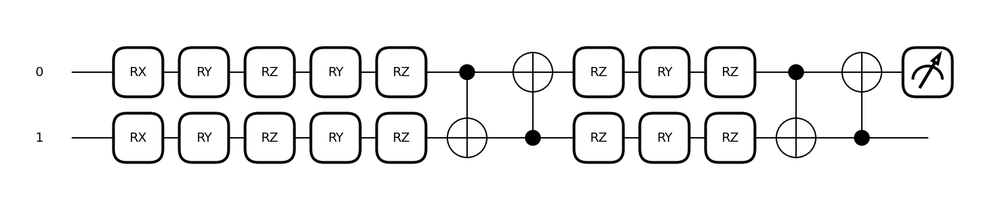

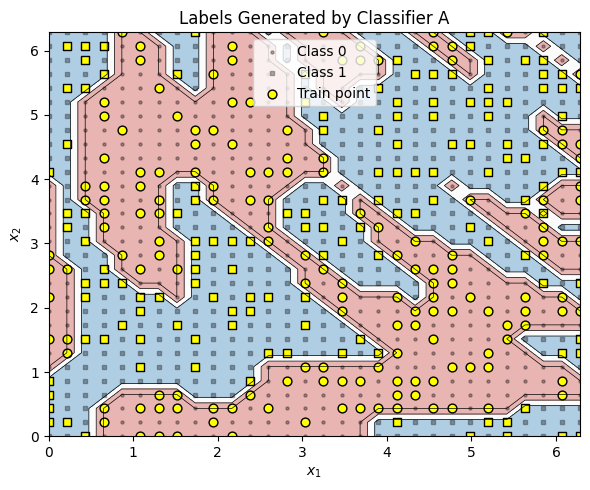

Training B(depth=1) on data from A(depth=2)
Total Accuracy: 0.48777777777777775
Train Accuracy: 0.45
Test Accuracy: 0.5066666666666667
Test Precision: 0.5223880597014925
Test Recall: 0.45454545454545453
Test F1: 0.48611111111111105
Time taken: 40.21623992919922


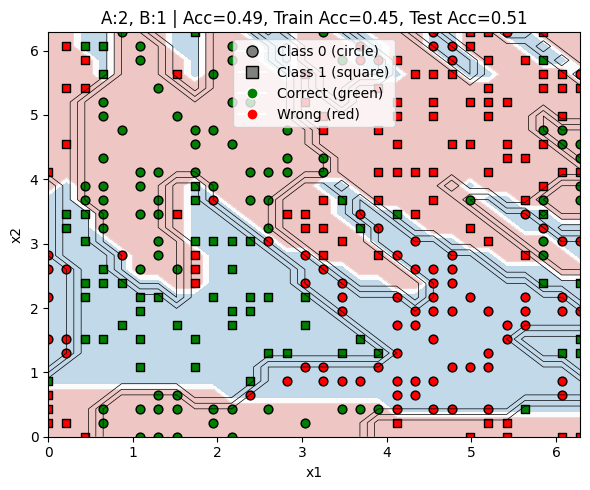

Training B(depth=2) on data from A(depth=2)
Total Accuracy: 0.5355555555555556
Train Accuracy: 0.52
Test Accuracy: 0.5433333333333333
Test Precision: 0.5594405594405595
Test Recall: 0.5194805194805194
Test F1: 0.5387205387205387
Time taken: 63.506941080093384


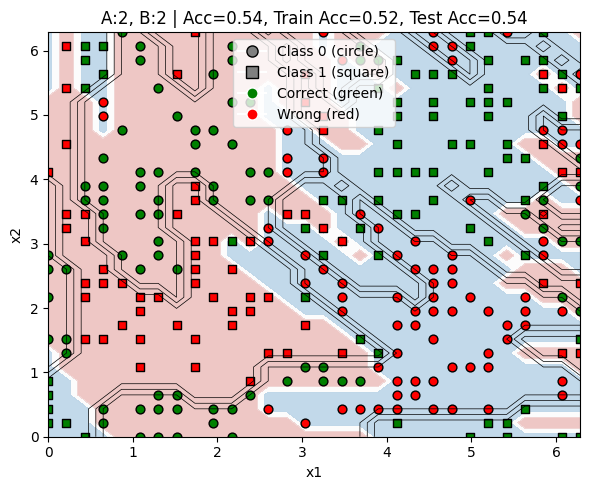

Training B(depth=3) on data from A(depth=2)
Total Accuracy: 0.5044444444444445
Train Accuracy: 0.5066666666666667
Test Accuracy: 0.5033333333333333
Test Precision: 0.5176056338028169
Test Recall: 0.4772727272727273
Test F1: 0.4966216216216216
Time taken: 87.61718916893005


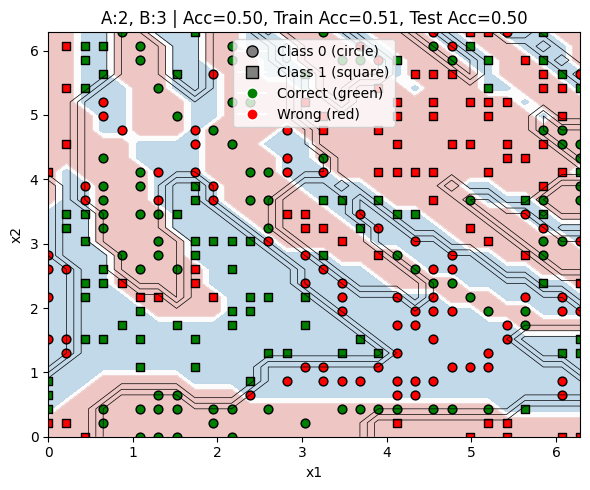

Training B(depth=4) on data from A(depth=2)
Total Accuracy: 0.5477777777777778
Train Accuracy: 0.5633333333333334
Test Accuracy: 0.54
Test Precision: 0.5606060606060606
Test Recall: 0.4805194805194805
Test F1: 0.5174825174825174
Time taken: 110.45856809616089


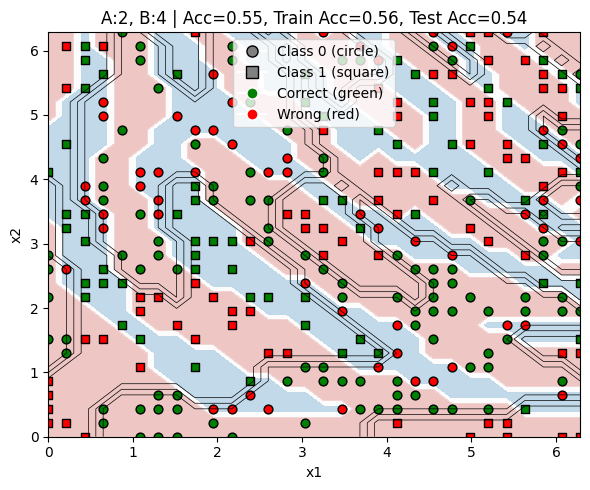

 50%|█████     | 2/4 [10:13<10:13, 306.97s/it]

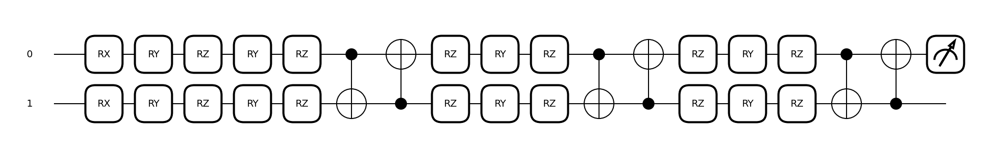

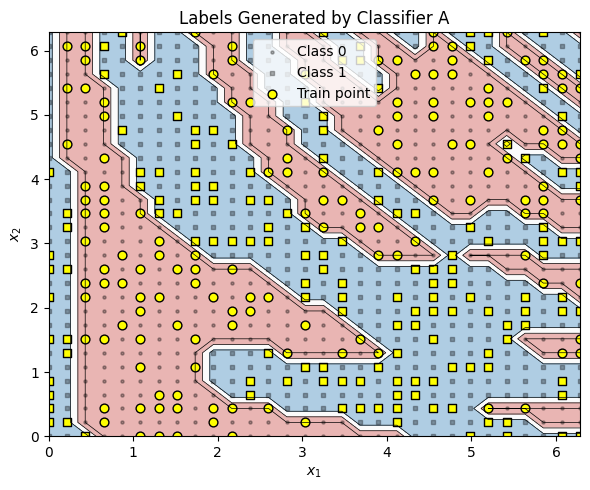

Training B(depth=1) on data from A(depth=3)
Total Accuracy: 0.4288888888888889
Train Accuracy: 0.42
Test Accuracy: 0.43333333333333335
Test Precision: 0.4440894568690096
Test Recall: 0.4557377049180328
Test F1: 0.44983818770226536
Time taken: 39.74005746841431


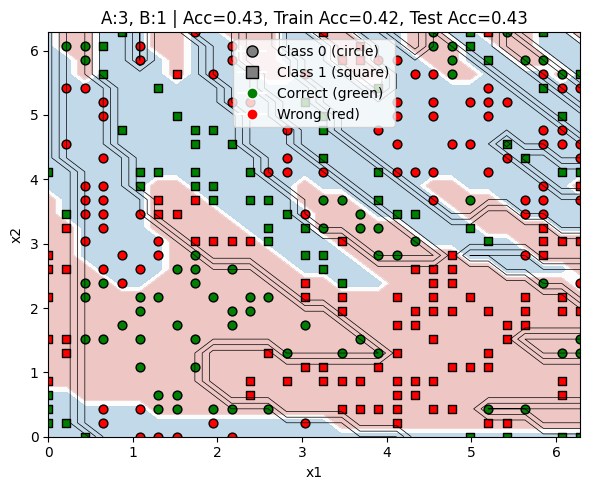

Training B(depth=2) on data from A(depth=3)
Total Accuracy: 0.5922222222222222
Train Accuracy: 0.56
Test Accuracy: 0.6083333333333333
Test Precision: 0.610062893081761
Test Recall: 0.6360655737704918
Test F1: 0.6227929373996789
Time taken: 63.812700271606445


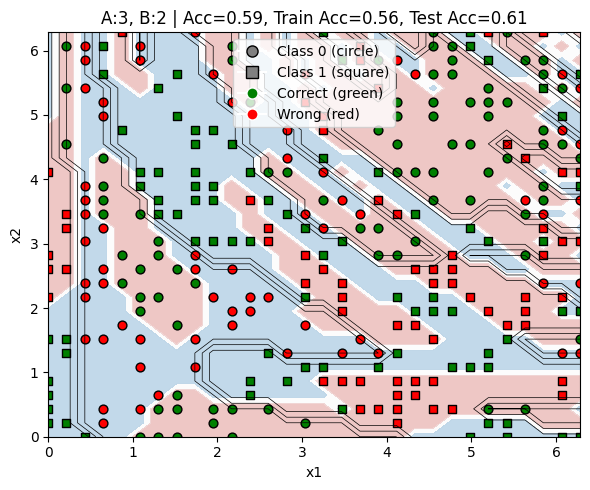

Training B(depth=3) on data from A(depth=3)
Total Accuracy: 0.6977777777777778
Train Accuracy: 0.7166666666666667
Test Accuracy: 0.6883333333333334
Test Precision: 0.6903225806451613
Test Recall: 0.7016393442622951
Test F1: 0.6959349593495935
Time taken: 87.76657199859619


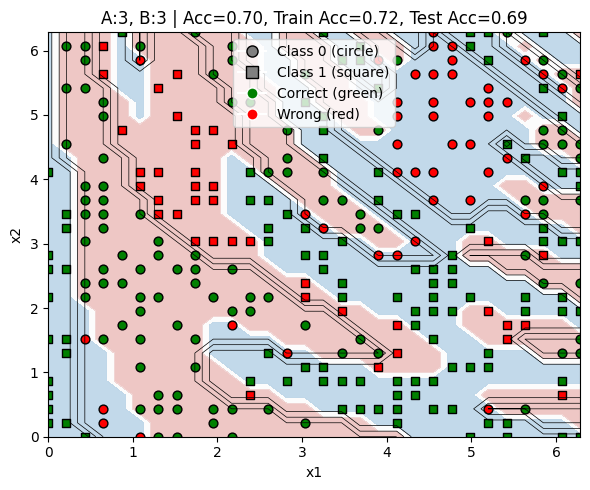

Training B(depth=4) on data from A(depth=3)
Total Accuracy: 0.4577777777777778
Train Accuracy: 0.46
Test Accuracy: 0.45666666666666667
Test Precision: 0.46534653465346537
Test Recall: 0.46229508196721314
Test F1: 0.4638157894736843
Time taken: 111.14410853385925


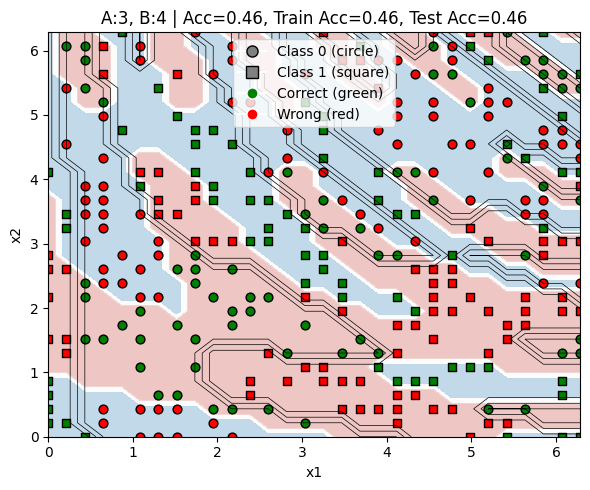

 75%|███████▌  | 3/4 [15:22<05:07, 307.88s/it]

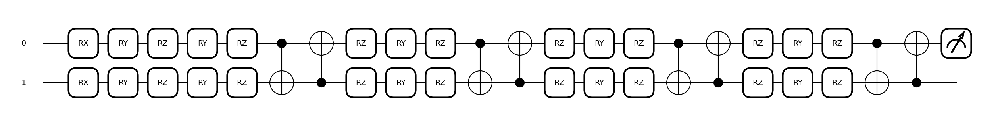

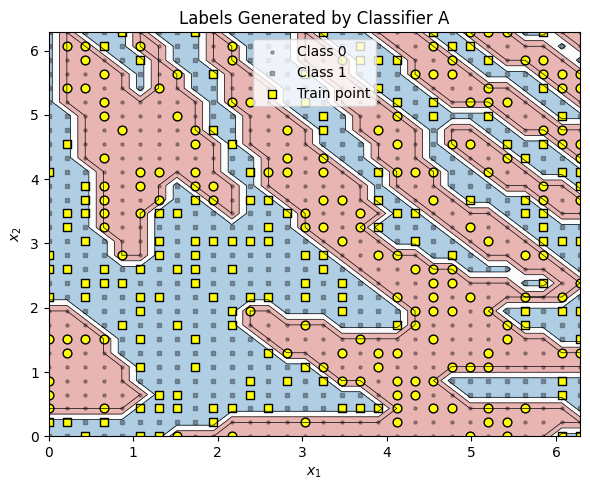

Training B(depth=1) on data from A(depth=4)
Total Accuracy: 0.5955555555555555
Train Accuracy: 0.6166666666666667
Test Accuracy: 0.585
Test Precision: 0.5652173913043478
Test Recall: 0.5868055555555556
Test F1: 0.575809199318569
Time taken: 39.760085105895996


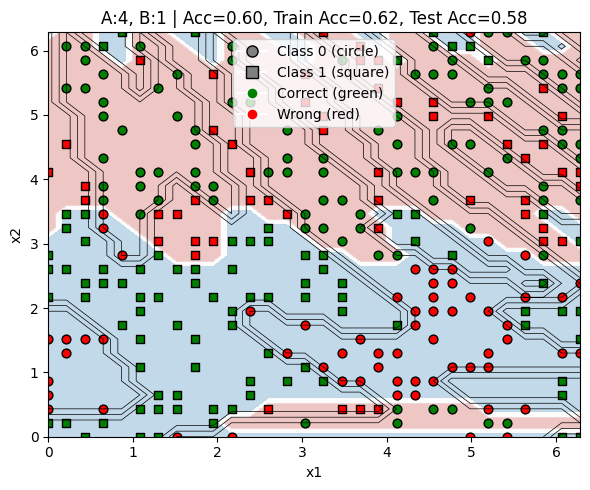

Training B(depth=2) on data from A(depth=4)
Total Accuracy: 0.5177777777777778
Train Accuracy: 0.5733333333333334
Test Accuracy: 0.49
Test Precision: 0.46853146853146854
Test Recall: 0.4652777777777778
Test F1: 0.46689895470383275
Time taken: 63.13752484321594


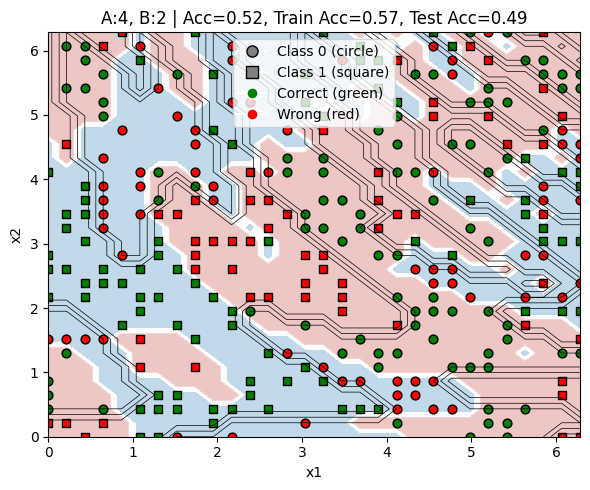

Training B(depth=3) on data from A(depth=4)
Total Accuracy: 0.5444444444444444
Train Accuracy: 0.5333333333333333
Test Accuracy: 0.55
Test Precision: 0.5288461538461539
Test Recall: 0.5729166666666666
Test F1: 0.5499999999999999
Time taken: 86.34169363975525


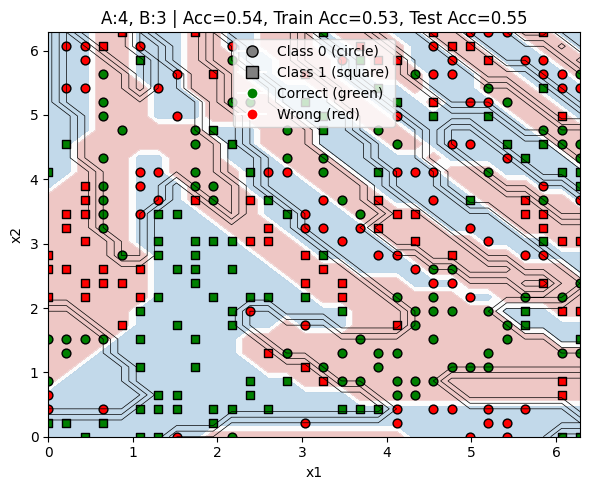

Training B(depth=4) on data from A(depth=4)
Total Accuracy: 0.5155555555555555
Train Accuracy: 0.48333333333333334
Test Accuracy: 0.5316666666666666
Test Precision: 0.511400651465798
Test Recall: 0.5451388888888888
Test F1: 0.5277310924369748
Time taken: 112.77309155464172


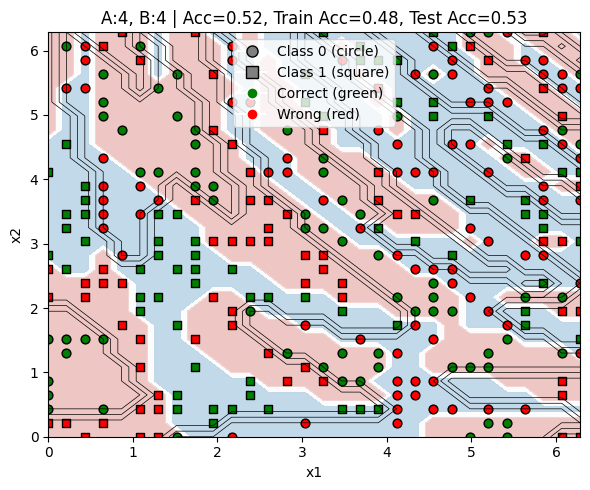

100%|██████████| 4/4 [20:32<00:00, 308.05s/it]


In [26]:

for depth_A in tqdm(depths):
    # Generate labels using fixed A
    devA = qml.device("default.qubit", wires=n_qubits)
    weights_A = np.random.uniform(0, 2*np.pi, size=(depth_A, n_qubits, 3))
    circuit_A = create_qnode(depth_A, weights_A, devA)
    labels_A = generate_labels(circuit_A, inputs)
    y_train = torch.tensor(labels_A[train_idx], dtype=torch.float32).unsqueeze(1)
    y_test = torch.tensor(labels_A[test_idx], dtype=torch.float32).unsqueeze(1)
    qml.drawer.draw_mpl(circuit_A)([0, 1]);
    plot_generator_A(labels_A, "Labels Generated by Classifier A", X=inputs, train_idx=train_idx)
    
    for depth_B in tqdm(depths):
        print(f"Training B(depth={depth_B}) on data from A(depth={depth_A})")
        devB = qml.device("default.qubit", wires=n_qubits)
        model_B = get_torch_model(depth_B, devB)
        start_time = time.time()
        trained_model = train_model(model_B, X_train, y_train,epochs = 50, lr = 0.001)

        # Evaluate model
        with torch.no_grad():
            preds = torch.stack([trained_model(x) for x in torch.tensor(inputs, dtype=torch.float32)]).numpy().flatten()
            pred_labels = (preds > 0).astype(int)
            
        train_preds = pred_labels[train_idx]
        test_preds = pred_labels[test_idx]
        
        acc = accuracy_score(labels_A, pred_labels)
        train_acc = accuracy_score(labels_A[train_idx], train_preds)
        test_acc = accuracy_score(labels_A[test_idx], test_preds)
        precision = precision_score(labels_A[test_idx], test_preds)
        recall = recall_score(labels_A[test_idx], test_preds)
        f1 = f1_score(labels_A[test_idx], test_preds)
        # Plot
        title = f"A:{depth_A}, B:{depth_B} | Acc={acc:.2f}, Train Acc={train_acc:.2f}, Test Acc={test_acc:.2f}"
        print("Total Accuracy:", acc)
        print("Train Accuracy:", train_acc)
        print("Test Accuracy:", test_acc)
        print("Test Precision:", precision)
        print("Test Recall:", recall)
        print("Test F1:", f1)
        print("Time taken:", time.time() - start_time)
        results.append((depth_A, depth_B, acc, train_acc, test_acc))
        plot_results(labels_A, pred_labels, title, inputs, train_idx)
        




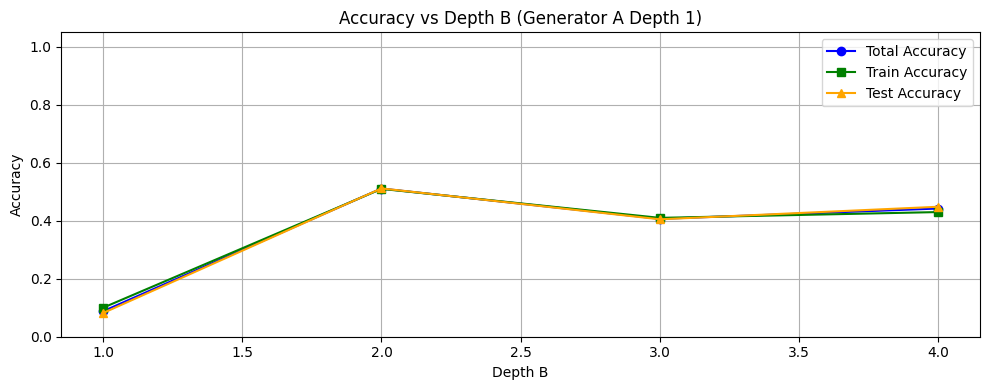

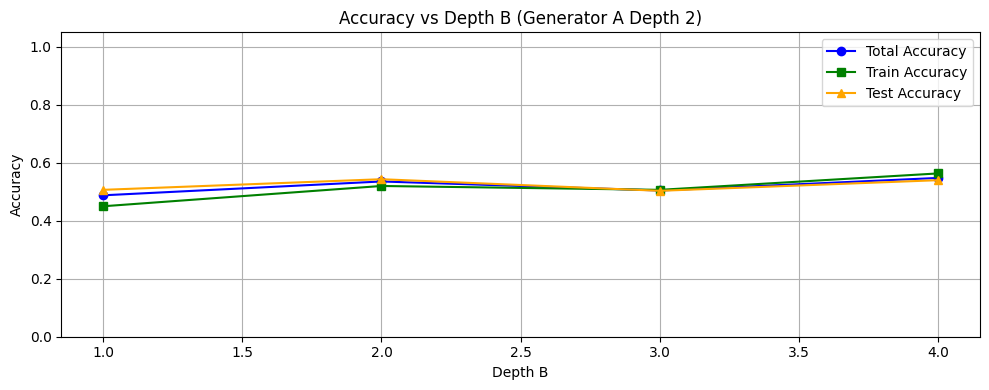

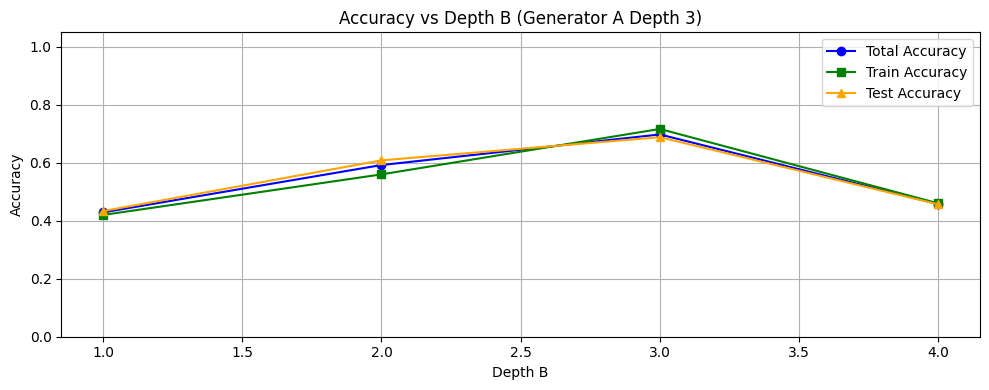

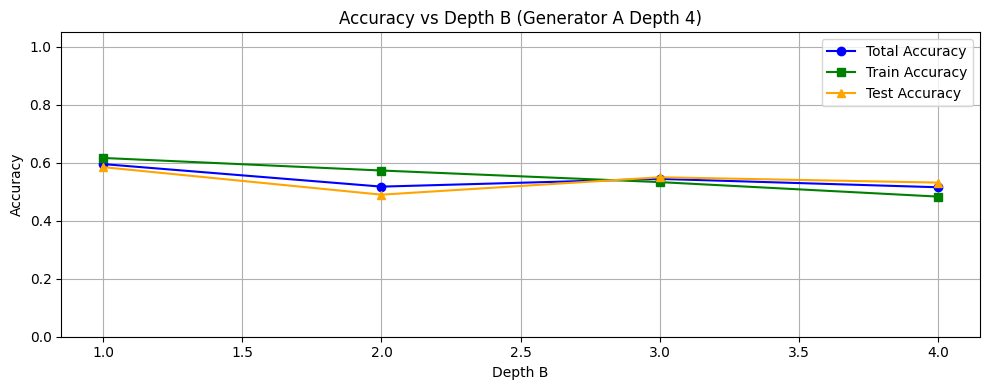

In [27]:

# Convert results to a DataFrame for easier filtering
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


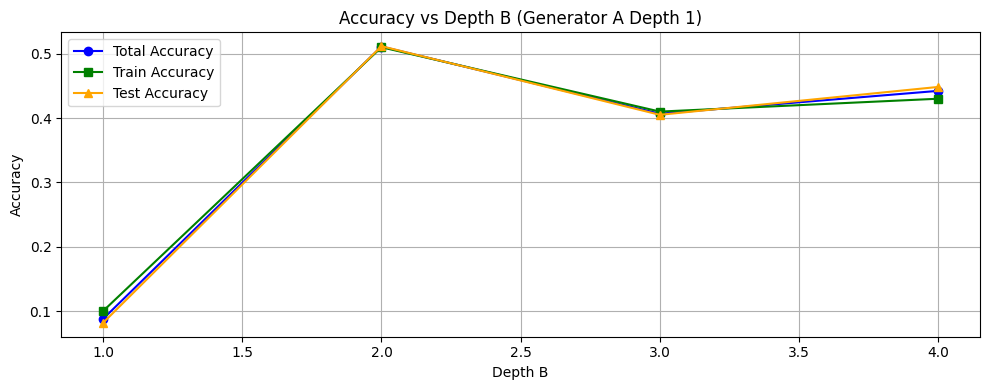

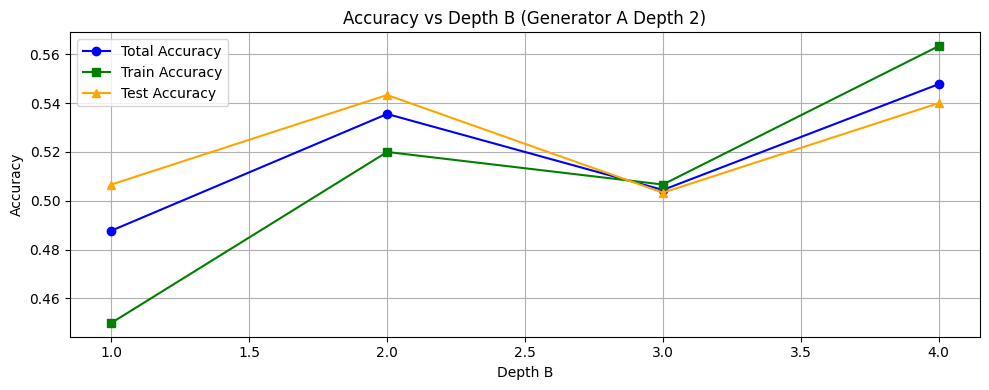

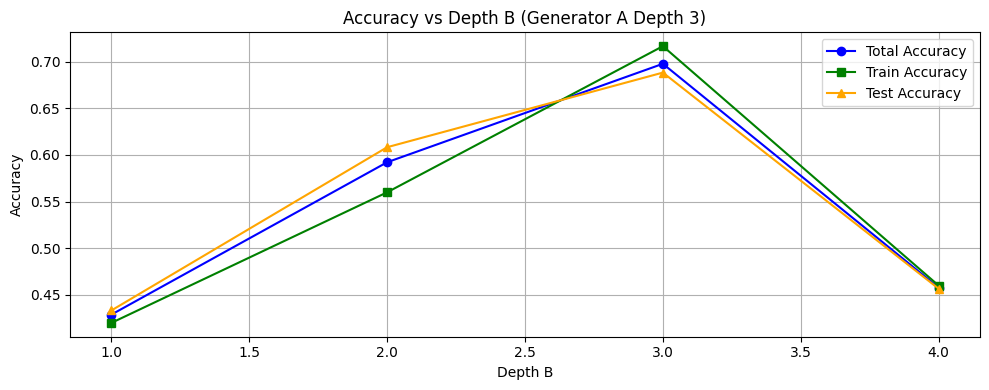

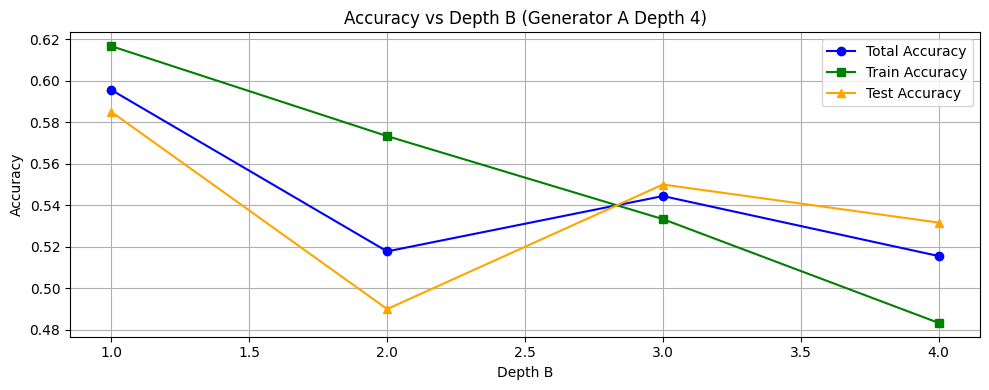

In [28]:
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    # plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

# 200 Epochs LR = 0.001

In [29]:
torch.manual_seed(42)
np.random.seed(42)
# Main experiment
depths = [1, 2, 3, 4]
train_idx = np.random.choice(len(inputs), size=300, replace=False)
X_train = torch.tensor(inputs[train_idx], dtype=torch.float32)

results = []


  0%|          | 0/4 [00:00<?, ?it/s]

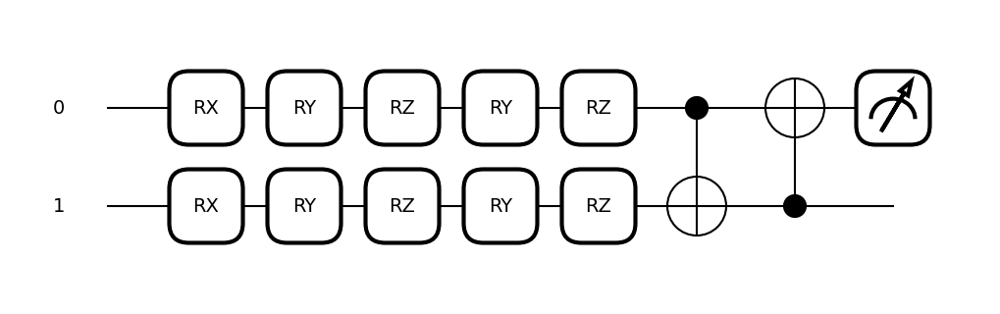

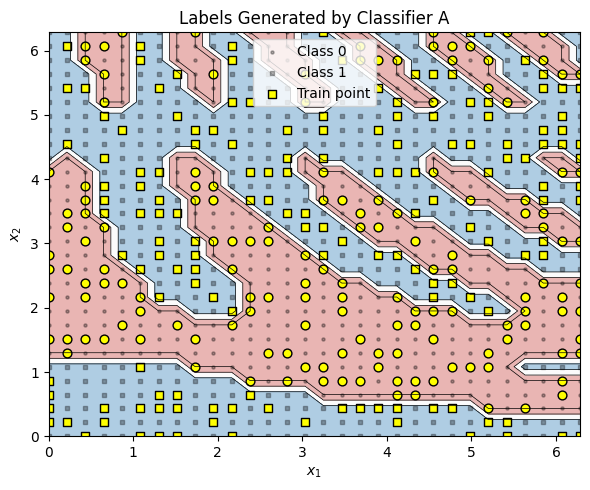

Training B(depth=1) on data from A(depth=1)
Total Accuracy: 0.17666666666666667
Train Accuracy: 0.22333333333333333
Test Accuracy: 0.15333333333333332
Test Precision: 0.16853932584269662
Test Recall: 0.13595166163141995
Test F1: 0.1505016722408027
Time taken: 155.63475584983826


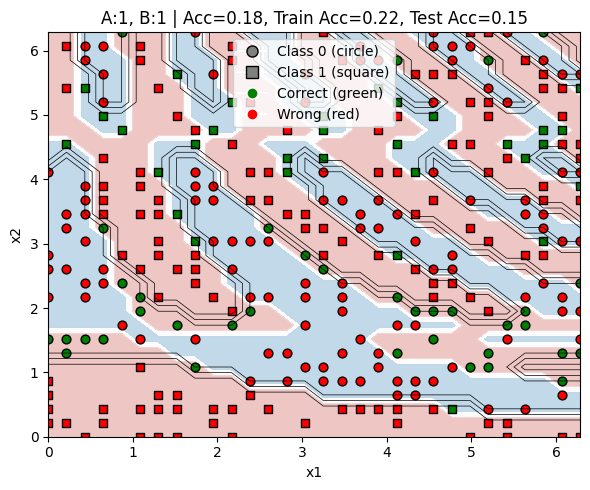

Training B(depth=2) on data from A(depth=1)
Total Accuracy: 0.5166666666666667
Train Accuracy: 0.5133333333333333
Test Accuracy: 0.5183333333333333
Test Precision: 0.5636363636363636
Test Recall: 0.5619335347432024
Test F1: 0.5627836611195159
Time taken: 247.72051191329956


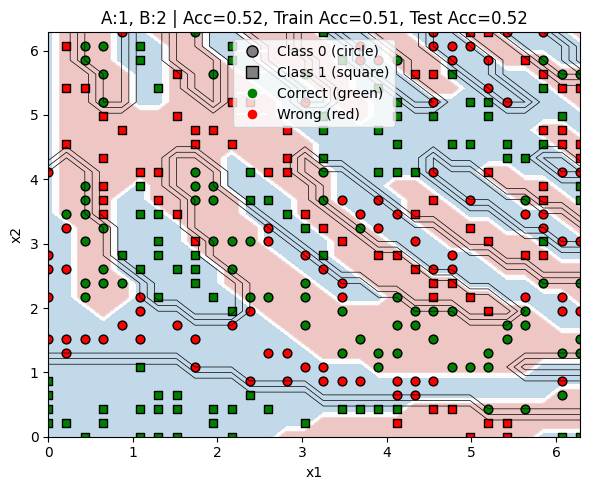

Training B(depth=3) on data from A(depth=1)
Total Accuracy: 0.46444444444444444
Train Accuracy: 0.4666666666666667
Test Accuracy: 0.4633333333333333
Test Precision: 0.5139318885448917
Test Recall: 0.5015105740181269
Test F1: 0.5076452599388379
Time taken: 340.05440187454224


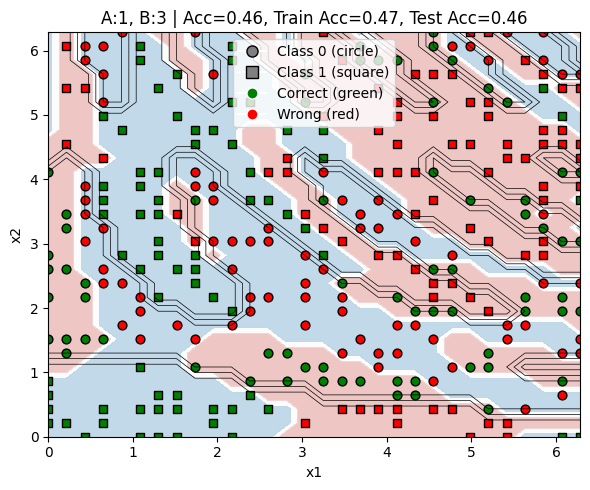

Training B(depth=4) on data from A(depth=1)
Total Accuracy: 0.5511111111111111
Train Accuracy: 0.5633333333333334
Test Accuracy: 0.545
Test Precision: 0.5900621118012422
Test Recall: 0.5740181268882175
Test F1: 0.5819295558958651
Time taken: 433.31691670417786


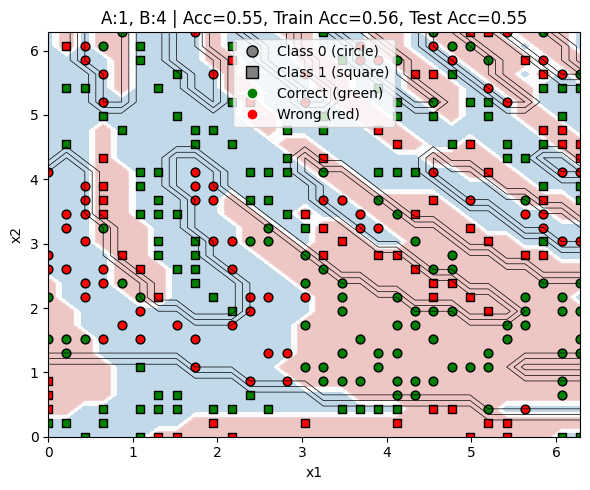

 25%|██▌       | 1/4 [19:41<59:05, 1181.84s/it]

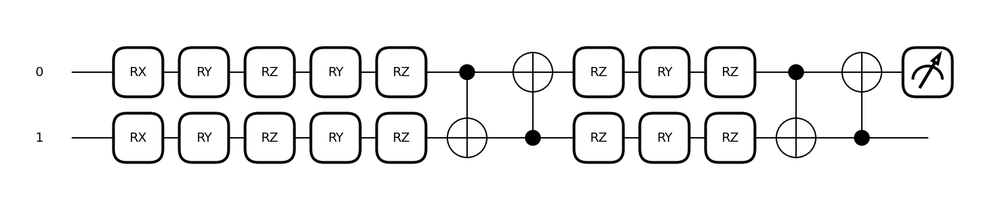

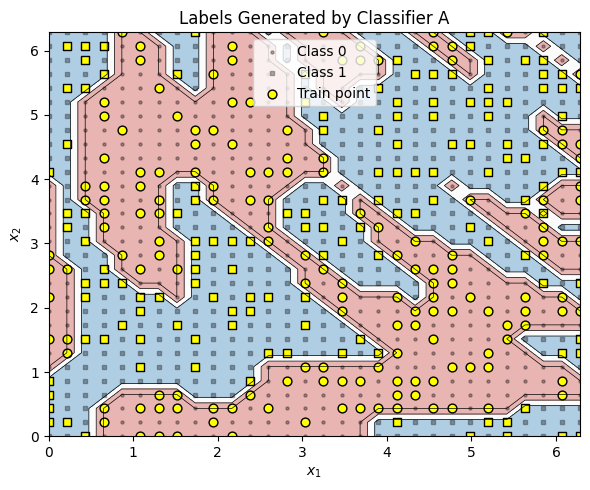

Training B(depth=1) on data from A(depth=2)
Total Accuracy: 0.48777777777777775
Train Accuracy: 0.4666666666666667
Test Accuracy: 0.49833333333333335
Test Precision: 0.5130111524163569
Test Recall: 0.44805194805194803
Test F1: 0.4783362218370884
Time taken: 155.79859685897827


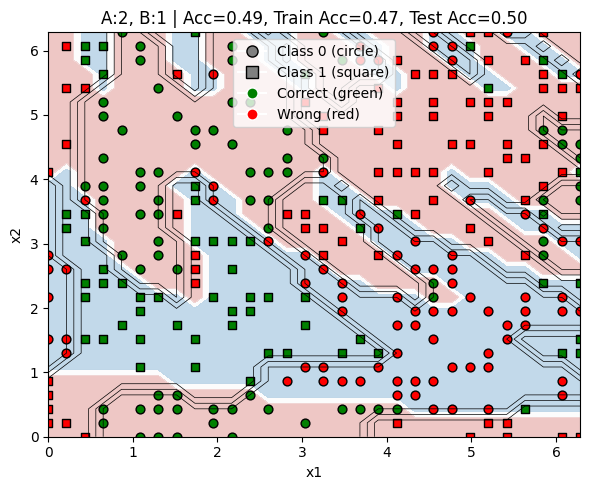

Training B(depth=2) on data from A(depth=2)
Total Accuracy: 0.5688888888888889
Train Accuracy: 0.55
Test Accuracy: 0.5783333333333334
Test Precision: 0.5971731448763251
Test Recall: 0.5487012987012987
Test F1: 0.571912013536379
Time taken: 247.72589683532715


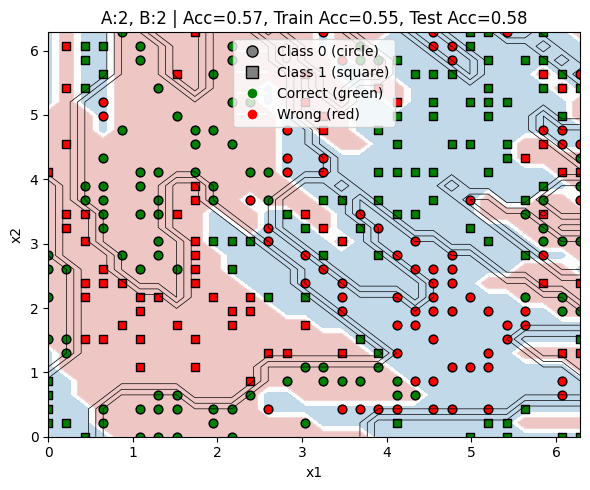

Training B(depth=3) on data from A(depth=2)
Total Accuracy: 0.6411111111111111
Train Accuracy: 0.61
Test Accuracy: 0.6566666666666666
Test Precision: 0.6666666666666666
Test Recall: 0.6623376623376623
Test F1: 0.6644951140065146
Time taken: 340.1792163848877


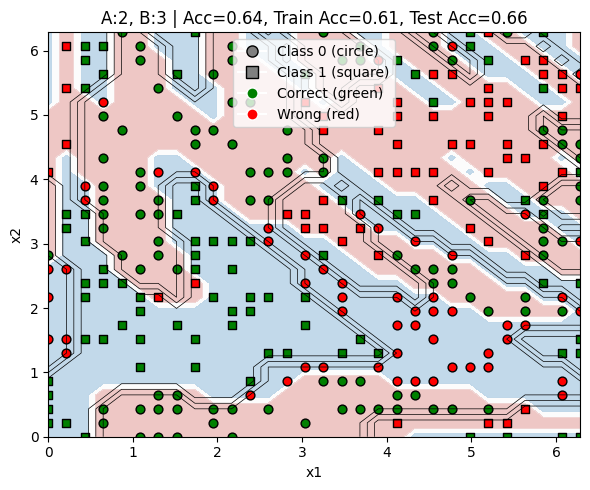

Training B(depth=4) on data from A(depth=2)
Total Accuracy: 0.6711111111111111
Train Accuracy: 0.68
Test Accuracy: 0.6666666666666666
Test Precision: 0.6928571428571428
Test Recall: 0.6298701298701299
Test F1: 0.6598639455782312
Time taken: 430.6087920665741


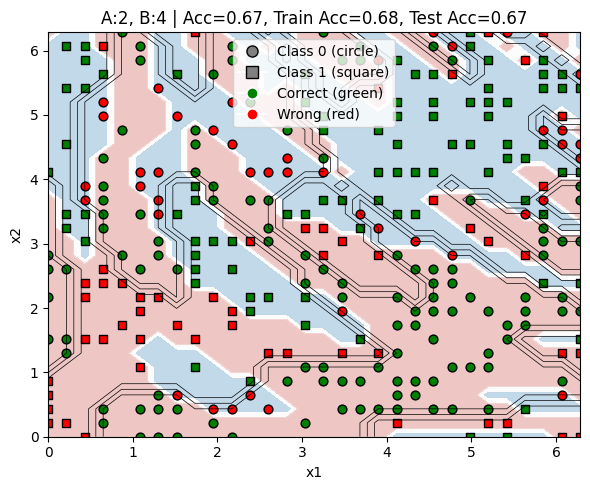

 50%|█████     | 2/4 [39:22<39:21, 1180.96s/it]

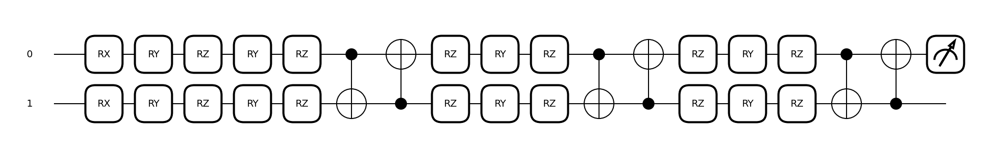

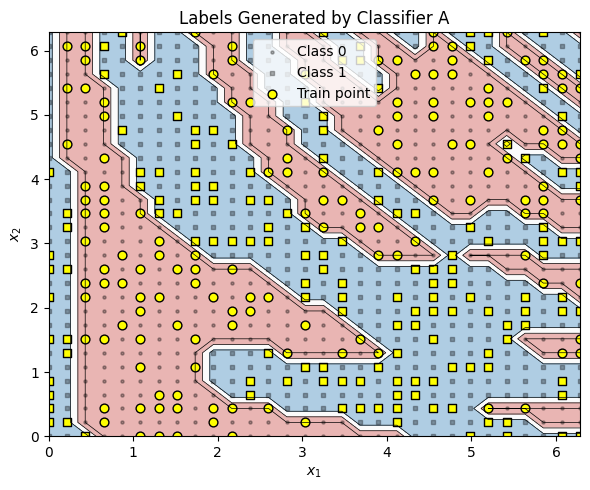

Training B(depth=1) on data from A(depth=3)
Total Accuracy: 0.4222222222222222
Train Accuracy: 0.42333333333333334
Test Accuracy: 0.4216666666666667
Test Precision: 0.4318181818181818
Test Recall: 0.4360655737704918
Test F1: 0.433931484502447
Time taken: 153.28555154800415


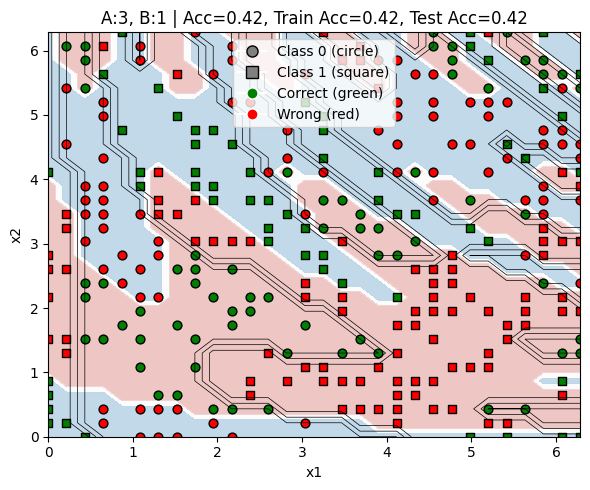

Training B(depth=2) on data from A(depth=3)
Total Accuracy: 0.6511111111111111
Train Accuracy: 0.6433333333333333
Test Accuracy: 0.655
Test Precision: 0.6644295302013423
Test Recall: 0.6491803278688525
Test F1: 0.6567164179104478
Time taken: 247.8416497707367


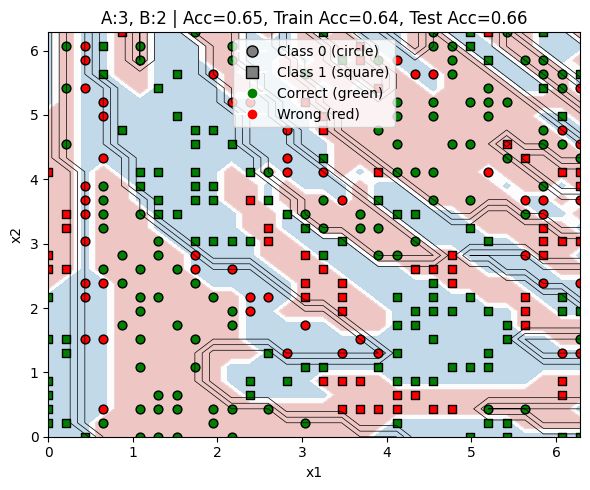

Training B(depth=3) on data from A(depth=3)
Total Accuracy: 0.7666666666666667
Train Accuracy: 0.7666666666666667
Test Accuracy: 0.7666666666666667
Test Precision: 0.7704918032786885
Test Recall: 0.7704918032786885
Test F1: 0.7704918032786885
Time taken: 341.28764963150024


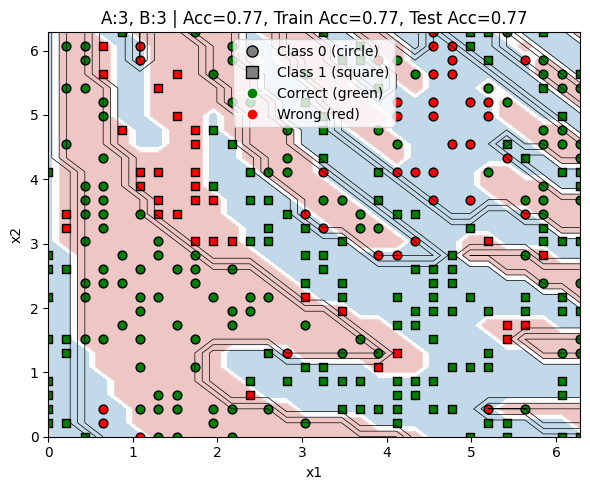

Training B(depth=4) on data from A(depth=3)
Total Accuracy: 0.6777777777777778
Train Accuracy: 0.6766666666666666
Test Accuracy: 0.6783333333333333
Test Precision: 0.6958041958041958
Test Recall: 0.6524590163934426
Test F1: 0.673434856175973
Time taken: 434.1721782684326


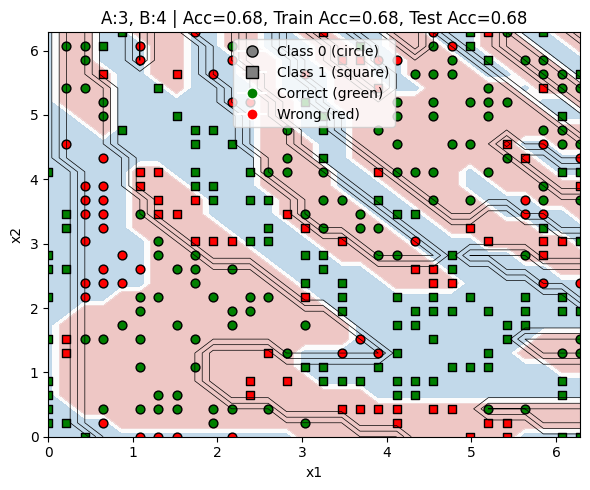

 75%|███████▌  | 3/4 [59:05<19:41, 1181.94s/it]

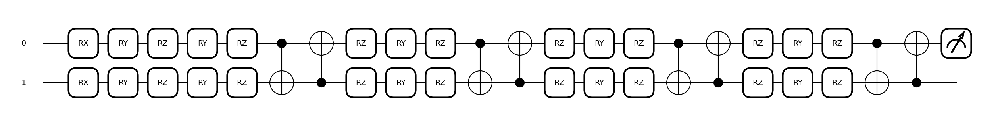

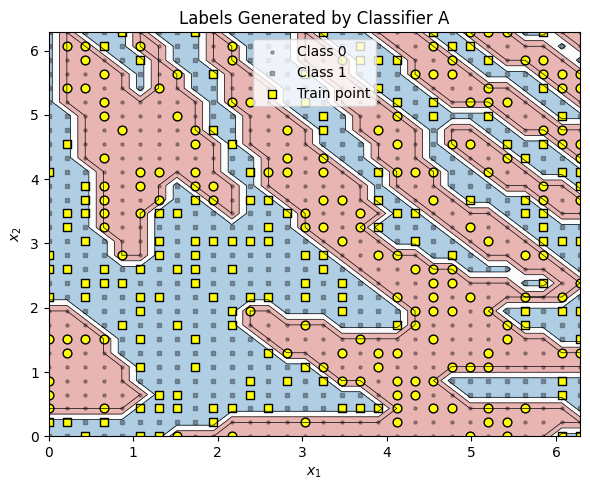

Training B(depth=1) on data from A(depth=4)
Total Accuracy: 0.6111111111111112
Train Accuracy: 0.6233333333333333
Test Accuracy: 0.605
Test Precision: 0.5927272727272728
Test Recall: 0.5659722222222222
Test F1: 0.5790408525754884
Time taken: 153.87124681472778


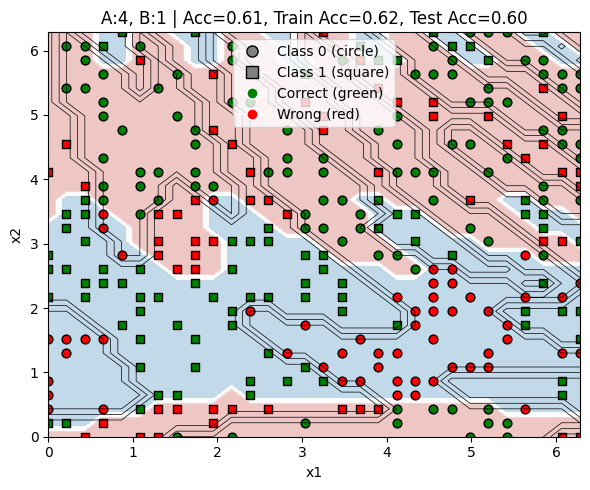

Training B(depth=2) on data from A(depth=4)
Total Accuracy: 0.5588888888888889
Train Accuracy: 0.6066666666666667
Test Accuracy: 0.535
Test Precision: 0.5144694533762058
Test Recall: 0.5555555555555556
Test F1: 0.5342237061769616
Time taken: 246.48799896240234


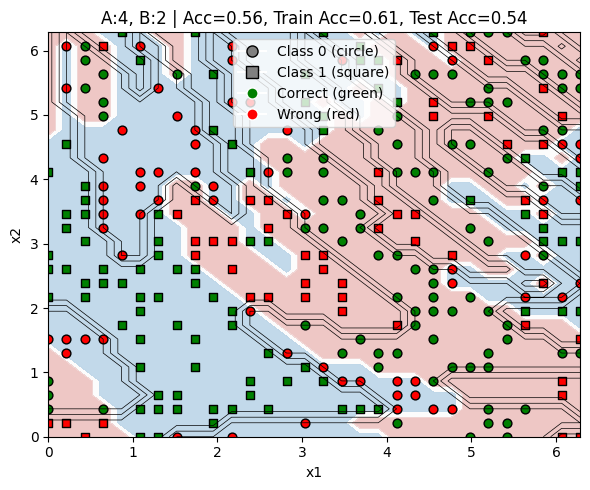

Training B(depth=3) on data from A(depth=4)
Total Accuracy: 0.5988888888888889
Train Accuracy: 0.5866666666666667
Test Accuracy: 0.605
Test Precision: 0.5814696485623003
Test Recall: 0.6319444444444444
Test F1: 0.6056572379367721
Time taken: 338.88766980171204


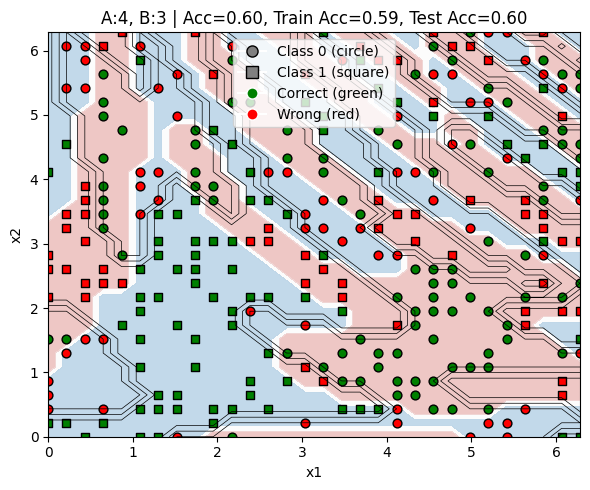

Training B(depth=4) on data from A(depth=4)
Total Accuracy: 0.6744444444444444
Train Accuracy: 0.6666666666666666
Test Accuracy: 0.6783333333333333
Test Precision: 0.6666666666666666
Test Recall: 0.6597222222222222
Test F1: 0.6631762652705061
Time taken: 431.69175028800964


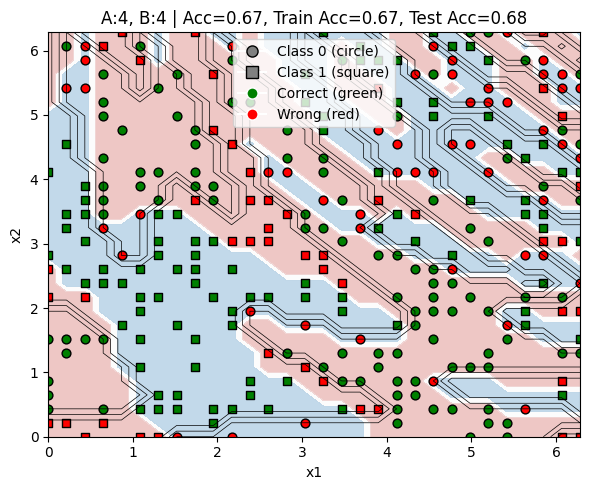

100%|██████████| 4/4 [1:18:43<00:00, 1180.94s/it]


In [30]:

for depth_A in tqdm(depths):
    # Generate labels using fixed A
    devA = qml.device("default.qubit", wires=n_qubits)
    weights_A = np.random.uniform(0, 2*np.pi, size=(depth_A, n_qubits, 3))
    circuit_A = create_qnode(depth_A, weights_A, devA)
    labels_A = generate_labels(circuit_A, inputs)
    y_train = torch.tensor(labels_A[train_idx], dtype=torch.float32).unsqueeze(1)
    y_test = torch.tensor(labels_A[test_idx], dtype=torch.float32).unsqueeze(1)
    qml.drawer.draw_mpl(circuit_A)([0, 1]);
    plot_generator_A(labels_A, "Labels Generated by Classifier A", X=inputs, train_idx=train_idx)
    
    for depth_B in tqdm(depths):
        print(f"Training B(depth={depth_B}) on data from A(depth={depth_A})")
        devB = qml.device("default.qubit", wires=n_qubits)
        model_B = get_torch_model(depth_B, devB)
        start_time = time.time()
        trained_model = train_model(model_B, X_train, y_train,epochs = 200, lr = 0.001)

        # Evaluate model
        with torch.no_grad():
            preds = torch.stack([trained_model(x) for x in torch.tensor(inputs, dtype=torch.float32)]).numpy().flatten()
            pred_labels = (preds > 0).astype(int)
            
        train_preds = pred_labels[train_idx]
        test_preds = pred_labels[test_idx]
        
        acc = accuracy_score(labels_A, pred_labels)
        train_acc = accuracy_score(labels_A[train_idx], train_preds)
        test_acc = accuracy_score(labels_A[test_idx], test_preds)
        precision = precision_score(labels_A[test_idx], test_preds)
        recall = recall_score(labels_A[test_idx], test_preds)
        f1 = f1_score(labels_A[test_idx], test_preds)
        # Plot
        title = f"A:{depth_A}, B:{depth_B} | Acc={acc:.2f}, Train Acc={train_acc:.2f}, Test Acc={test_acc:.2f}"
        print("Total Accuracy:", acc)
        print("Train Accuracy:", train_acc)
        print("Test Accuracy:", test_acc)
        print("Test Precision:", precision)
        print("Test Recall:", recall)
        print("Test F1:", f1)
        print("Time taken:", time.time() - start_time)
        results.append((depth_A, depth_B, acc, train_acc, test_acc))
        plot_results(labels_A, pred_labels, title, inputs, train_idx)
        




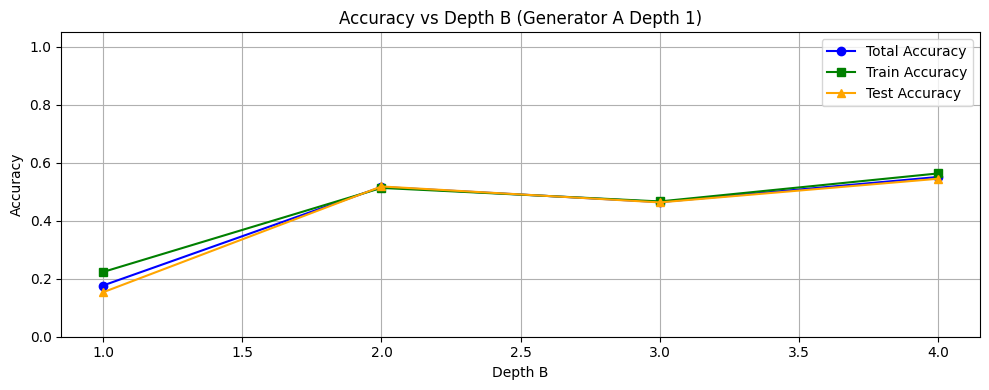

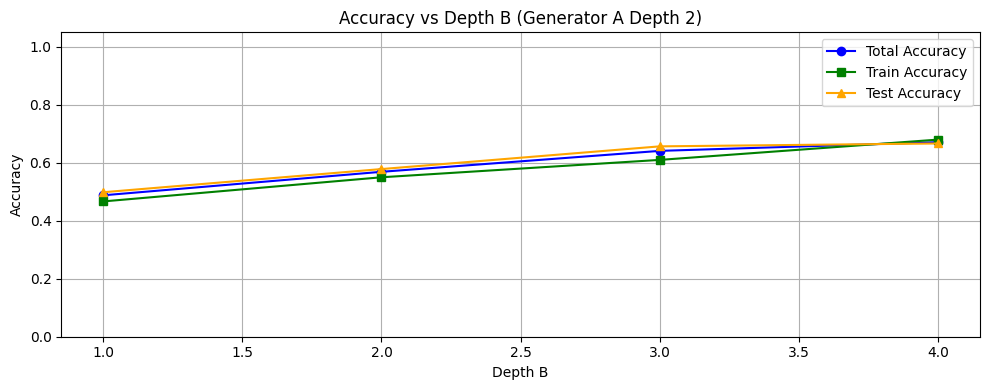

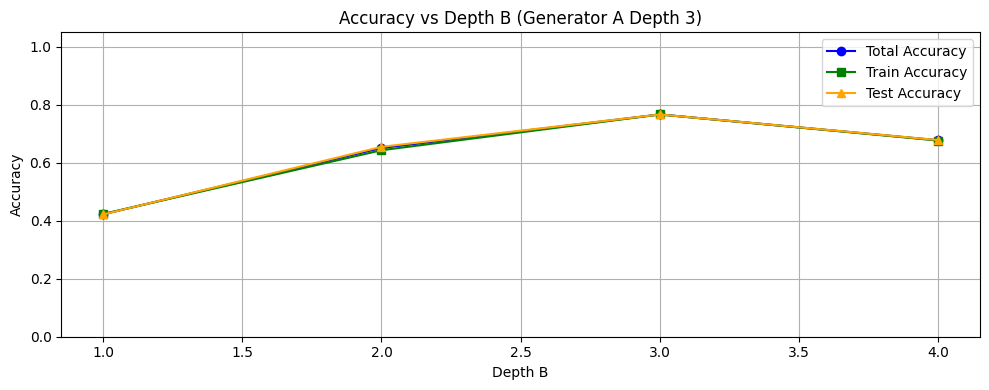

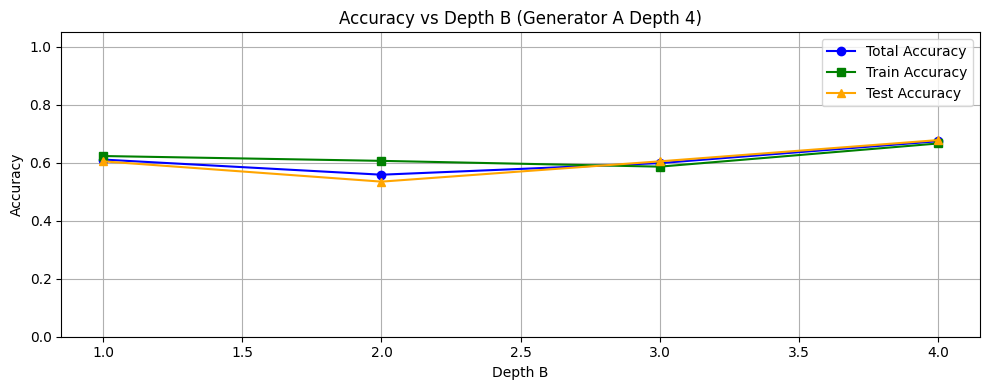

In [31]:

# Convert results to a DataFrame for easier filtering
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


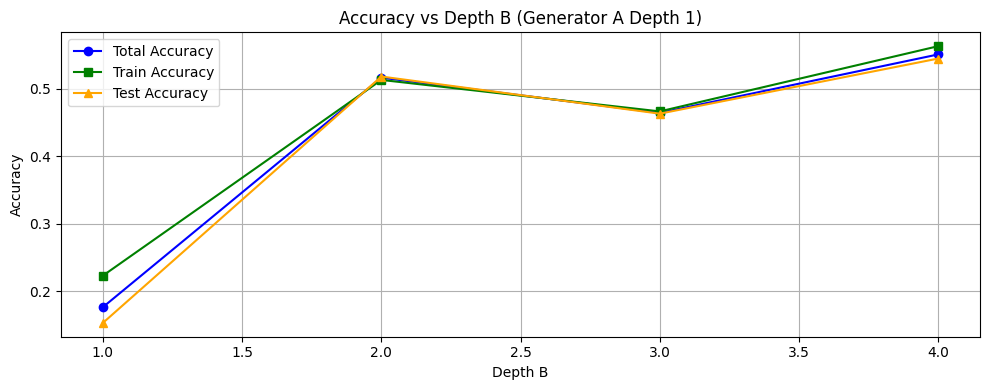

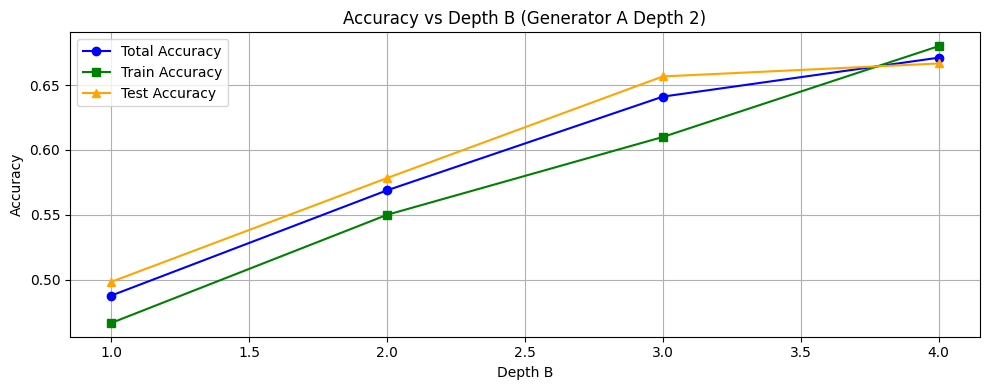

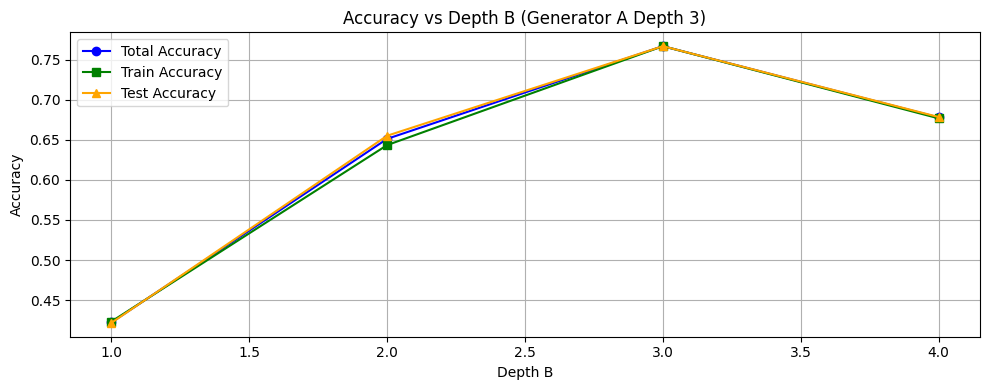

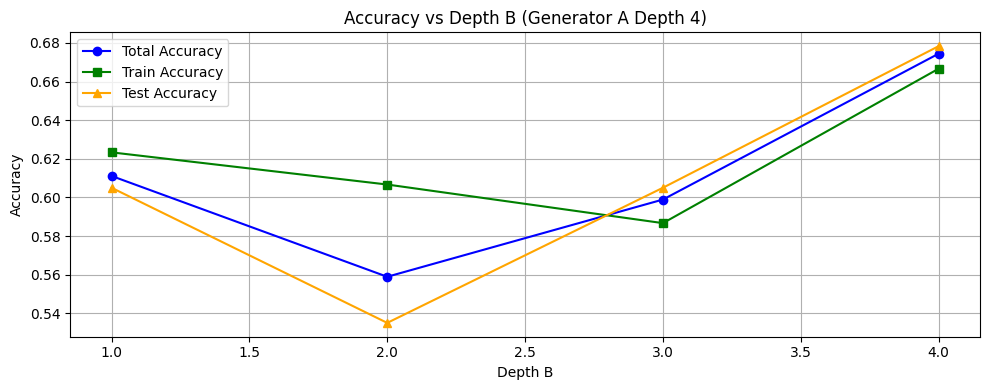

In [32]:
df_results = pd.DataFrame(results, columns=["depth_A", "depth_B", "total_acc", "train_acc", "test_acc"])

# Plot for each depth_A
for depth_A in df_results["depth_A"].unique():
    subset = df_results[df_results["depth_A"] == depth_A]

    plt.figure(figsize=(10, 4))

     # Accuracy plot
    plt.plot(subset["depth_B"], subset["total_acc"], marker='o', label="Total Accuracy", color='blue')
    plt.plot(subset["depth_B"], subset["train_acc"], marker='s', label="Train Accuracy", color='green')
    plt.plot(subset["depth_B"], subset["test_acc"], marker='^', label="Test Accuracy", color='orange')

    plt.title(f"Accuracy vs Depth B (Generator A Depth {depth_A})")
    plt.xlabel("Depth B")
    plt.ylabel("Accuracy")
    # plt.ylim(0, 1.05)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

In [33]:
print("Done")

Done
